<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_Brightness_7_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/MyDrive/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(7):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 37.9155 - IoU: 0.0508
Epoch 1: val_loss improved from inf to 75.05627, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 46ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


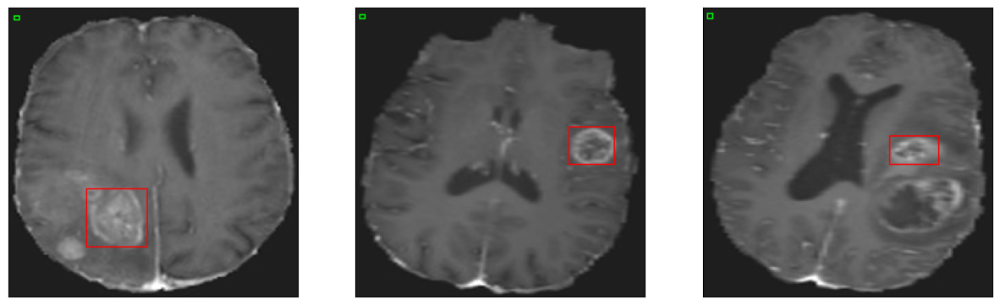

26/26 [==============================] - 22s 243ms/step - loss: 37.9155 - IoU: 0.0508 - val_loss: 75.0563 - val_IoU: 0.0000e+00
Epoch 2/200
25/26 [===========================>..] - ETA: 0s - loss: 23.4159 - IoU: 0.0948
Epoch 2: val_loss improved from 75.05627 to 65.82447, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


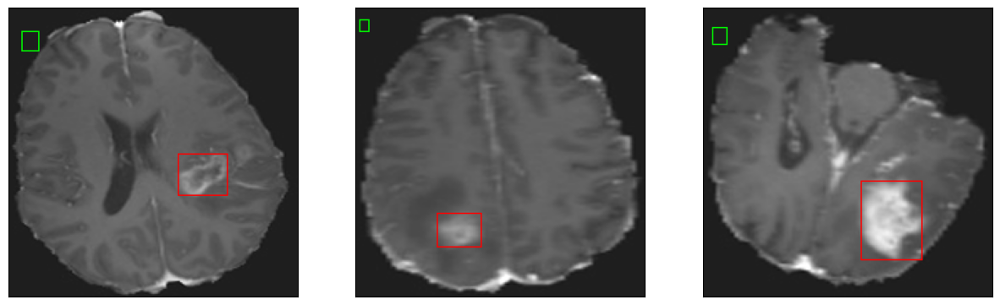

26/26 [==============================] - 3s 101ms/step - loss: 23.3723 - IoU: 0.0971 - val_loss: 65.8245 - val_IoU: 0.0000e+00
Epoch 3/200
25/26 [===========================>..] - ETA: 0s - loss: 18.2379 - IoU: 0.2090
Epoch 3: val_loss improved from 65.82447 to 56.02668, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


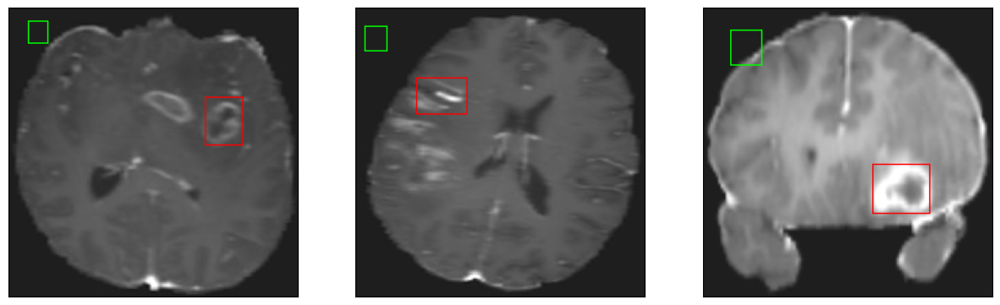

26/26 [==============================] - 3s 130ms/step - loss: 18.1599 - IoU: 0.2112 - val_loss: 56.0267 - val_IoU: 0.0000e+00
Epoch 4/200
25/26 [===========================>..] - ETA: 0s - loss: 15.2385 - IoU: 0.2639
Epoch 4: val_loss improved from 56.02668 to 48.40297, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


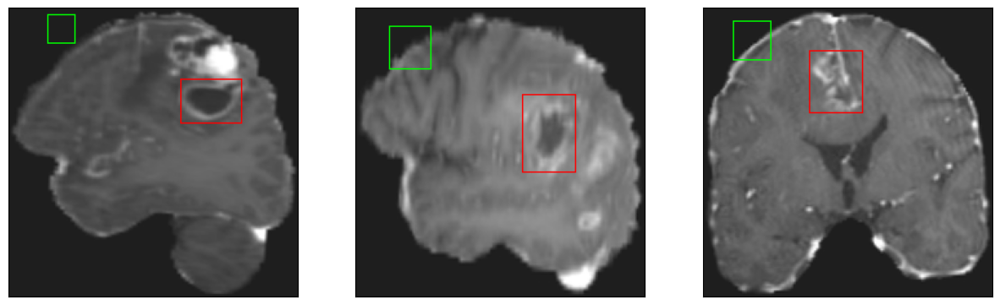

26/26 [==============================] - 4s 164ms/step - loss: 15.2760 - IoU: 0.2626 - val_loss: 48.4030 - val_IoU: 9.1406e-05
Epoch 5/200
25/26 [===========================>..] - ETA: 0s - loss: 13.5066 - IoU: 0.3152
Epoch 5: val_loss improved from 48.40297 to 44.37531, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


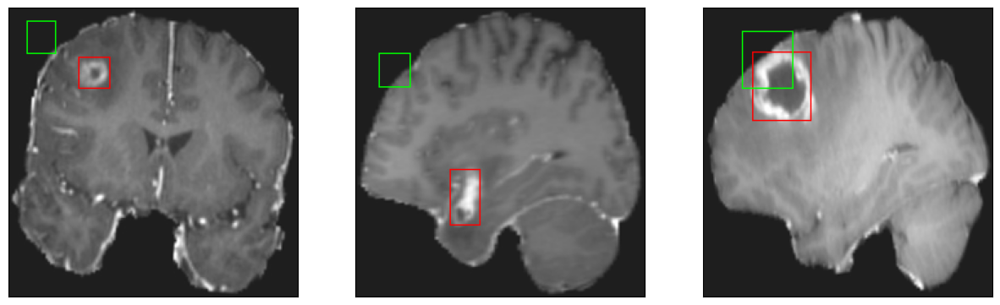

26/26 [==============================] - 3s 106ms/step - loss: 13.4675 - IoU: 0.3168 - val_loss: 44.3753 - val_IoU: 0.0030
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 12.6672 - IoU: 0.3446
Epoch 6: val_loss improved from 44.37531 to 44.22864, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


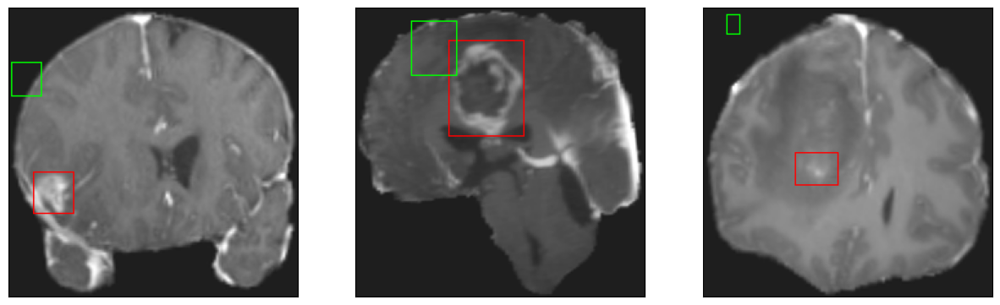

26/26 [==============================] - 3s 99ms/step - loss: 12.6672 - IoU: 0.3446 - val_loss: 44.2286 - val_IoU: 9.8401e-04
Epoch 7/200
25/26 [===========================>..] - ETA: 0s - loss: 11.9472 - IoU: 0.3480
Epoch 7: val_loss improved from 44.22864 to 40.42698, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


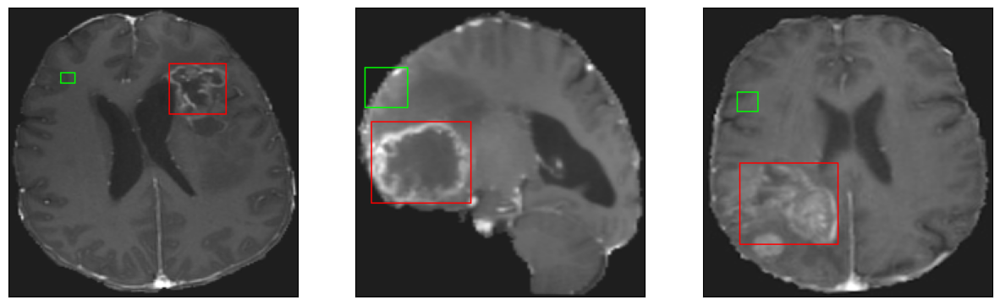

26/26 [==============================] - 3s 115ms/step - loss: 11.9076 - IoU: 0.3490 - val_loss: 40.4270 - val_IoU: 0.0020
Epoch 8/200
25/26 [===========================>..] - ETA: 0s - loss: 10.9565 - IoU: 0.3762
Epoch 8: val_loss did not improve from 40.42698
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


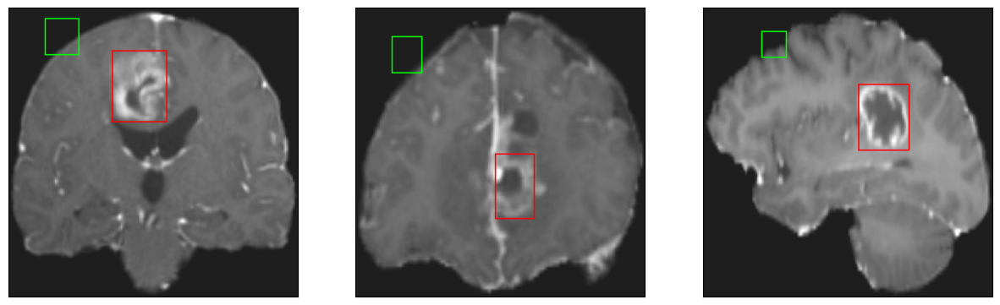

26/26 [==============================] - 3s 101ms/step - loss: 10.9781 - IoU: 0.3754 - val_loss: 45.1624 - val_IoU: 0.0011
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 10.6955 - IoU: 0.3911
Epoch 9: val_loss improved from 40.42698 to 38.03181, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


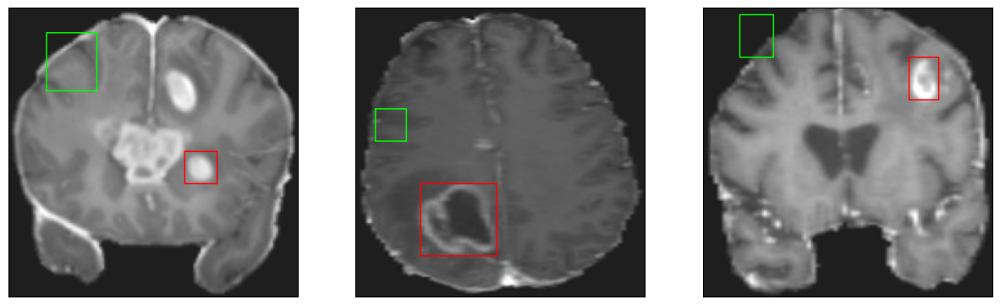

26/26 [==============================] - 3s 104ms/step - loss: 10.6955 - IoU: 0.3911 - val_loss: 38.0318 - val_IoU: 0.0068
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 10.2865 - IoU: 0.4031
Epoch 10: val_loss did not improve from 38.03181
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


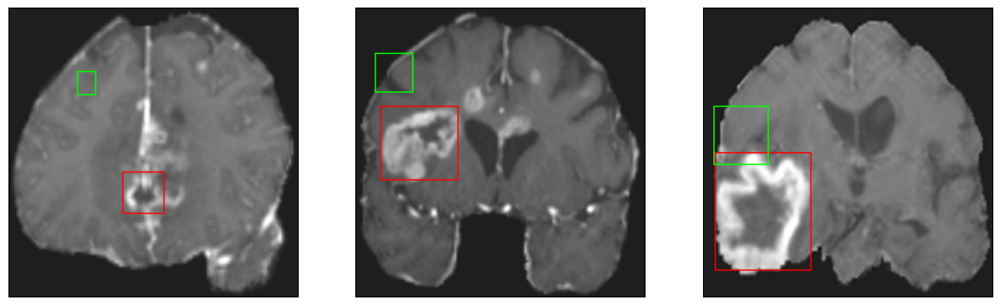

26/26 [==============================] - 3s 106ms/step - loss: 10.2865 - IoU: 0.4031 - val_loss: 42.9064 - val_IoU: 0.0019
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 9.7885 - IoU: 0.4100
Epoch 11: val_loss improved from 38.03181 to 35.51307, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


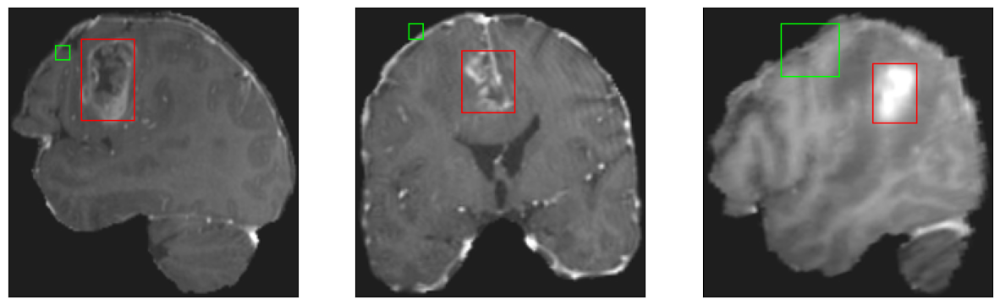

26/26 [==============================] - 3s 130ms/step - loss: 9.7885 - IoU: 0.4100 - val_loss: 35.5131 - val_IoU: 0.0142
Epoch 12/200
25/26 [===========================>..] - ETA: 0s - loss: 9.6417 - IoU: 0.4182
Epoch 12: val_loss did not improve from 35.51307
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


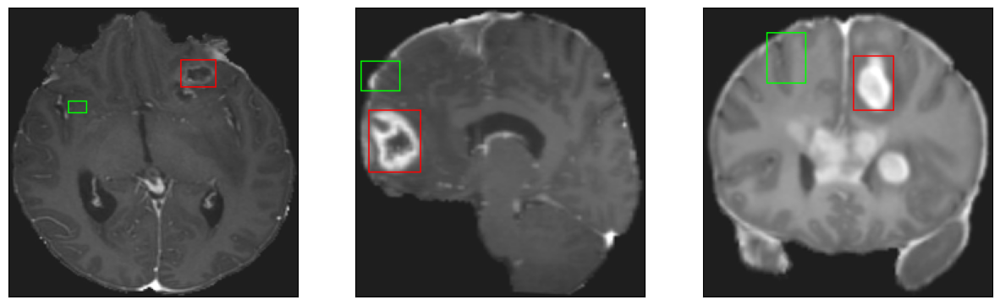

26/26 [==============================] - 3s 100ms/step - loss: 9.5545 - IoU: 0.4196 - val_loss: 37.7143 - val_IoU: 0.0106
Epoch 13/200
25/26 [===========================>..] - ETA: 0s - loss: 9.5178 - IoU: 0.4292
Epoch 13: val_loss improved from 35.51307 to 30.40521, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


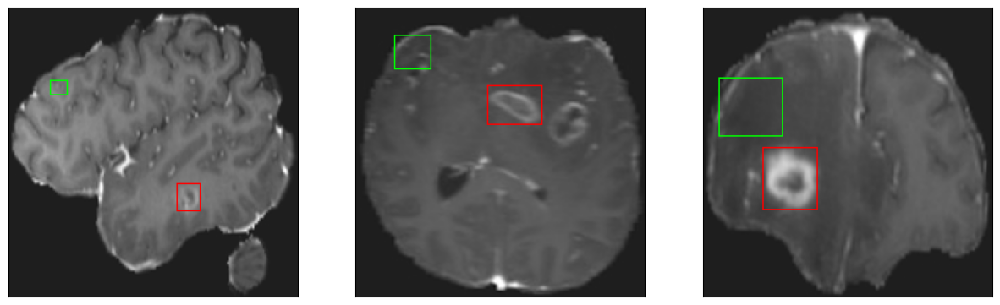

26/26 [==============================] - 4s 159ms/step - loss: 9.4800 - IoU: 0.4293 - val_loss: 30.4052 - val_IoU: 0.0292
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 9.1205 - IoU: 0.4451
Epoch 14: val_loss did not improve from 30.40521
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


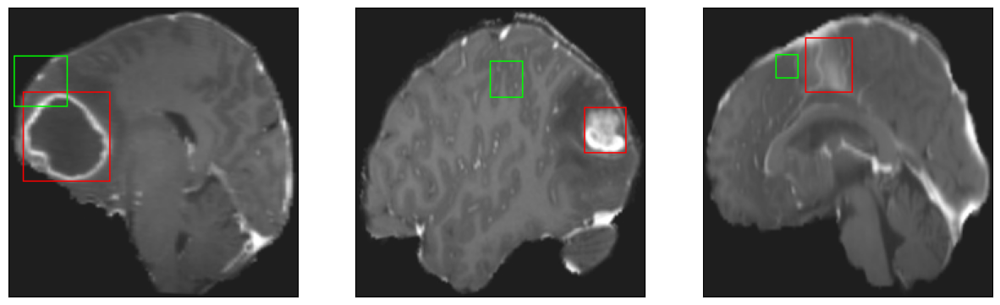

26/26 [==============================] - 4s 135ms/step - loss: 9.1205 - IoU: 0.4451 - val_loss: 37.3783 - val_IoU: 0.0063
Epoch 15/200
25/26 [===========================>..] - ETA: 0s - loss: 8.6784 - IoU: 0.4502
Epoch 15: val_loss did not improve from 30.40521
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


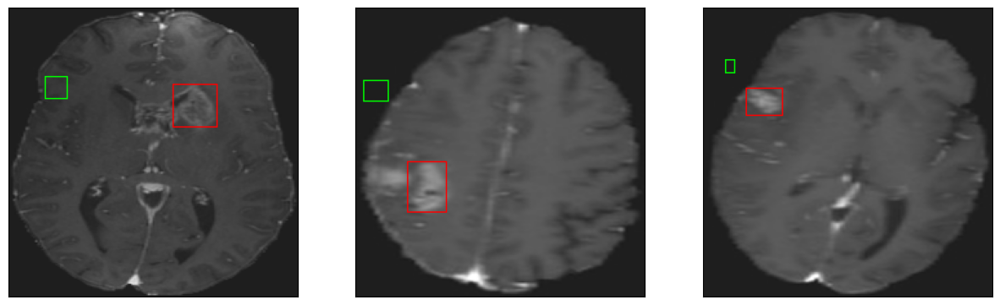

26/26 [==============================] - 3s 116ms/step - loss: 8.7313 - IoU: 0.4485 - val_loss: 35.8043 - val_IoU: 0.0134
Epoch 16/200
25/26 [===========================>..] - ETA: 0s - loss: 8.2895 - IoU: 0.4650
Epoch 16: val_loss did not improve from 30.40521
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4


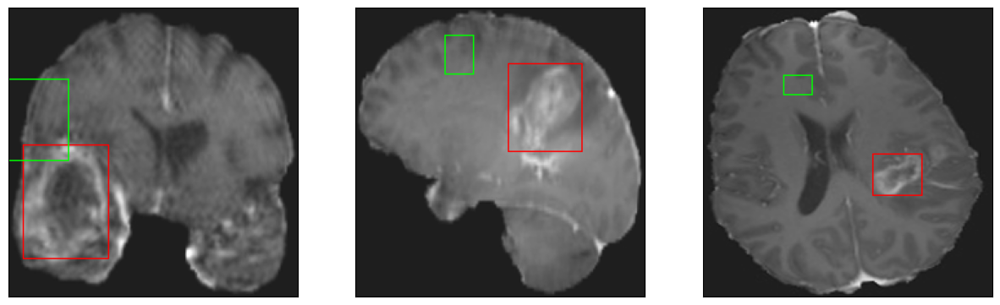

26/26 [==============================] - 3s 99ms/step - loss: 8.3796 - IoU: 0.4622 - val_loss: 33.2276 - val_IoU: 0.0187
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 8.6446 - IoU: 0.4559
Epoch 17: val_loss improved from 30.40521 to 28.14149, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


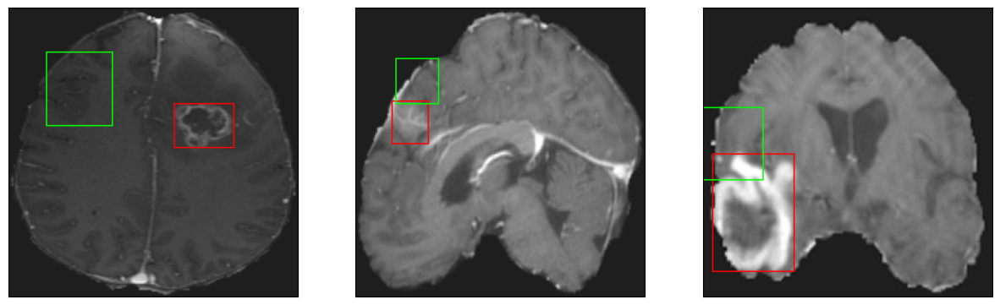

26/26 [==============================] - 4s 153ms/step - loss: 8.6446 - IoU: 0.4559 - val_loss: 28.1415 - val_IoU: 0.0347
Epoch 18/200
25/26 [===========================>..] - ETA: 0s - loss: 8.0350 - IoU: 0.4853
Epoch 18: val_loss did not improve from 28.14149
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 9ms/step
4


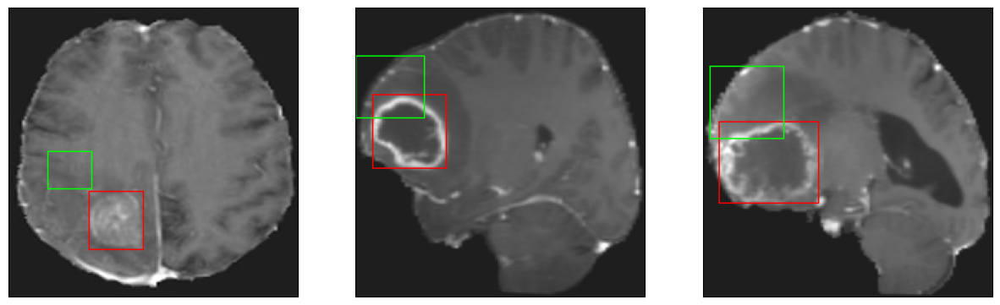

26/26 [==============================] - 3s 122ms/step - loss: 8.0957 - IoU: 0.4829 - val_loss: 28.7992 - val_IoU: 0.0447
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 8.2112 - IoU: 0.4756
Epoch 19: val_loss improved from 28.14149 to 23.82501, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


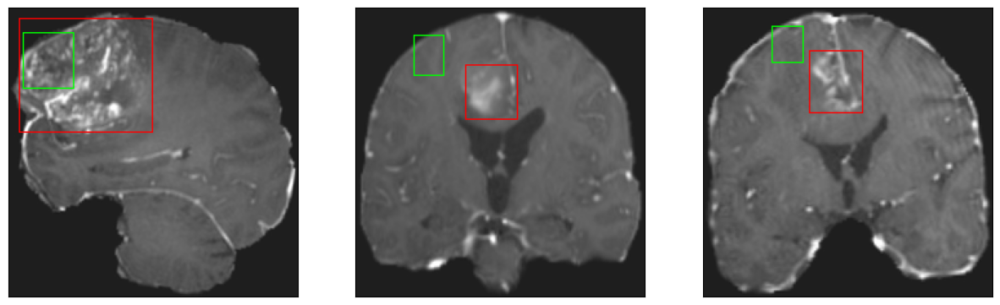

26/26 [==============================] - 3s 109ms/step - loss: 8.2112 - IoU: 0.4756 - val_loss: 23.8250 - val_IoU: 0.0646
Epoch 20/200
25/26 [===========================>..] - ETA: 0s - loss: 7.8714 - IoU: 0.4923
Epoch 20: val_loss improved from 23.82501 to 22.68663, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


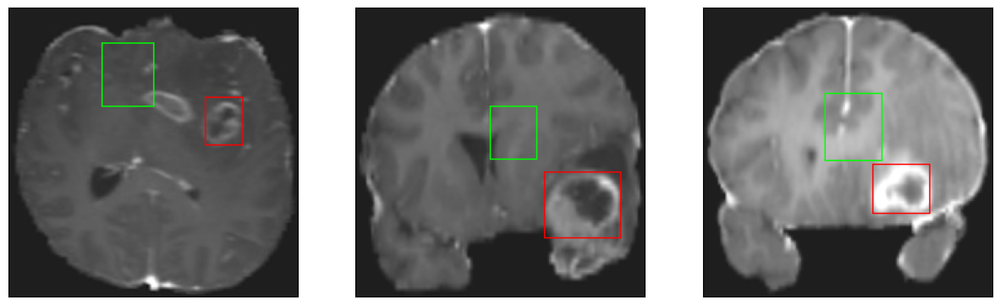

26/26 [==============================] - 3s 123ms/step - loss: 7.7914 - IoU: 0.4953 - val_loss: 22.6866 - val_IoU: 0.0749
Epoch 21/200
25/26 [===========================>..] - ETA: 0s - loss: 7.8538 - IoU: 0.4819
Epoch 21: val_loss improved from 22.68663 to 22.53812, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


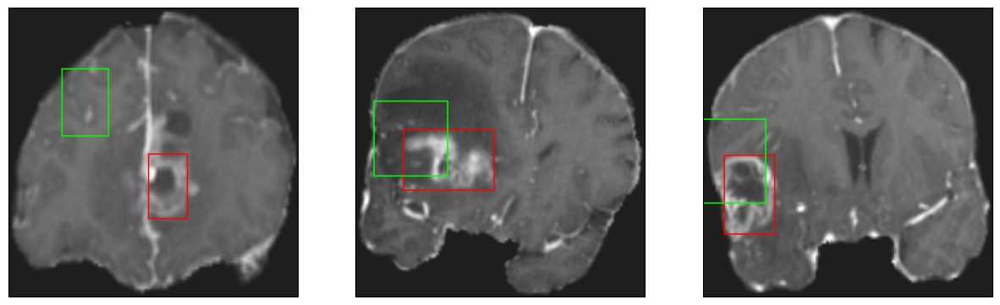

26/26 [==============================] - 3s 114ms/step - loss: 7.8916 - IoU: 0.4789 - val_loss: 22.5381 - val_IoU: 0.0991
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 7.7985 - IoU: 0.4814
Epoch 22: val_loss did not improve from 22.53812
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


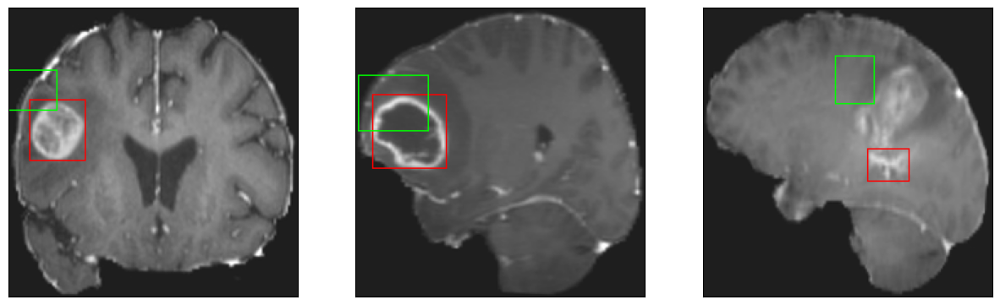

26/26 [==============================] - 3s 111ms/step - loss: 7.7985 - IoU: 0.4814 - val_loss: 22.7579 - val_IoU: 0.0713
Epoch 23/200
25/26 [===========================>..] - ETA: 0s - loss: 7.1408 - IoU: 0.5176
Epoch 23: val_loss improved from 22.53812 to 16.07010, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


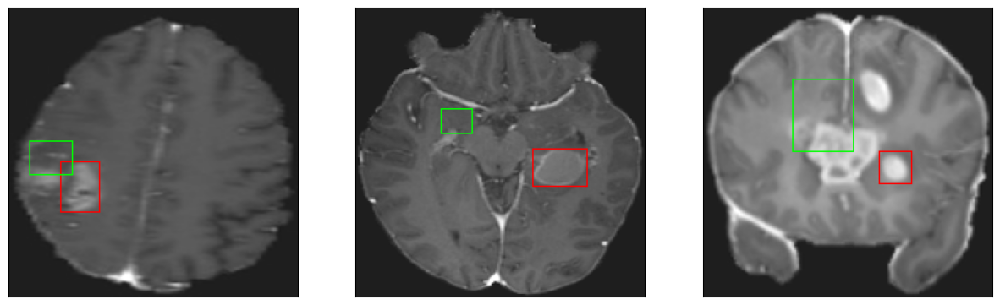

26/26 [==============================] - 3s 115ms/step - loss: 7.1596 - IoU: 0.5172 - val_loss: 16.0701 - val_IoU: 0.1796
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 7.4436 - IoU: 0.5026
Epoch 24: val_loss did not improve from 16.07010
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


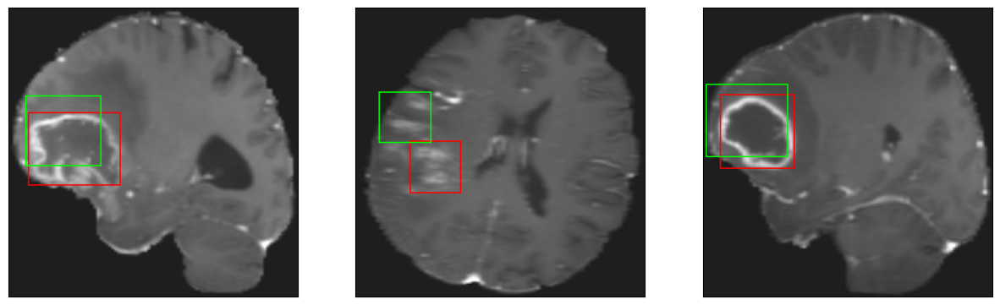

26/26 [==============================] - 4s 138ms/step - loss: 7.4436 - IoU: 0.5026 - val_loss: 17.0445 - val_IoU: 0.1746
Epoch 25/200
25/26 [===========================>..] - ETA: 0s - loss: 7.4403 - IoU: 0.4988
Epoch 25: val_loss improved from 16.07010 to 10.25944, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


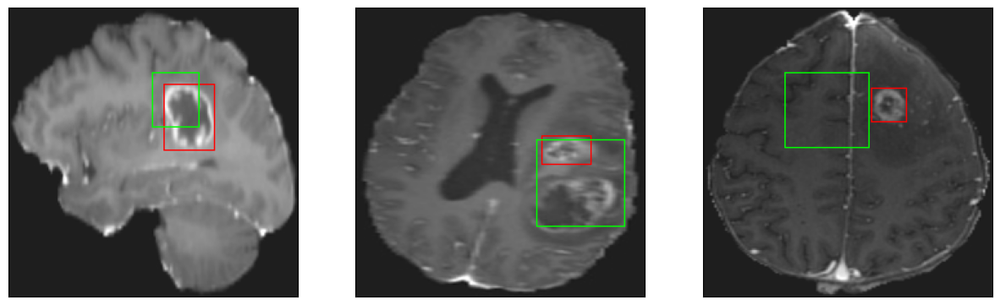

26/26 [==============================] - 3s 120ms/step - loss: 7.3650 - IoU: 0.5017 - val_loss: 10.2594 - val_IoU: 0.4246
Epoch 26/200
25/26 [===========================>..] - ETA: 0s - loss: 7.0351 - IoU: 0.5263
Epoch 26: val_loss did not improve from 10.25944
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


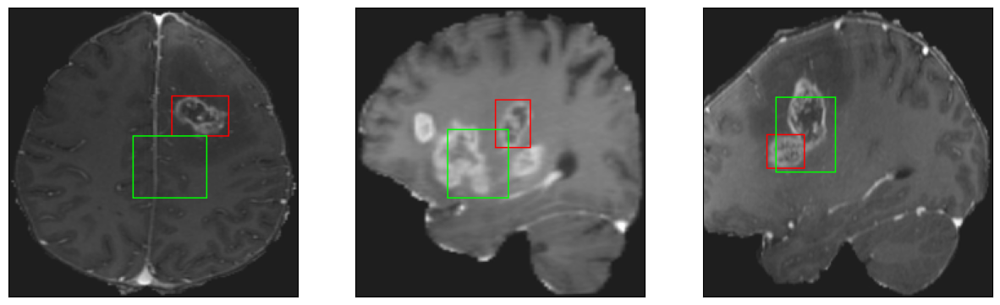

26/26 [==============================] - 3s 125ms/step - loss: 6.9898 - IoU: 0.5268 - val_loss: 17.0092 - val_IoU: 0.2066
Epoch 27/200
25/26 [===========================>..] - ETA: 0s - loss: 6.6661 - IoU: 0.5333
Epoch 27: val_loss improved from 10.25944 to 9.22222, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


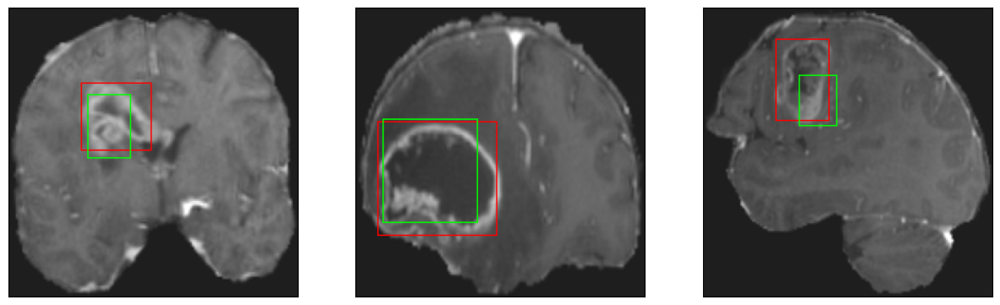

26/26 [==============================] - 3s 120ms/step - loss: 6.7636 - IoU: 0.5313 - val_loss: 9.2222 - val_IoU: 0.4819
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 6.8355 - IoU: 0.5230
Epoch 28: val_loss did not improve from 9.22222
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


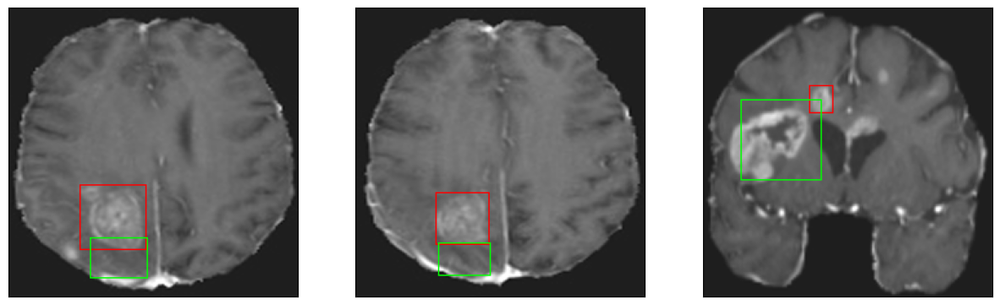

26/26 [==============================] - 3s 123ms/step - loss: 6.8355 - IoU: 0.5230 - val_loss: 11.2785 - val_IoU: 0.3836
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 6.8248 - IoU: 0.5272
Epoch 29: val_loss did not improve from 9.22222
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


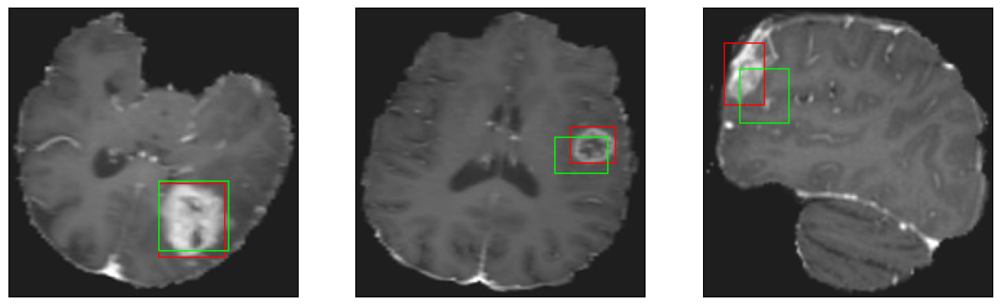

26/26 [==============================] - 4s 145ms/step - loss: 6.8248 - IoU: 0.5272 - val_loss: 10.2290 - val_IoU: 0.4543
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 7.1160 - IoU: 0.5103
Epoch 30: val_loss did not improve from 9.22222
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


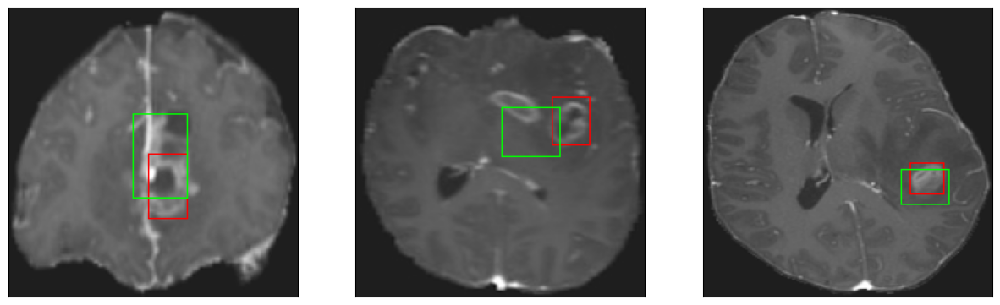

26/26 [==============================] - 3s 115ms/step - loss: 7.1160 - IoU: 0.5103 - val_loss: 12.7543 - val_IoU: 0.3702
Epoch 31/200
25/26 [===========================>..] - ETA: 0s - loss: 6.8388 - IoU: 0.5311
Epoch 31: val_loss improved from 9.22222 to 9.13289, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


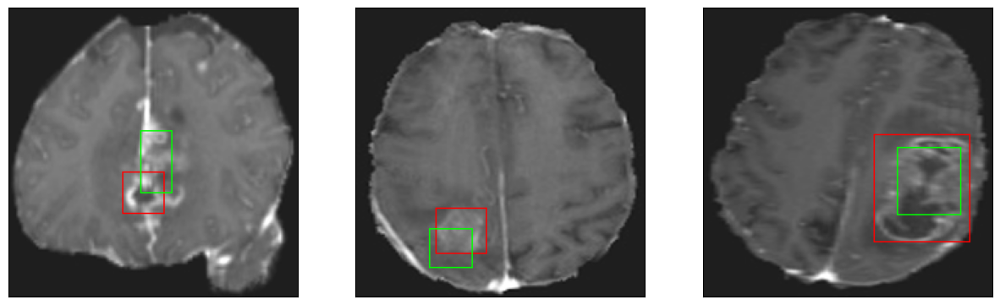

26/26 [==============================] - 4s 154ms/step - loss: 6.7828 - IoU: 0.5312 - val_loss: 9.1329 - val_IoU: 0.4707
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 6.9127 - IoU: 0.5246
Epoch 32: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


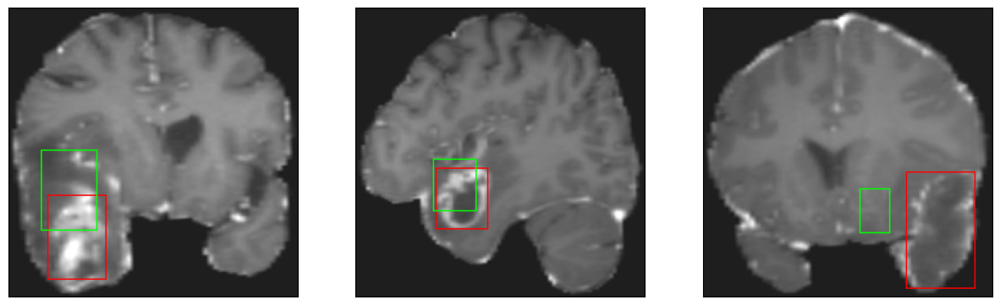

26/26 [==============================] - 4s 134ms/step - loss: 6.9127 - IoU: 0.5246 - val_loss: 9.4591 - val_IoU: 0.4742
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 6.7720 - IoU: 0.5143
Epoch 33: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


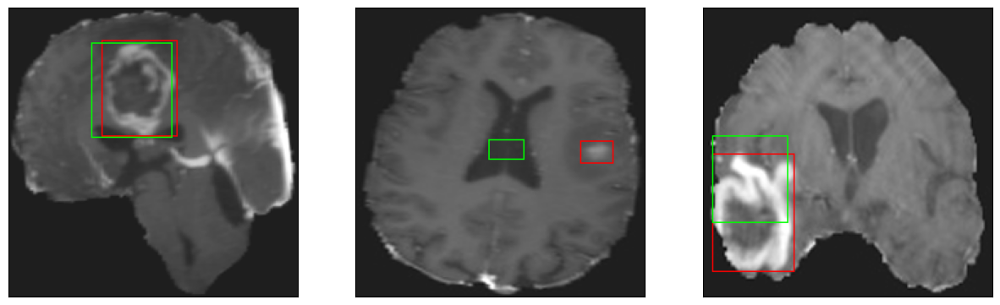

26/26 [==============================] - 3s 125ms/step - loss: 6.7720 - IoU: 0.5143 - val_loss: 12.4285 - val_IoU: 0.2946
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 6.5741 - IoU: 0.5392
Epoch 34: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


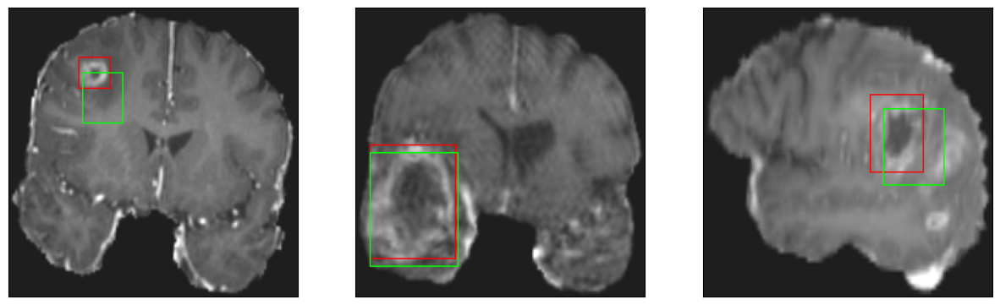

26/26 [==============================] - 3s 118ms/step - loss: 6.5741 - IoU: 0.5392 - val_loss: 10.5491 - val_IoU: 0.4555
Epoch 35/200
25/26 [===========================>..] - ETA: 0s - loss: 6.5077 - IoU: 0.5476
Epoch 35: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


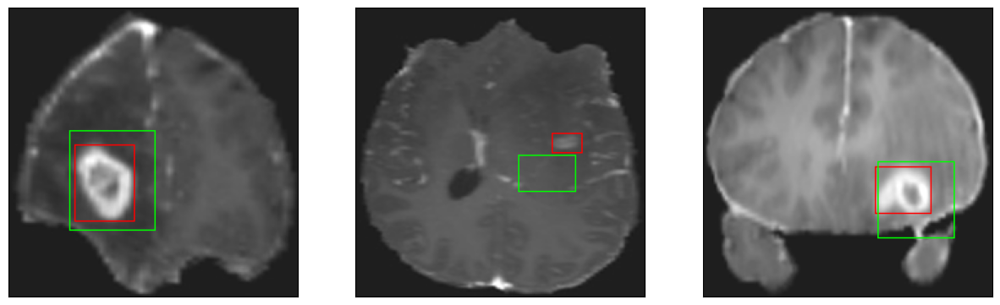

26/26 [==============================] - 3s 108ms/step - loss: 6.4771 - IoU: 0.5500 - val_loss: 9.7459 - val_IoU: 0.4816
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 6.3389 - IoU: 0.5563
Epoch 36: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


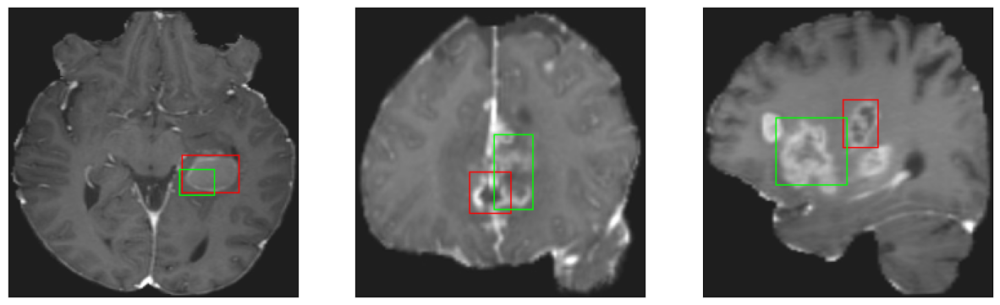

26/26 [==============================] - 3s 111ms/step - loss: 6.3389 - IoU: 0.5563 - val_loss: 9.5345 - val_IoU: 0.4729
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 6.3816 - IoU: 0.5507
Epoch 37: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


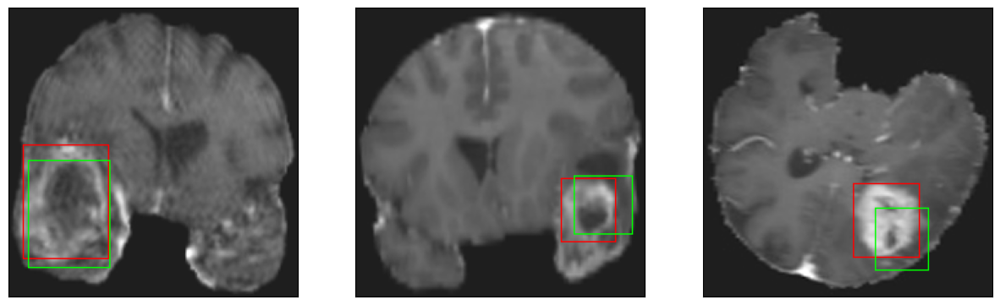

26/26 [==============================] - 3s 131ms/step - loss: 6.3816 - IoU: 0.5507 - val_loss: 10.3108 - val_IoU: 0.3941
Epoch 38/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1105 - IoU: 0.5625
Epoch 38: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


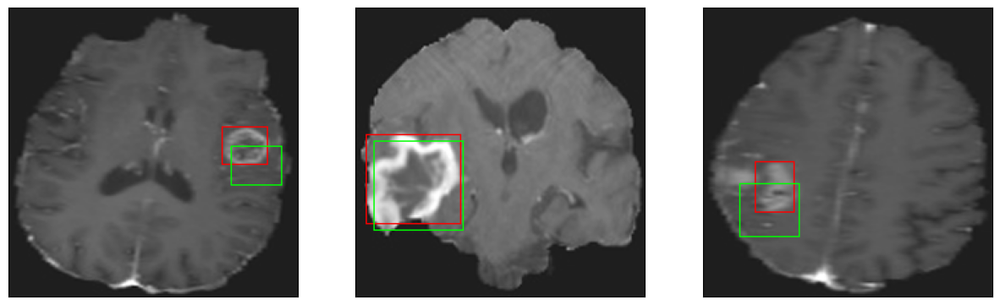

26/26 [==============================] - 3s 105ms/step - loss: 6.0545 - IoU: 0.5645 - val_loss: 10.2457 - val_IoU: 0.4031
Epoch 39/200
25/26 [===========================>..] - ETA: 0s - loss: 6.2290 - IoU: 0.5622
Epoch 39: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


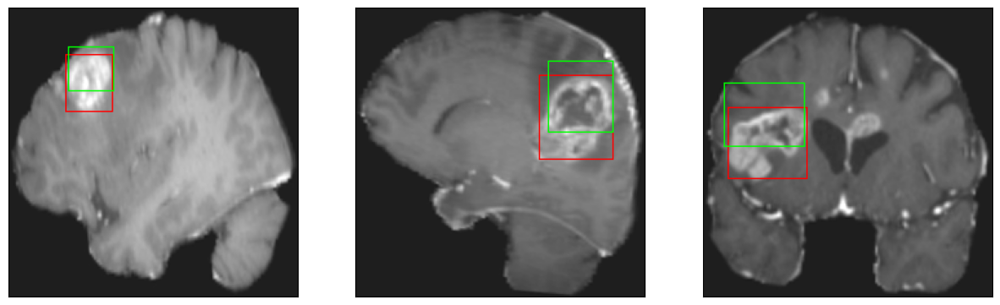

26/26 [==============================] - 3s 124ms/step - loss: 6.2172 - IoU: 0.5626 - val_loss: 9.4424 - val_IoU: 0.4539
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 6.5340 - IoU: 0.5370
Epoch 40: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


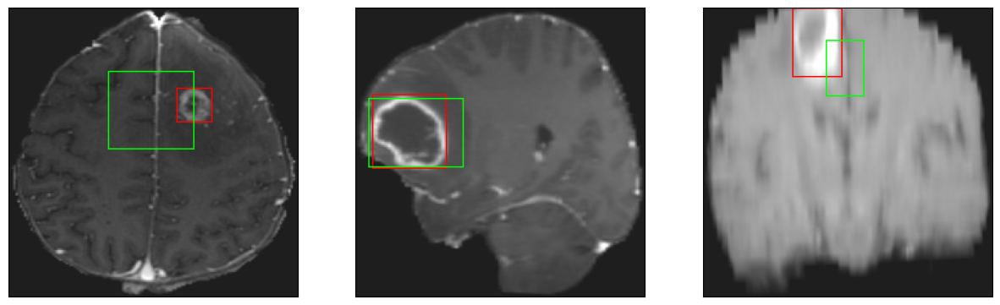

26/26 [==============================] - 3s 122ms/step - loss: 6.5340 - IoU: 0.5370 - val_loss: 10.1080 - val_IoU: 0.4472
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 6.6277 - IoU: 0.5251
Epoch 41: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


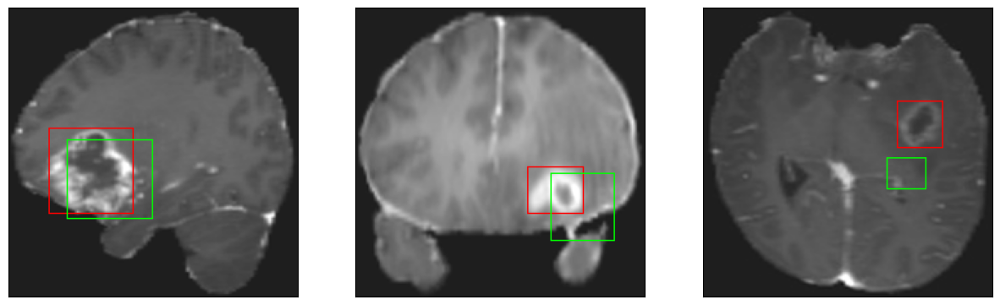

26/26 [==============================] - 4s 147ms/step - loss: 6.6277 - IoU: 0.5251 - val_loss: 11.9741 - val_IoU: 0.3090
Epoch 42/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4092 - IoU: 0.5368
Epoch 42: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


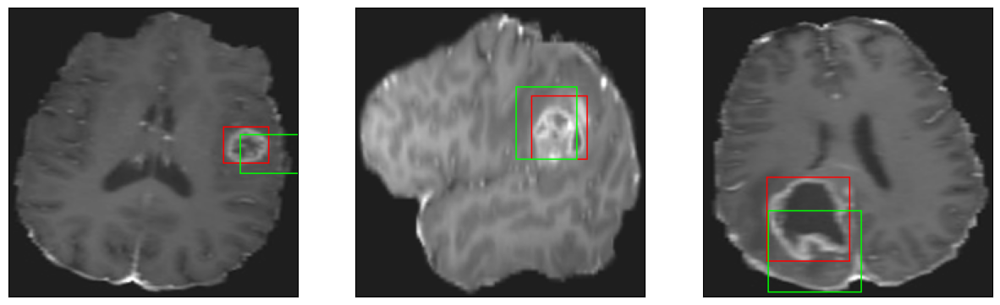

26/26 [==============================] - 3s 117ms/step - loss: 6.4744 - IoU: 0.5342 - val_loss: 10.0697 - val_IoU: 0.4514
Epoch 43/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4148 - IoU: 0.5376
Epoch 43: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


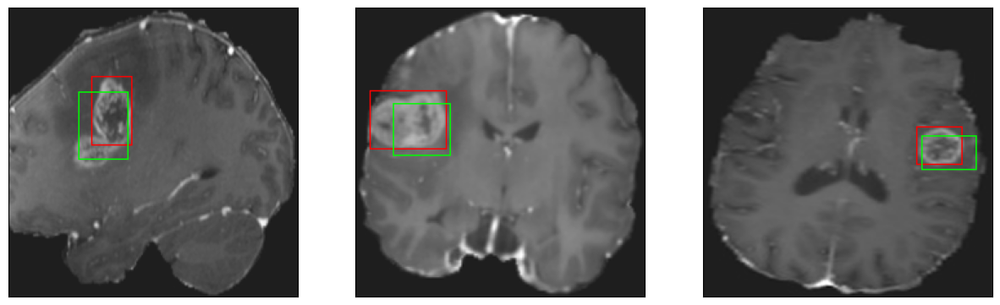

26/26 [==============================] - 3s 105ms/step - loss: 6.4674 - IoU: 0.5358 - val_loss: 9.5892 - val_IoU: 0.4408
Epoch 44/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3036 - IoU: 0.5494
Epoch 44: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


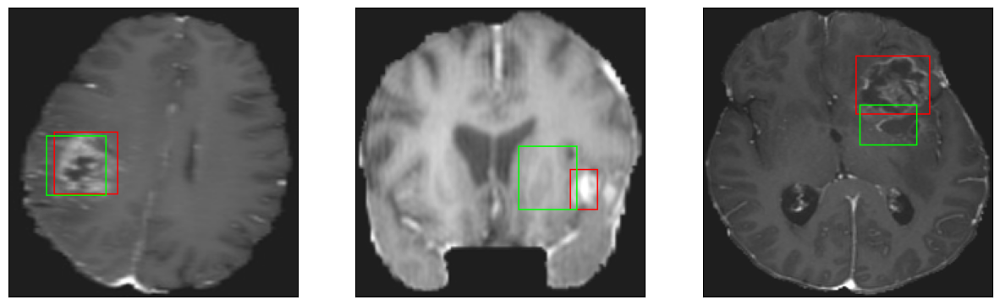

26/26 [==============================] - 4s 137ms/step - loss: 6.2871 - IoU: 0.5509 - val_loss: 9.6315 - val_IoU: 0.4684
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 6.0910 - IoU: 0.5537
Epoch 45: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 21ms/step
4


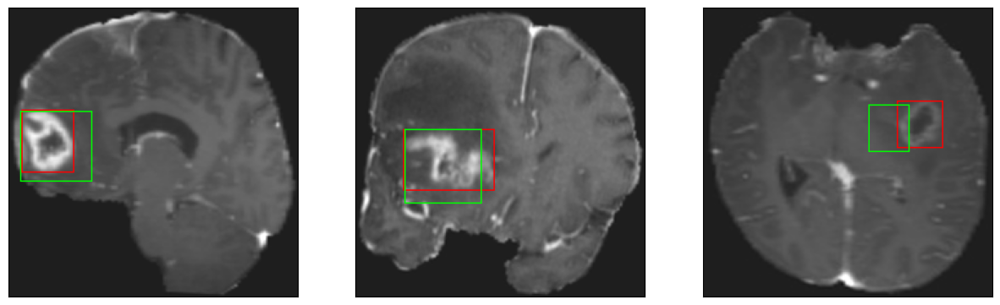

26/26 [==============================] - 5s 196ms/step - loss: 6.0910 - IoU: 0.5537 - val_loss: 9.7964 - val_IoU: 0.4554
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 5.8966 - IoU: 0.5730
Epoch 46: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


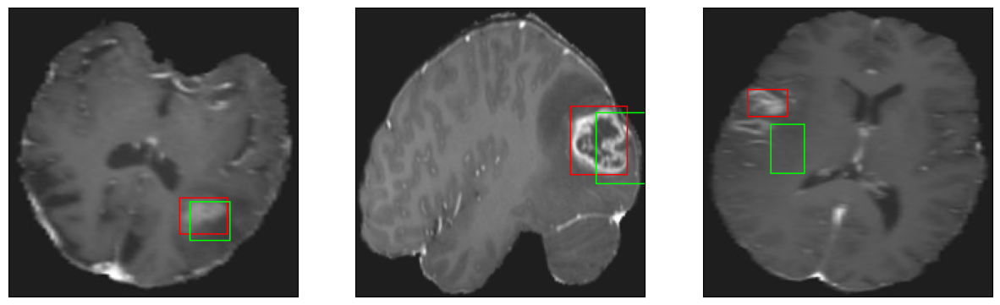

26/26 [==============================] - 4s 166ms/step - loss: 5.8966 - IoU: 0.5730 - val_loss: 12.0554 - val_IoU: 0.3252
Epoch 47/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0456 - IoU: 0.5618
Epoch 47: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


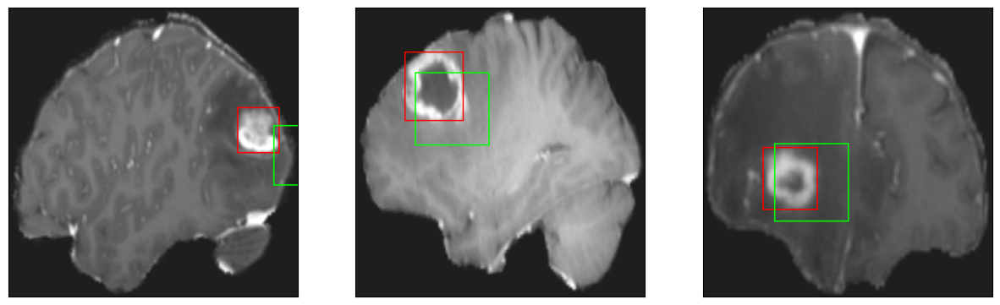

26/26 [==============================] - 3s 132ms/step - loss: 6.0325 - IoU: 0.5620 - val_loss: 17.9775 - val_IoU: 0.1804
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 5.8080 - IoU: 0.5764
Epoch 48: val_loss did not improve from 9.13289
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


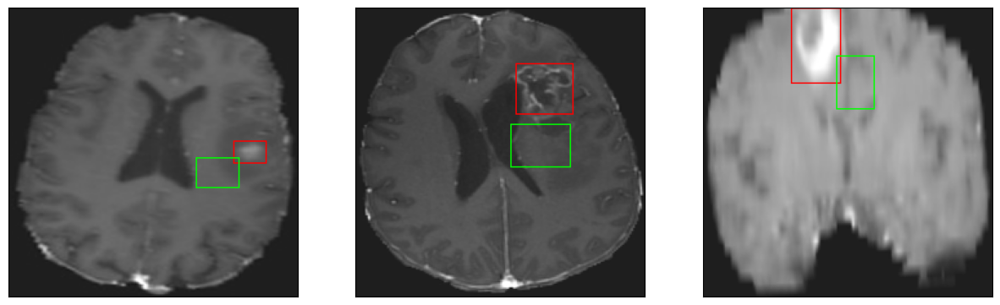

26/26 [==============================] - 3s 123ms/step - loss: 5.8080 - IoU: 0.5764 - val_loss: 11.2710 - val_IoU: 0.3602
Epoch 49/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4945 - IoU: 0.5941
Epoch 49: val_loss improved from 9.13289 to 8.94042, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


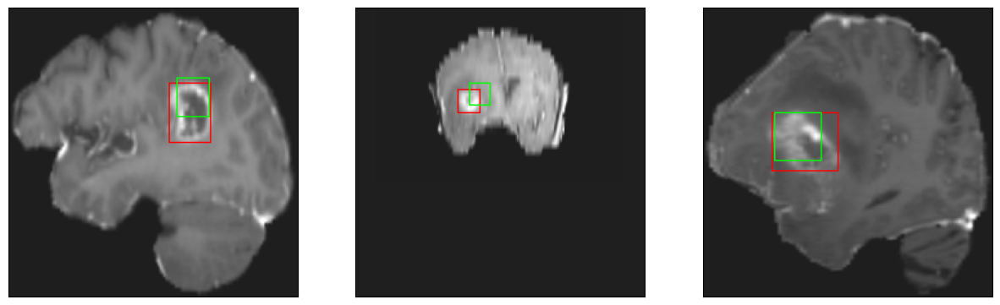

26/26 [==============================] - 4s 148ms/step - loss: 5.5065 - IoU: 0.5943 - val_loss: 8.9404 - val_IoU: 0.4931
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 6.0728 - IoU: 0.5545
Epoch 50: val_loss did not improve from 8.94042
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


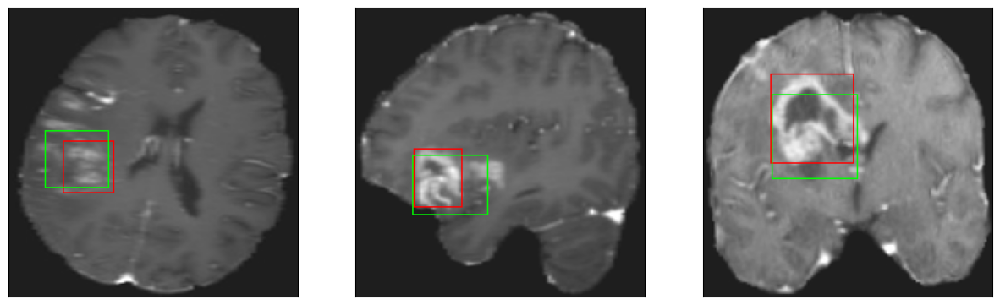

26/26 [==============================] - 3s 116ms/step - loss: 6.0728 - IoU: 0.5545 - val_loss: 10.3420 - val_IoU: 0.4255
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 5.7474 - IoU: 0.5673
Epoch 51: val_loss did not improve from 8.94042
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 14ms/step
4


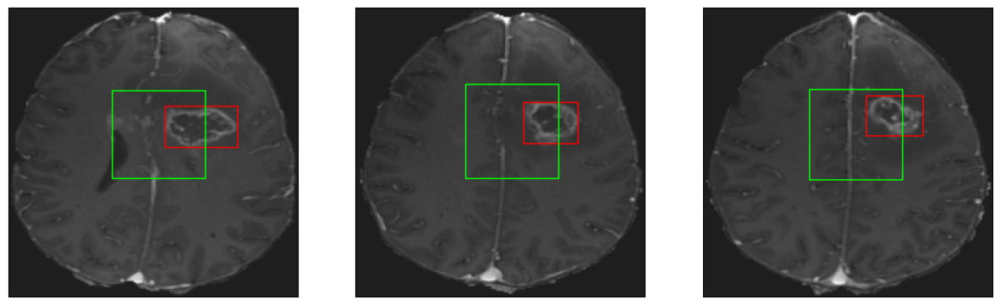

26/26 [==============================] - 4s 146ms/step - loss: 5.7474 - IoU: 0.5673 - val_loss: 12.6966 - val_IoU: 0.3284
Epoch 52/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4423 - IoU: 0.5901
Epoch 52: val_loss did not improve from 8.94042
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


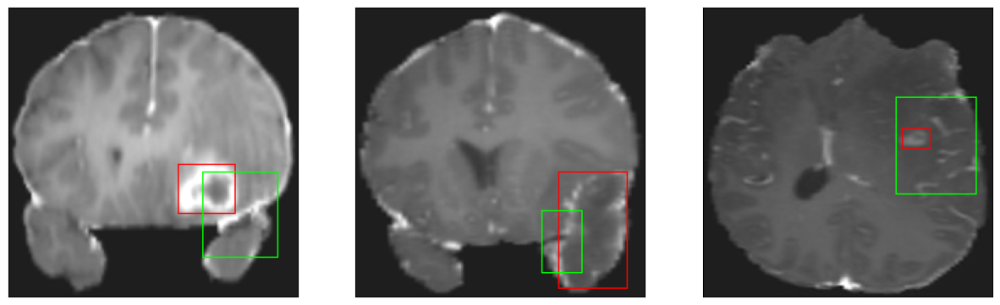

26/26 [==============================] - 3s 110ms/step - loss: 5.5210 - IoU: 0.5876 - val_loss: 14.4773 - val_IoU: 0.2766
Epoch 53/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5128 - IoU: 0.5892
Epoch 53: val_loss improved from 8.94042 to 8.71897, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


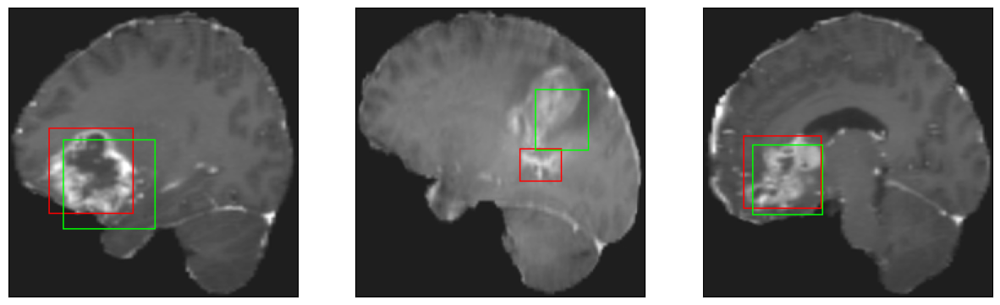

26/26 [==============================] - 4s 150ms/step - loss: 5.5145 - IoU: 0.5889 - val_loss: 8.7190 - val_IoU: 0.4879
Epoch 54/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8145 - IoU: 0.5589
Epoch 54: val_loss did not improve from 8.71897
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


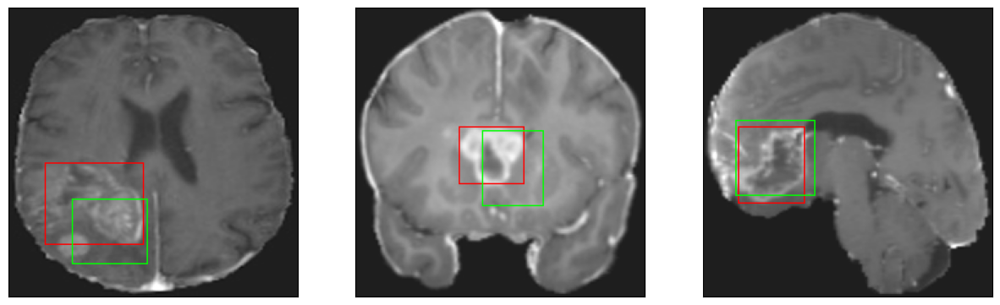

26/26 [==============================] - 3s 115ms/step - loss: 5.7757 - IoU: 0.5613 - val_loss: 10.3056 - val_IoU: 0.4382
Epoch 55/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4710 - IoU: 0.5456
Epoch 55: val_loss did not improve from 8.71897
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


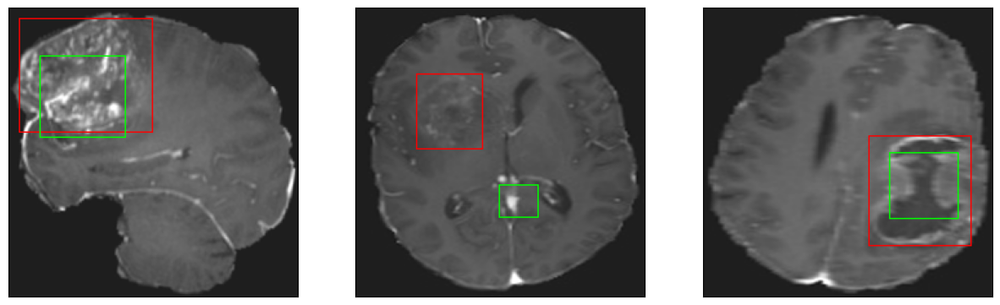

26/26 [==============================] - 3s 115ms/step - loss: 6.4451 - IoU: 0.5452 - val_loss: 10.1024 - val_IoU: 0.4466
Epoch 56/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5266 - IoU: 0.5892
Epoch 56: val_loss did not improve from 8.71897
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


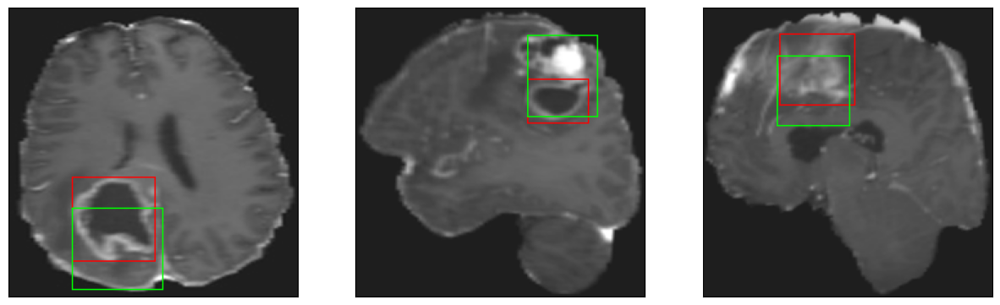

26/26 [==============================] - 3s 112ms/step - loss: 5.4927 - IoU: 0.5906 - val_loss: 11.3843 - val_IoU: 0.3854
Epoch 57/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5766 - IoU: 0.5852
Epoch 57: val_loss did not improve from 8.71897
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


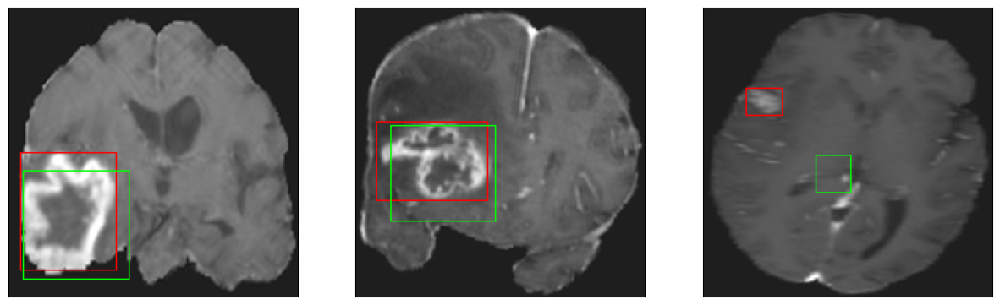

26/26 [==============================] - 3s 116ms/step - loss: 5.6038 - IoU: 0.5847 - val_loss: 9.7872 - val_IoU: 0.4585
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 5.6490 - IoU: 0.5809
Epoch 58: val_loss did not improve from 8.71897
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4


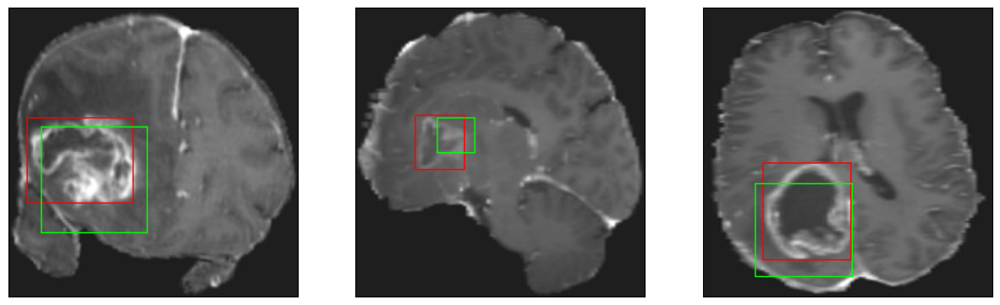

26/26 [==============================] - 4s 137ms/step - loss: 5.6490 - IoU: 0.5809 - val_loss: 9.0511 - val_IoU: 0.4830
Epoch 59/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6432 - IoU: 0.5768
Epoch 59: val_loss did not improve from 8.71897
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


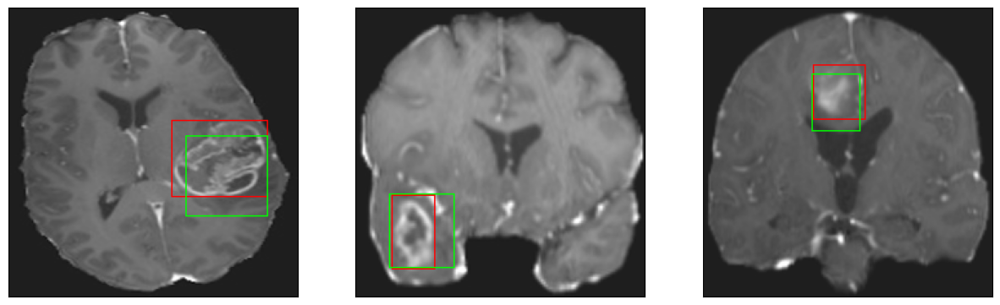

26/26 [==============================] - 3s 134ms/step - loss: 5.7104 - IoU: 0.5760 - val_loss: 9.1354 - val_IoU: 0.5054
Epoch 60/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5184 - IoU: 0.5795
Epoch 60: val_loss improved from 8.71897 to 8.48312, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


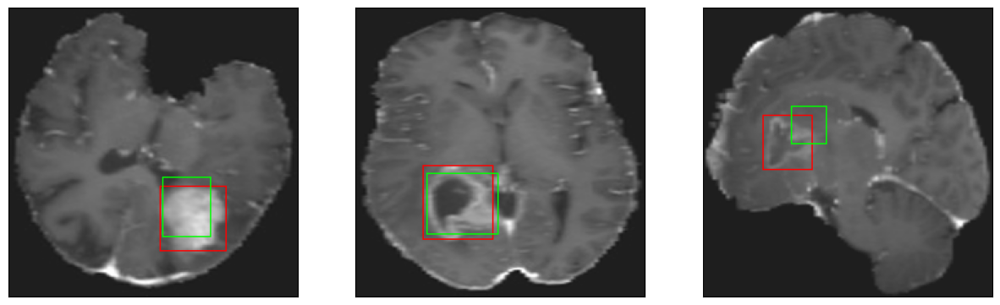

26/26 [==============================] - 4s 165ms/step - loss: 5.5532 - IoU: 0.5778 - val_loss: 8.4831 - val_IoU: 0.5030
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 5.7937 - IoU: 0.5848
Epoch 61: val_loss improved from 8.48312 to 8.36360, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


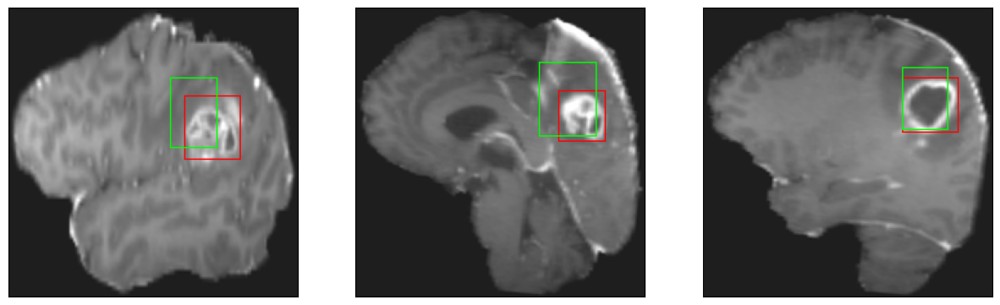

26/26 [==============================] - 3s 128ms/step - loss: 5.7937 - IoU: 0.5848 - val_loss: 8.3636 - val_IoU: 0.5229
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 5.3051 - IoU: 0.5967
Epoch 62: val_loss did not improve from 8.36360
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


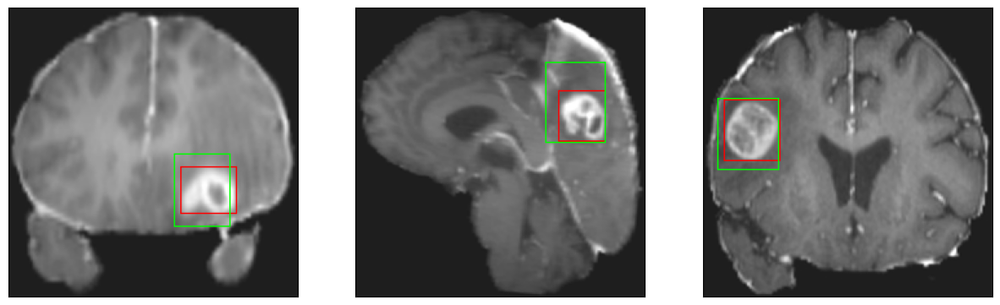

26/26 [==============================] - 4s 141ms/step - loss: 5.3051 - IoU: 0.5967 - val_loss: 9.4342 - val_IoU: 0.4780
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 5.1576 - IoU: 0.6073
Epoch 63: val_loss did not improve from 8.36360
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


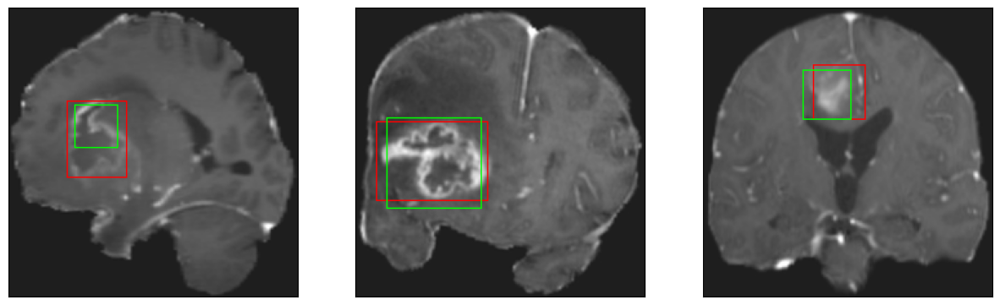

26/26 [==============================] - 3s 110ms/step - loss: 5.1576 - IoU: 0.6073 - val_loss: 8.8282 - val_IoU: 0.4835
Epoch 64/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6860 - IoU: 0.5791
Epoch 64: val_loss did not improve from 8.36360
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


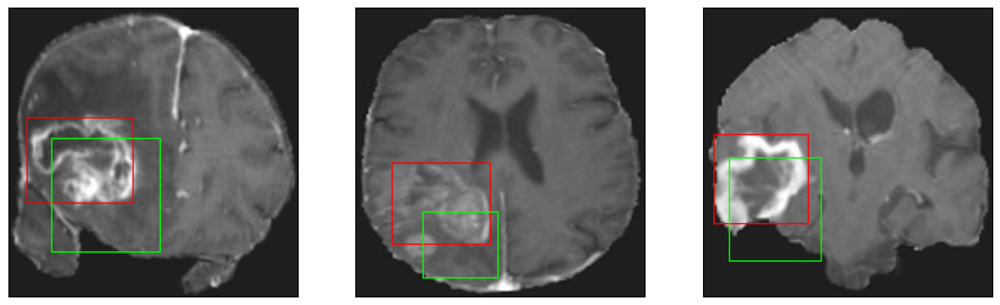

26/26 [==============================] - 3s 115ms/step - loss: 5.7072 - IoU: 0.5780 - val_loss: 13.4553 - val_IoU: 0.3246
Epoch 65/200
26/26 [==============================] - ETA: 0s - loss: 5.5125 - IoU: 0.5826
Epoch 65: val_loss did not improve from 8.36360
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


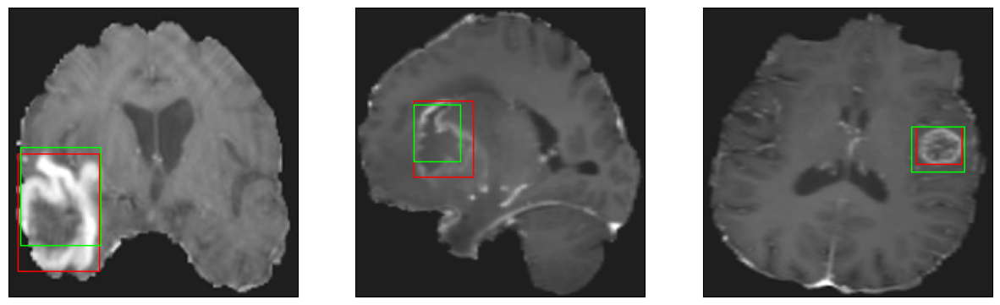

26/26 [==============================] - 3s 115ms/step - loss: 5.5125 - IoU: 0.5826 - val_loss: 9.0484 - val_IoU: 0.4933
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 5.1566 - IoU: 0.5983
Epoch 66: val_loss did not improve from 8.36360
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


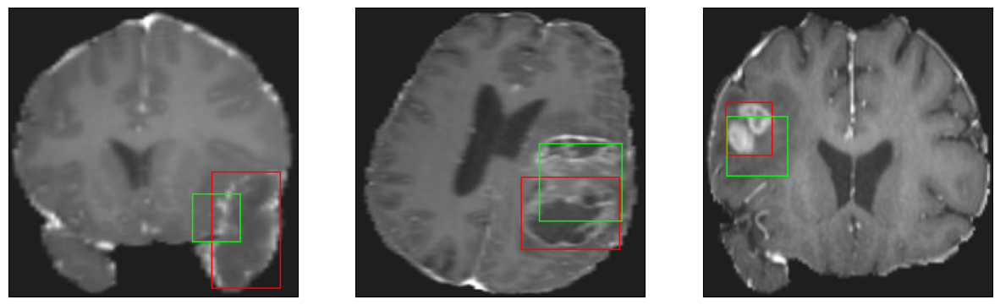

26/26 [==============================] - 4s 142ms/step - loss: 5.1566 - IoU: 0.5983 - val_loss: 12.8305 - val_IoU: 0.3245
Epoch 67/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5607 - IoU: 0.5846
Epoch 67: val_loss did not improve from 8.36360
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


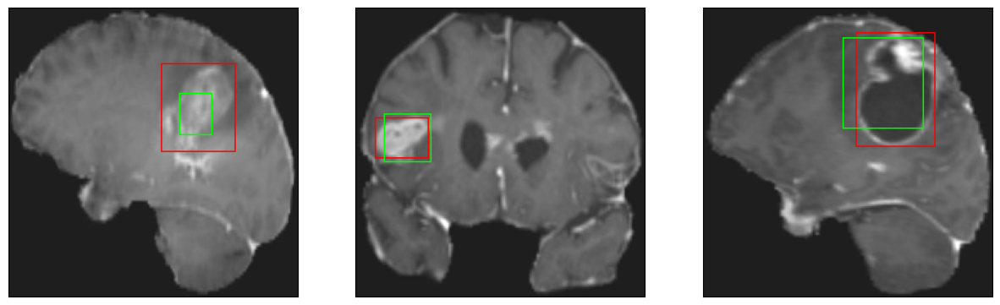

26/26 [==============================] - 3s 119ms/step - loss: 5.5485 - IoU: 0.5852 - val_loss: 9.7518 - val_IoU: 0.4360
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 5.4071 - IoU: 0.5932
Epoch 68: val_loss did not improve from 8.36360
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


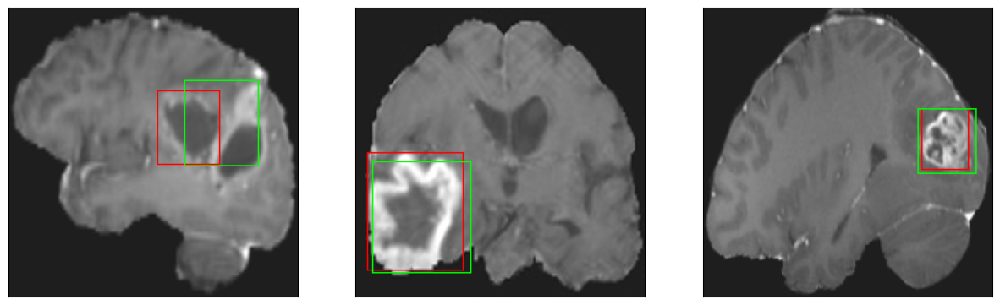

26/26 [==============================] - 3s 130ms/step - loss: 5.4071 - IoU: 0.5932 - val_loss: 8.5871 - val_IoU: 0.4945
Epoch 69/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2578 - IoU: 0.6015
Epoch 69: val_loss did not improve from 8.36360
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


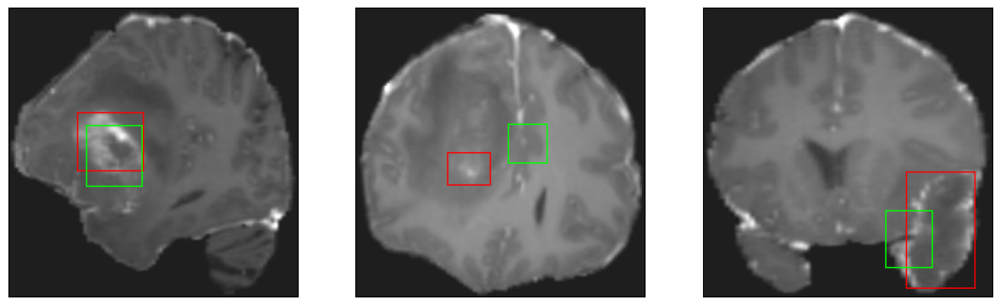

26/26 [==============================] - 3s 122ms/step - loss: 5.2687 - IoU: 0.6007 - val_loss: 11.6376 - val_IoU: 0.3390
Epoch 70/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4542 - IoU: 0.5943
Epoch 70: val_loss did not improve from 8.36360
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


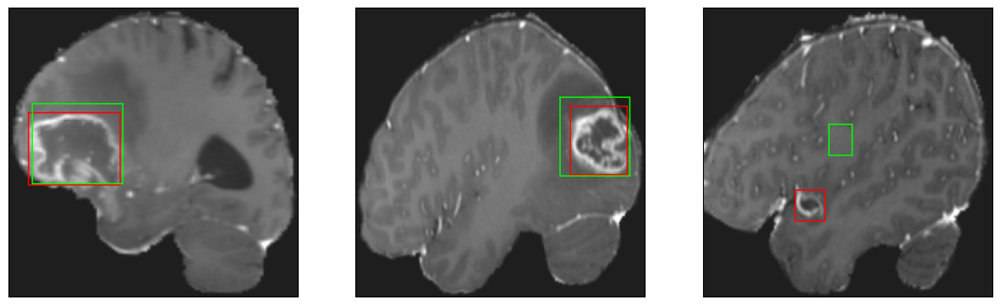

26/26 [==============================] - 3s 114ms/step - loss: 5.4737 - IoU: 0.5937 - val_loss: 10.0328 - val_IoU: 0.4685
Epoch 71/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1078 - IoU: 0.6191
Epoch 71: val_loss did not improve from 8.36360
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


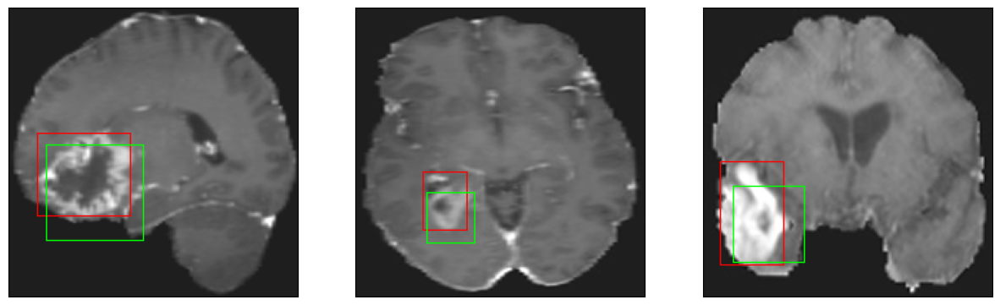

26/26 [==============================] - 3s 108ms/step - loss: 5.0773 - IoU: 0.6201 - val_loss: 10.0226 - val_IoU: 0.4067
Epoch 72/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3726 - IoU: 0.5936
Epoch 72: val_loss did not improve from 8.36360
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


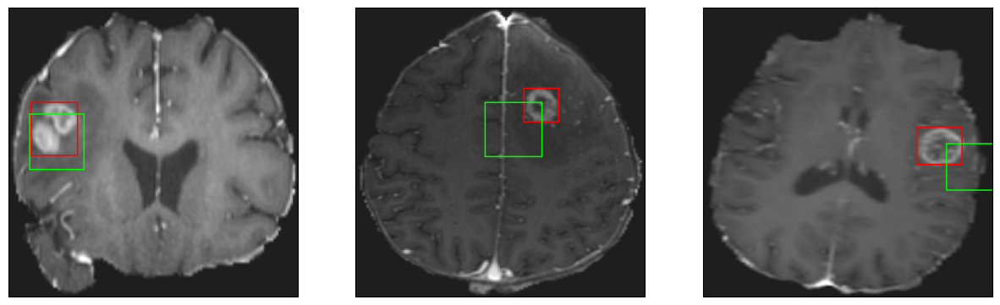

26/26 [==============================] - 3s 109ms/step - loss: 5.3660 - IoU: 0.5953 - val_loss: 12.3363 - val_IoU: 0.2931
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 5.4044 - IoU: 0.6018
Epoch 73: val_loss improved from 8.36360 to 8.28716, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 13ms/step
4


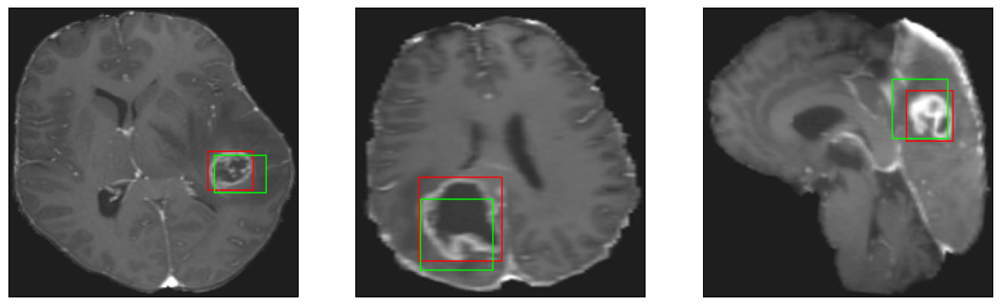

26/26 [==============================] - 5s 181ms/step - loss: 5.4044 - IoU: 0.6018 - val_loss: 8.2872 - val_IoU: 0.5230
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 5.8903 - IoU: 0.5835
Epoch 74: val_loss did not improve from 8.28716
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


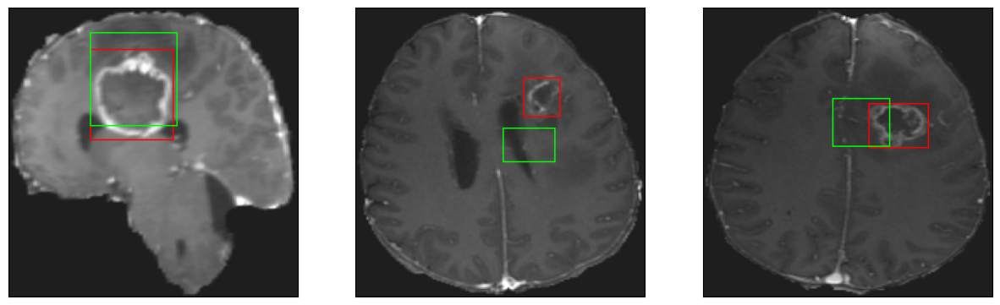

26/26 [==============================] - 3s 111ms/step - loss: 5.8903 - IoU: 0.5835 - val_loss: 9.8443 - val_IoU: 0.4531
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 5.7105 - IoU: 0.5709
Epoch 75: val_loss did not improve from 8.28716
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


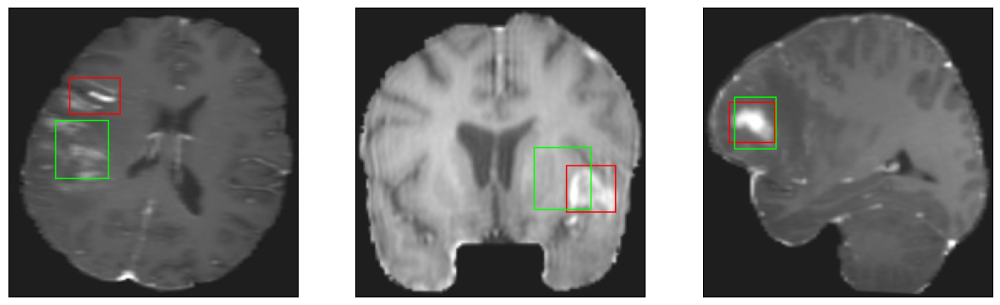

26/26 [==============================] - 3s 117ms/step - loss: 5.7105 - IoU: 0.5709 - val_loss: 8.4120 - val_IoU: 0.5113
Epoch 76/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1473 - IoU: 0.6036
Epoch 76: val_loss did not improve from 8.28716
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


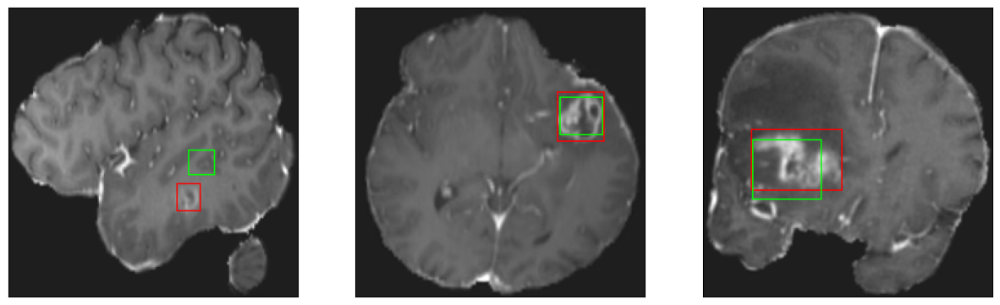

26/26 [==============================] - 3s 112ms/step - loss: 5.0913 - IoU: 0.6065 - val_loss: 8.5168 - val_IoU: 0.5008
Epoch 77/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1616 - IoU: 0.6064
Epoch 77: val_loss did not improve from 8.28716
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


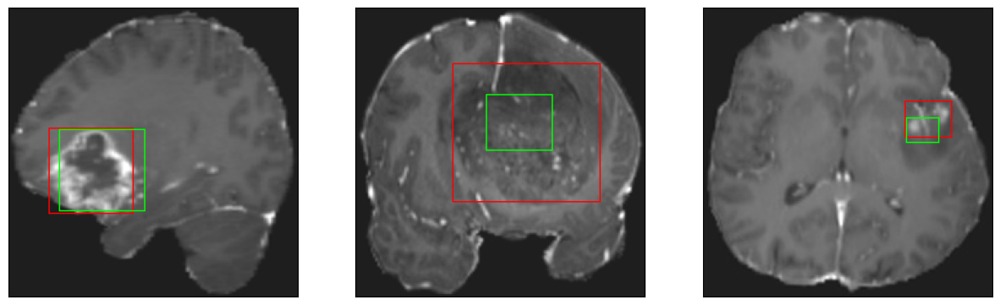

26/26 [==============================] - 3s 132ms/step - loss: 5.1439 - IoU: 0.6070 - val_loss: 8.5057 - val_IoU: 0.4993
Epoch 78/200
26/26 [==============================] - ETA: 0s - loss: 5.1676 - IoU: 0.6055
Epoch 78: val_loss did not improve from 8.28716
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


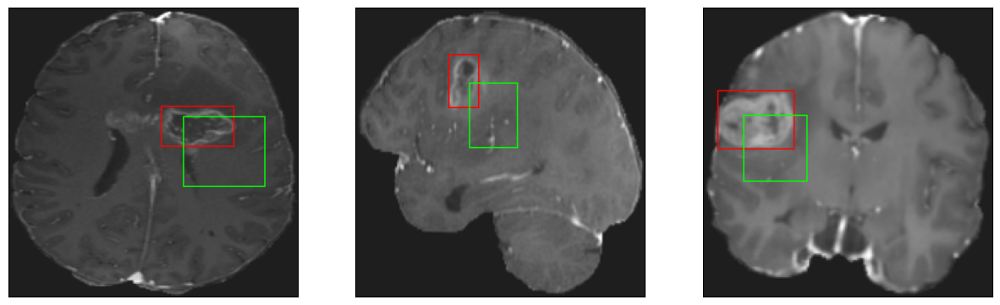

26/26 [==============================] - 3s 112ms/step - loss: 5.1676 - IoU: 0.6055 - val_loss: 17.3914 - val_IoU: 0.2214
Epoch 79/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2826 - IoU: 0.6007
Epoch 79: val_loss did not improve from 8.28716
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


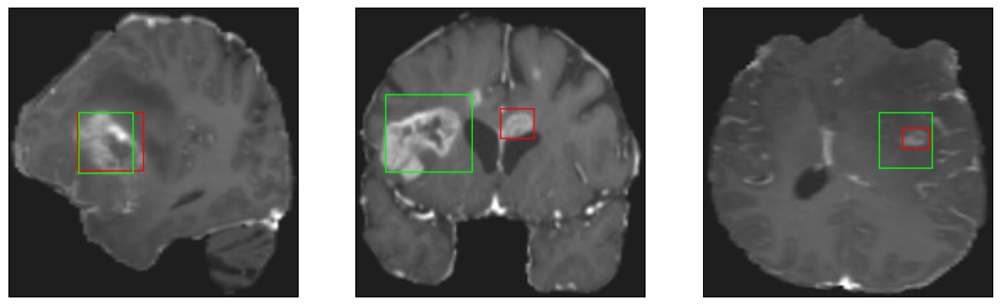

26/26 [==============================] - 3s 121ms/step - loss: 5.2447 - IoU: 0.6024 - val_loss: 8.8858 - val_IoU: 0.4842
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 4.9179 - IoU: 0.6141
Epoch 80: val_loss did not improve from 8.28716
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


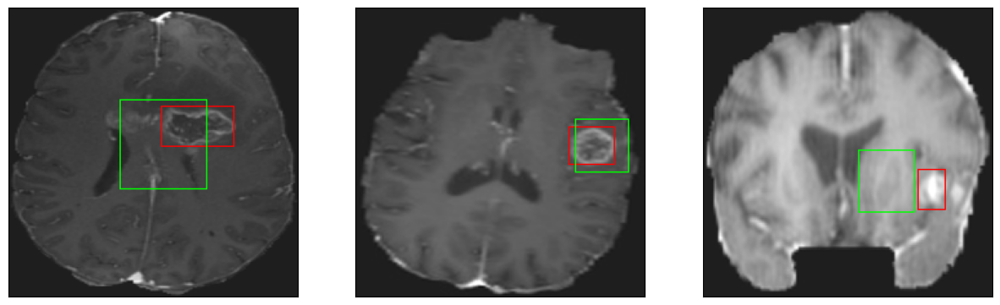

26/26 [==============================] - 3s 133ms/step - loss: 4.9179 - IoU: 0.6141 - val_loss: 9.0214 - val_IoU: 0.4903
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 5.0944 - IoU: 0.6149
Epoch 81: val_loss did not improve from 8.28716
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


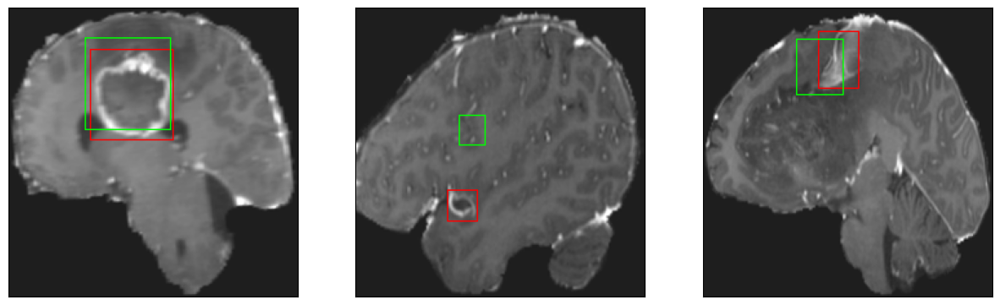

26/26 [==============================] - 3s 106ms/step - loss: 5.0944 - IoU: 0.6149 - val_loss: 9.3063 - val_IoU: 0.4562
Epoch 82/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1211 - IoU: 0.6115
Epoch 82: val_loss improved from 8.28716 to 8.24034, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4


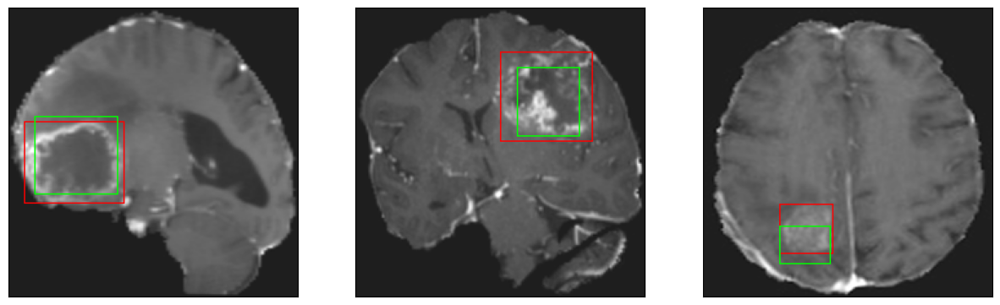

26/26 [==============================] - 4s 149ms/step - loss: 5.1190 - IoU: 0.6125 - val_loss: 8.2403 - val_IoU: 0.5147
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 5.0092 - IoU: 0.6133
Epoch 83: val_loss did not improve from 8.24034
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


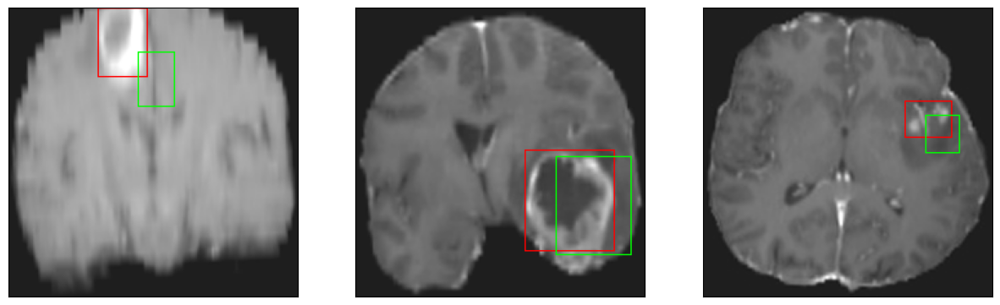

26/26 [==============================] - 3s 115ms/step - loss: 5.0092 - IoU: 0.6133 - val_loss: 9.8010 - val_IoU: 0.4377
Epoch 84/200
26/26 [==============================] - ETA: 0s - loss: 5.0877 - IoU: 0.6068
Epoch 84: val_loss did not improve from 8.24034
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


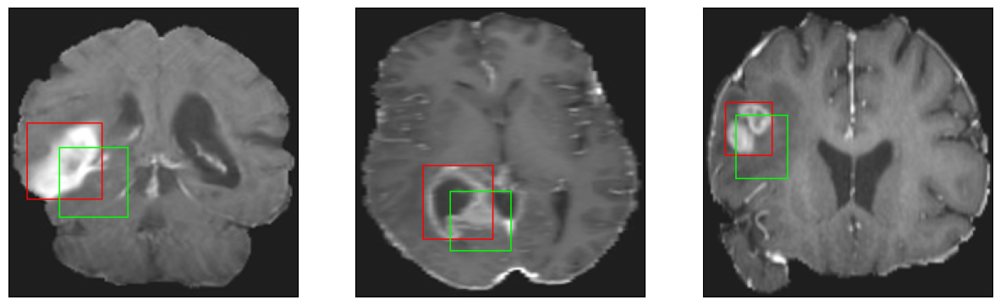

26/26 [==============================] - 3s 125ms/step - loss: 5.0877 - IoU: 0.6068 - val_loss: 12.1962 - val_IoU: 0.2932
Epoch 85/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2376 - IoU: 0.6037
Epoch 85: val_loss improved from 8.24034 to 8.01798, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


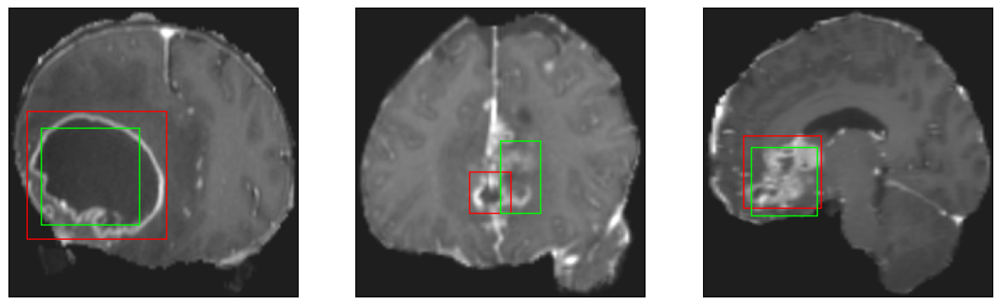

26/26 [==============================] - 4s 166ms/step - loss: 5.2086 - IoU: 0.6050 - val_loss: 8.0180 - val_IoU: 0.5254
Epoch 86/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9810 - IoU: 0.6153
Epoch 86: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


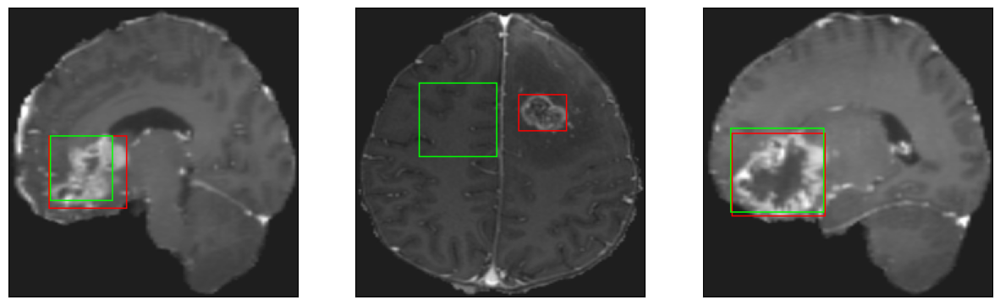

26/26 [==============================] - 3s 113ms/step - loss: 4.9345 - IoU: 0.6159 - val_loss: 9.4535 - val_IoU: 0.4600
Epoch 87/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9918 - IoU: 0.6234
Epoch 87: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


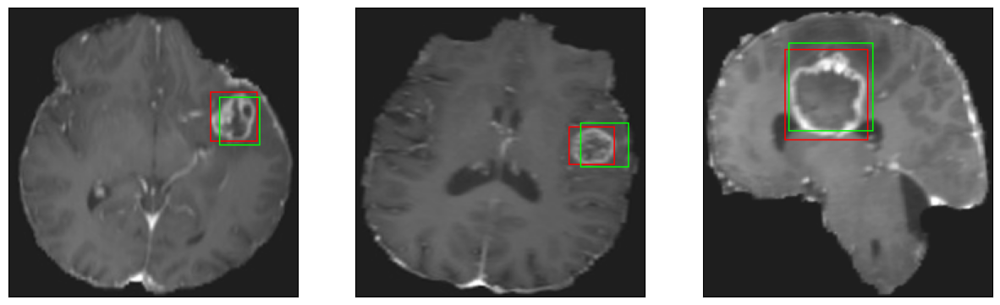

26/26 [==============================] - 4s 143ms/step - loss: 5.0124 - IoU: 0.6239 - val_loss: 8.4339 - val_IoU: 0.5205
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 5.0350 - IoU: 0.6212
Epoch 88: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


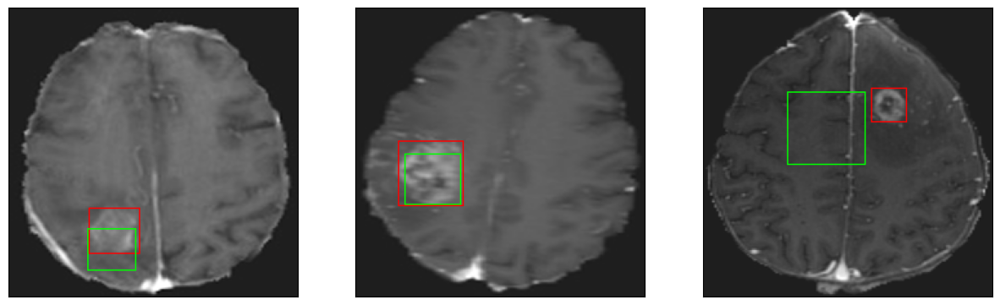

26/26 [==============================] - 3s 130ms/step - loss: 5.0350 - IoU: 0.6212 - val_loss: 8.5111 - val_IoU: 0.4916
Epoch 89/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9391 - IoU: 0.6117
Epoch 89: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


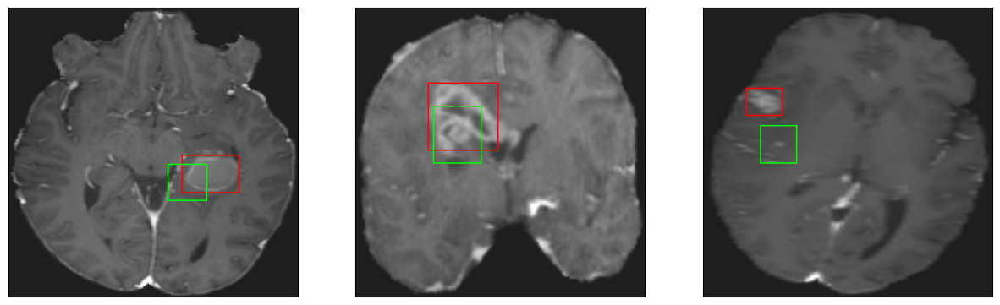

26/26 [==============================] - 3s 107ms/step - loss: 4.9274 - IoU: 0.6120 - val_loss: 8.9224 - val_IoU: 0.4683
Epoch 90/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9904 - IoU: 0.6172
Epoch 90: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4


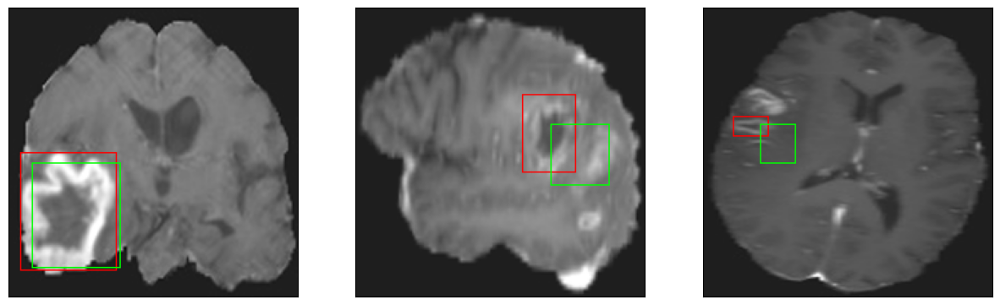

26/26 [==============================] - 3s 134ms/step - loss: 4.9504 - IoU: 0.6182 - val_loss: 8.9329 - val_IoU: 0.4626
Epoch 91/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7402 - IoU: 0.6345
Epoch 91: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


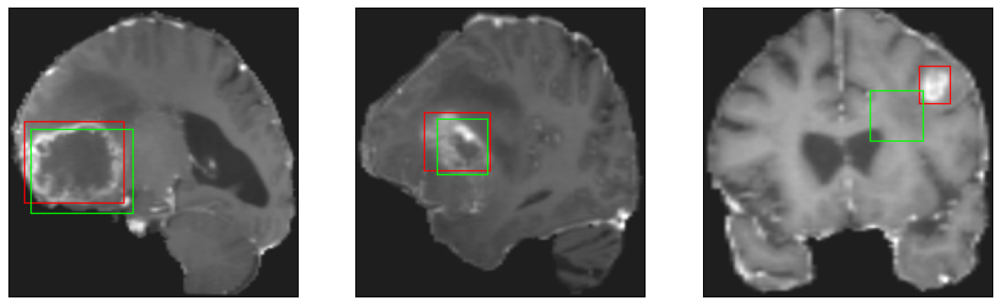

26/26 [==============================] - 3s 115ms/step - loss: 4.7424 - IoU: 0.6349 - val_loss: 9.3040 - val_IoU: 0.4608
Epoch 92/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7406 - IoU: 0.6363
Epoch 92: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


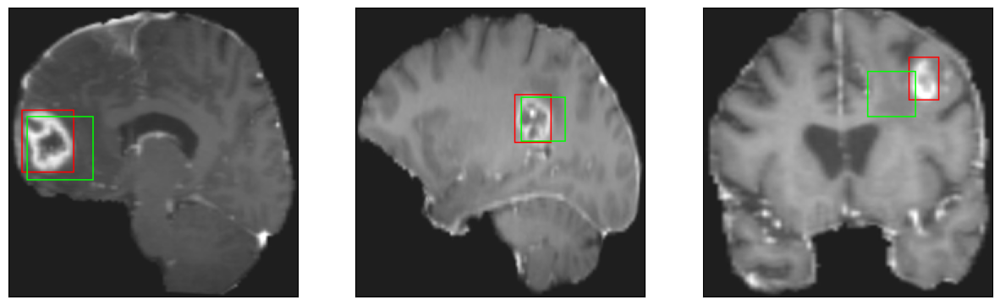

26/26 [==============================] - 3s 111ms/step - loss: 4.7152 - IoU: 0.6367 - val_loss: 9.1546 - val_IoU: 0.4691
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 4.5973 - IoU: 0.6369
Epoch 93: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


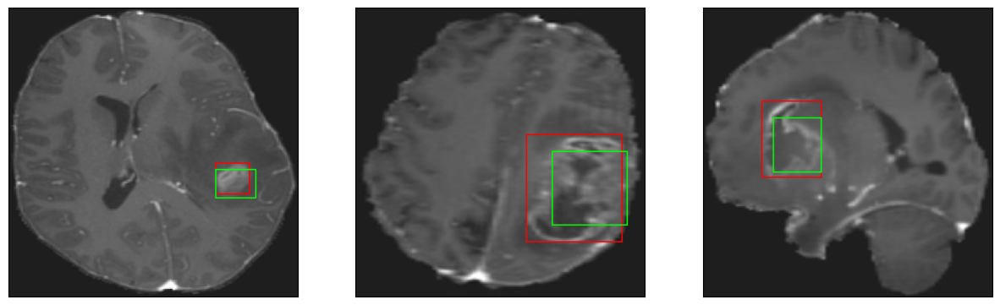

26/26 [==============================] - 3s 102ms/step - loss: 4.5973 - IoU: 0.6369 - val_loss: 9.2031 - val_IoU: 0.4761
Epoch 94/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7055 - IoU: 0.6392
Epoch 94: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


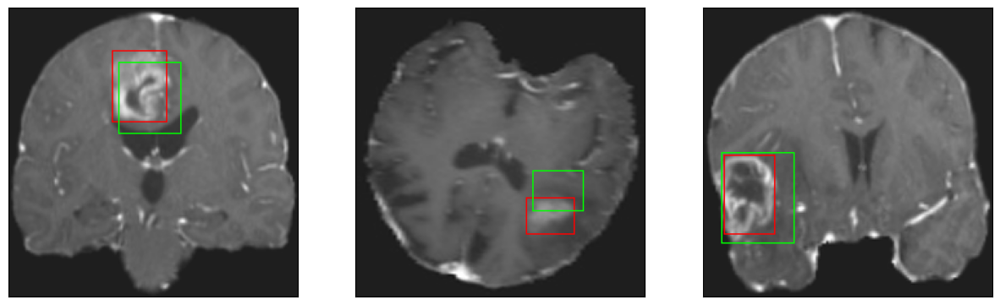

26/26 [==============================] - 3s 134ms/step - loss: 4.6927 - IoU: 0.6399 - val_loss: 8.0651 - val_IoU: 0.5379
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 4.6317 - IoU: 0.6416
Epoch 95: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


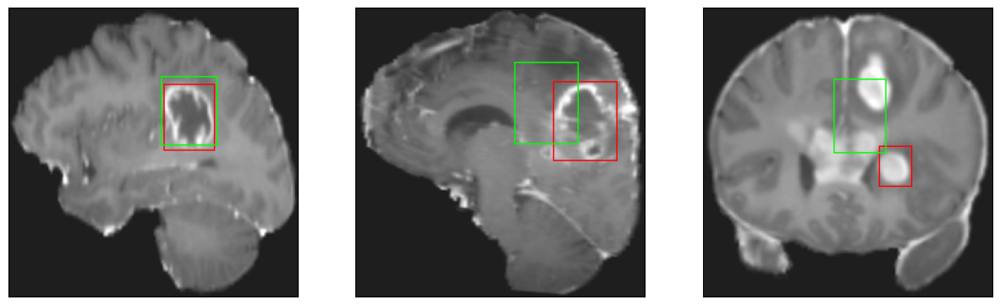

26/26 [==============================] - 4s 135ms/step - loss: 4.6317 - IoU: 0.6416 - val_loss: 8.8813 - val_IoU: 0.4930
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 4.6729 - IoU: 0.6325
Epoch 96: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


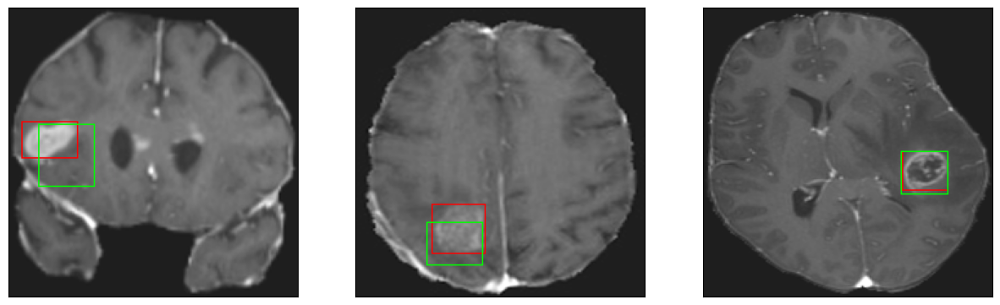

26/26 [==============================] - 3s 101ms/step - loss: 4.6729 - IoU: 0.6325 - val_loss: 8.5712 - val_IoU: 0.5143
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 4.9454 - IoU: 0.6304
Epoch 97: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


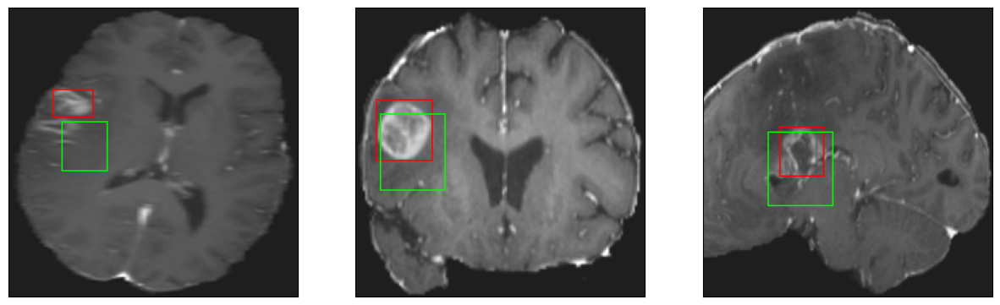

26/26 [==============================] - 3s 124ms/step - loss: 4.9454 - IoU: 0.6304 - val_loss: 13.3203 - val_IoU: 0.3079
Epoch 98/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8087 - IoU: 0.6327
Epoch 98: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


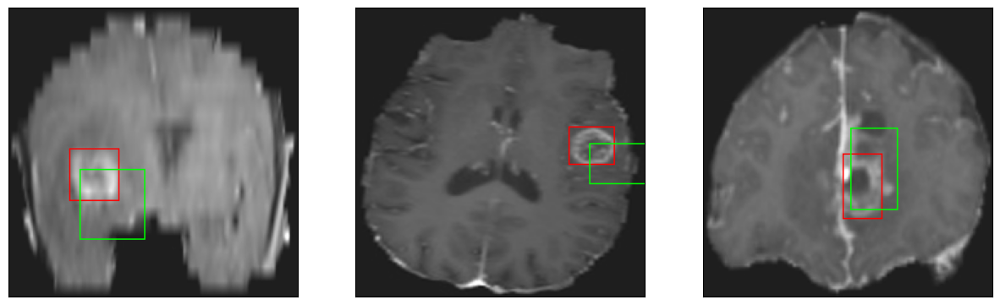

26/26 [==============================] - 3s 133ms/step - loss: 4.8342 - IoU: 0.6304 - val_loss: 11.5516 - val_IoU: 0.3205
Epoch 99/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8343 - IoU: 0.6249
Epoch 99: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


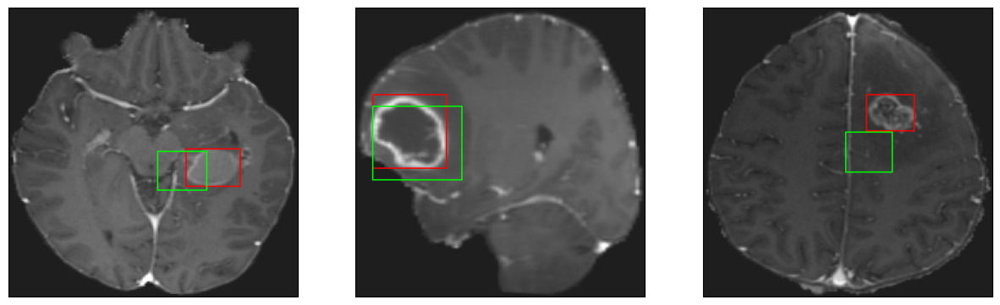

26/26 [==============================] - 3s 112ms/step - loss: 4.8427 - IoU: 0.6241 - val_loss: 9.9316 - val_IoU: 0.4559
Epoch 100/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1734 - IoU: 0.6081
Epoch 100: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


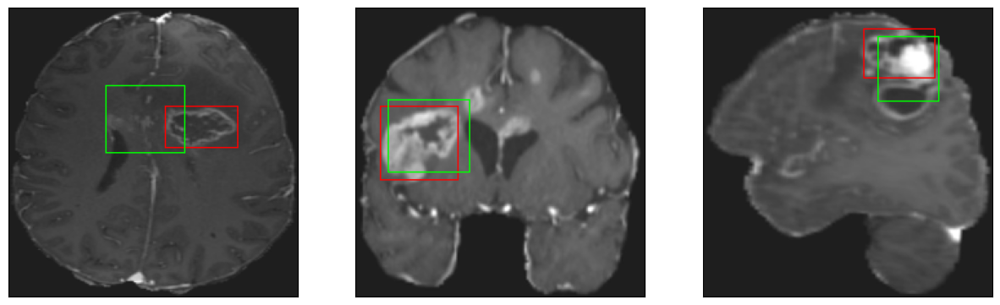

26/26 [==============================] - 3s 122ms/step - loss: 5.1667 - IoU: 0.6085 - val_loss: 8.1454 - val_IoU: 0.5268
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 4.8540 - IoU: 0.6345
Epoch 101: val_loss did not improve from 8.01798
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


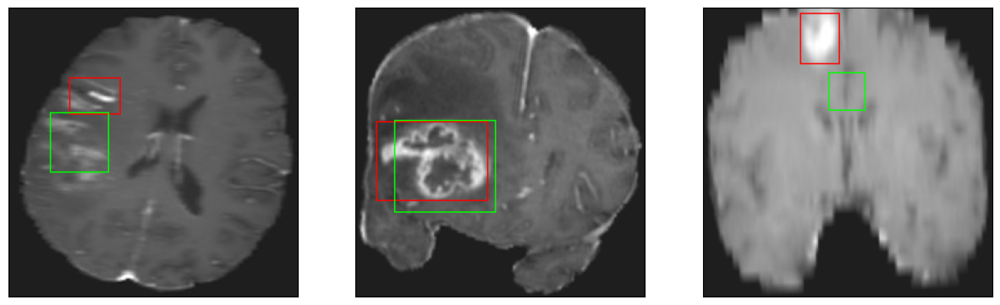

26/26 [==============================] - 4s 136ms/step - loss: 4.8540 - IoU: 0.6345 - val_loss: 8.4884 - val_IoU: 0.5211
Epoch 102/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9837 - IoU: 0.6155
Epoch 102: val_loss improved from 8.01798 to 8.01709, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


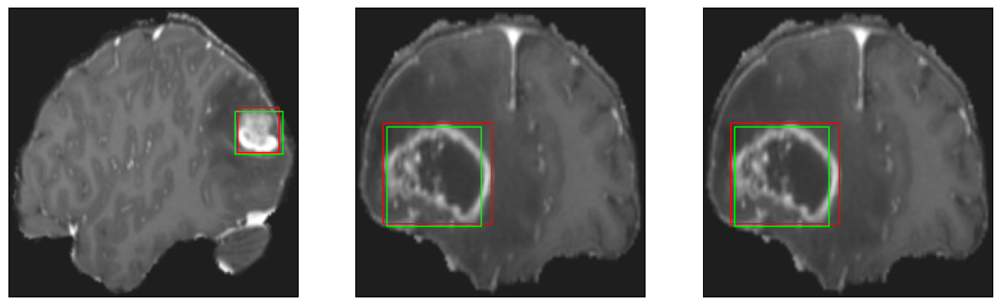

26/26 [==============================] - 4s 161ms/step - loss: 4.9187 - IoU: 0.6183 - val_loss: 8.0171 - val_IoU: 0.5371
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 5.0176 - IoU: 0.6262
Epoch 103: val_loss did not improve from 8.01709
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


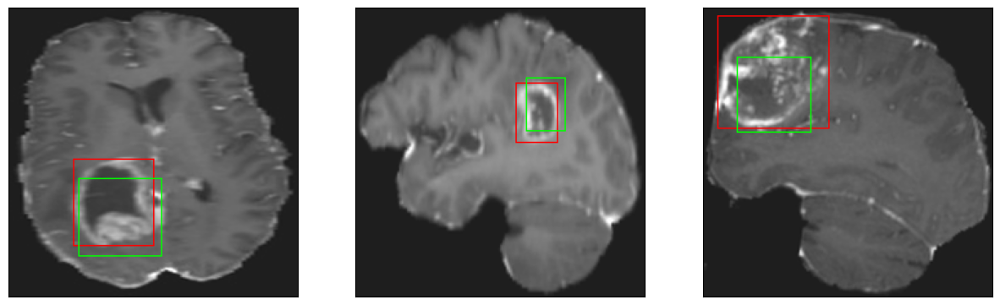

26/26 [==============================] - 3s 113ms/step - loss: 5.0176 - IoU: 0.6262 - val_loss: 9.0478 - val_IoU: 0.4482
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 4.6882 - IoU: 0.6327
Epoch 104: val_loss did not improve from 8.01709
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


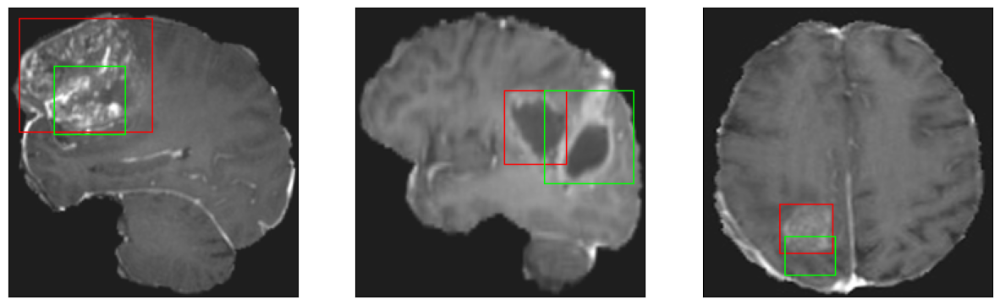

26/26 [==============================] - 3s 110ms/step - loss: 4.6882 - IoU: 0.6327 - val_loss: 10.4158 - val_IoU: 0.3807
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 5.0248 - IoU: 0.6088
Epoch 105: val_loss did not improve from 8.01709
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 7ms/step
4


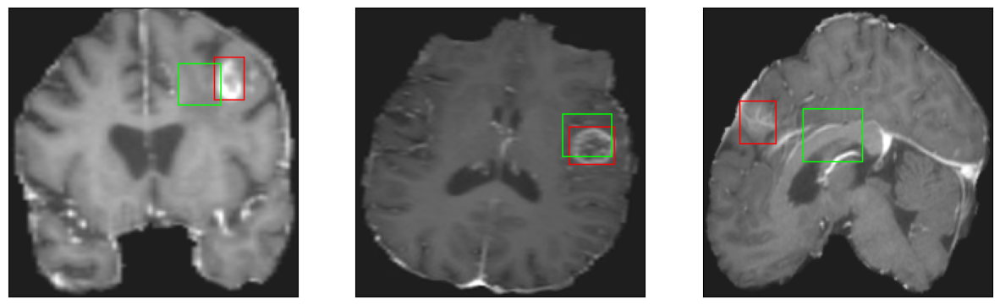

26/26 [==============================] - 3s 128ms/step - loss: 5.0248 - IoU: 0.6088 - val_loss: 8.5045 - val_IoU: 0.4911
Epoch 106/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8652 - IoU: 0.6137
Epoch 106: val_loss did not improve from 8.01709
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


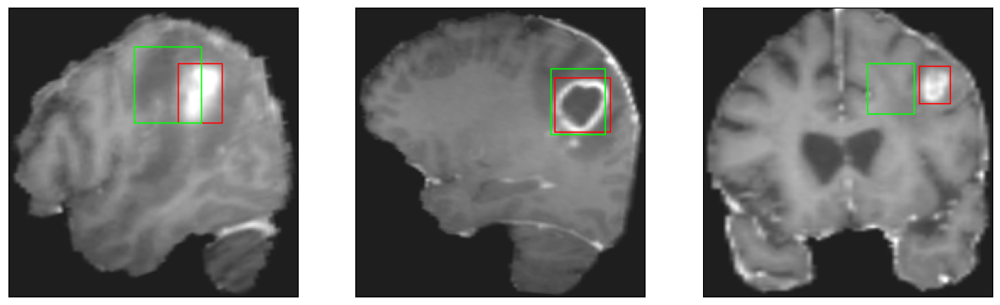

26/26 [==============================] - 3s 115ms/step - loss: 4.8382 - IoU: 0.6152 - val_loss: 9.0210 - val_IoU: 0.4677
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 4.8121 - IoU: 0.6273
Epoch 107: val_loss improved from 8.01709 to 7.71182, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


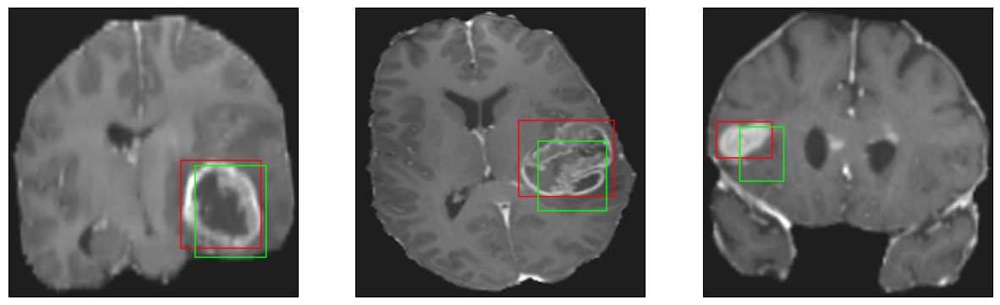

26/26 [==============================] - 4s 153ms/step - loss: 4.8121 - IoU: 0.6273 - val_loss: 7.7118 - val_IoU: 0.5442
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 4.6212 - IoU: 0.6318
Epoch 108: val_loss did not improve from 7.71182
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


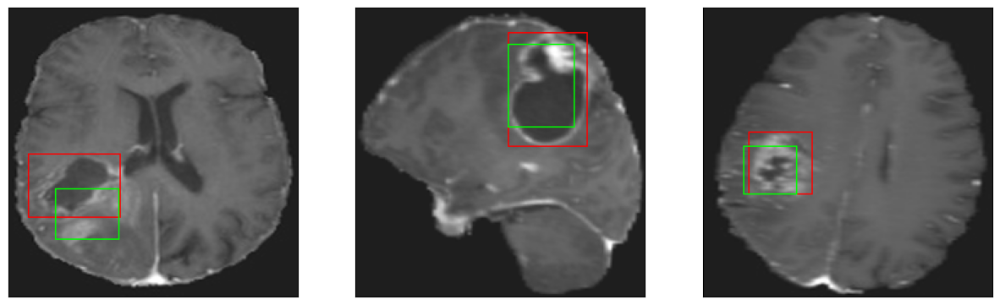

26/26 [==============================] - 3s 132ms/step - loss: 4.6212 - IoU: 0.6318 - val_loss: 7.7930 - val_IoU: 0.5418
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 4.7153 - IoU: 0.6341
Epoch 109: val_loss did not improve from 7.71182
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


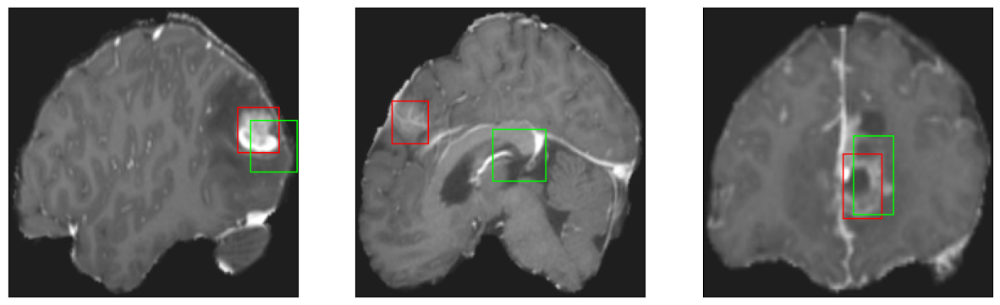

26/26 [==============================] - 3s 113ms/step - loss: 4.7153 - IoU: 0.6341 - val_loss: 9.8998 - val_IoU: 0.4144
Epoch 110/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7754 - IoU: 0.6211
Epoch 110: val_loss did not improve from 7.71182
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


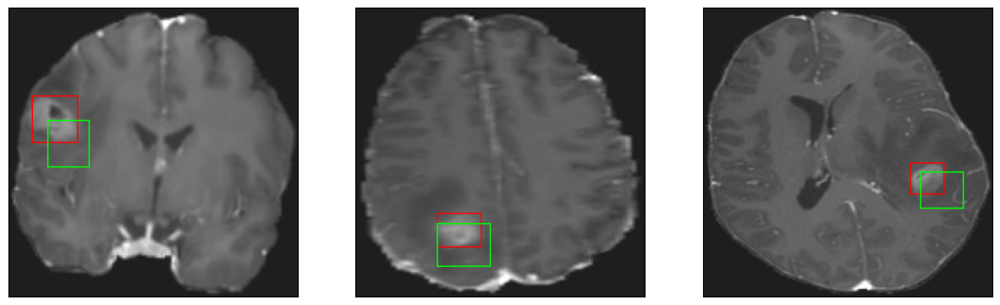

26/26 [==============================] - 3s 111ms/step - loss: 4.7688 - IoU: 0.6195 - val_loss: 9.3512 - val_IoU: 0.4551
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 5.0105 - IoU: 0.6186
Epoch 111: val_loss did not improve from 7.71182
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


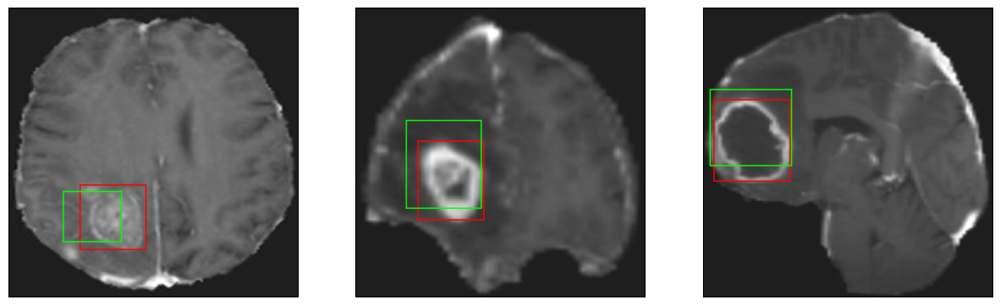

26/26 [==============================] - 3s 131ms/step - loss: 5.0105 - IoU: 0.6186 - val_loss: 9.4602 - val_IoU: 0.4529
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 4.6722 - IoU: 0.6338
Epoch 112: val_loss did not improve from 7.71182
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


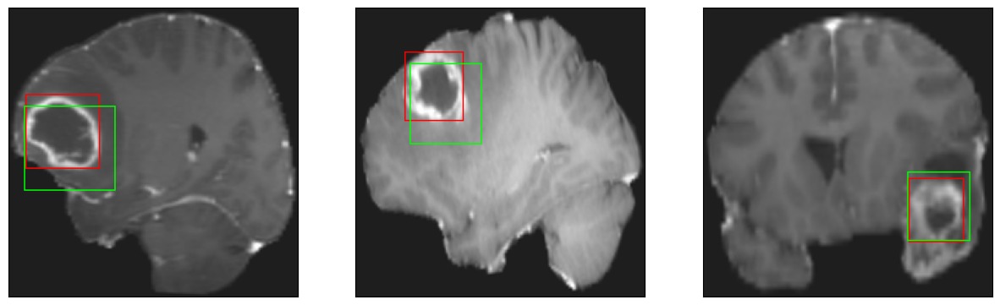

26/26 [==============================] - 3s 124ms/step - loss: 4.6722 - IoU: 0.6338 - val_loss: 10.7117 - val_IoU: 0.4169
Epoch 113/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7174 - IoU: 0.6259
Epoch 113: val_loss did not improve from 7.71182
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


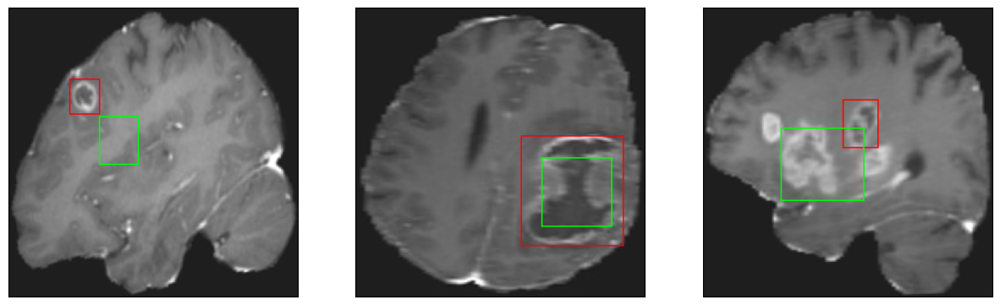

26/26 [==============================] - 3s 108ms/step - loss: 4.6918 - IoU: 0.6265 - val_loss: 12.1338 - val_IoU: 0.3761
Epoch 114/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6349 - IoU: 0.6349
Epoch 114: val_loss did not improve from 7.71182
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


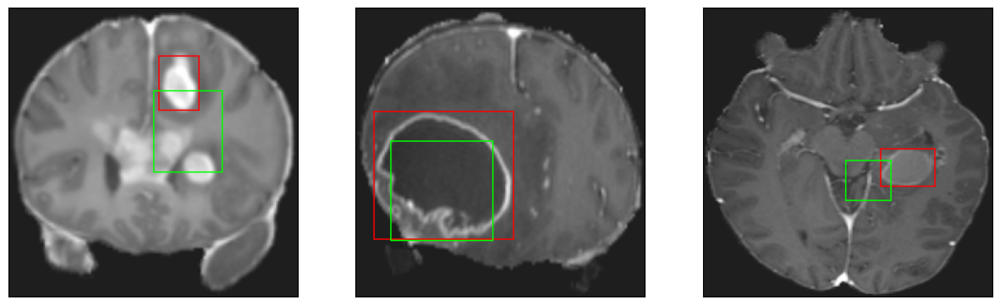

26/26 [==============================] - 3s 109ms/step - loss: 4.7187 - IoU: 0.6312 - val_loss: 11.3356 - val_IoU: 0.3655
Epoch 115/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8807 - IoU: 0.6284
Epoch 115: val_loss did not improve from 7.71182
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


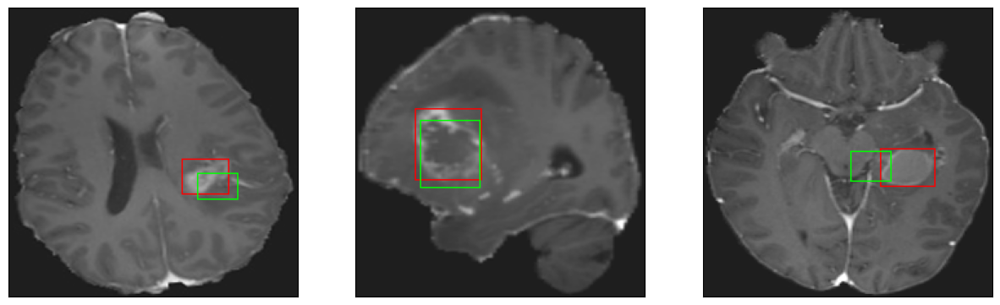

26/26 [==============================] - 3s 125ms/step - loss: 4.8936 - IoU: 0.6285 - val_loss: 9.3746 - val_IoU: 0.4288
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 4.9584 - IoU: 0.6207
Epoch 116: val_loss did not improve from 7.71182
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


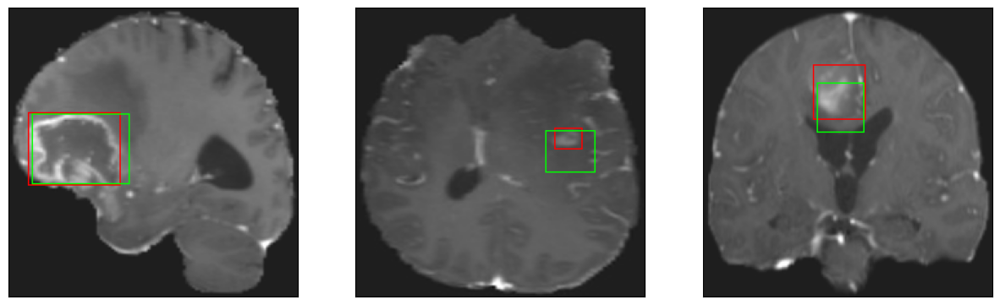

26/26 [==============================] - 3s 108ms/step - loss: 4.9584 - IoU: 0.6207 - val_loss: 8.7470 - val_IoU: 0.4826
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 4.4084 - IoU: 0.6463
Epoch 117: val_loss improved from 7.71182 to 7.50219, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


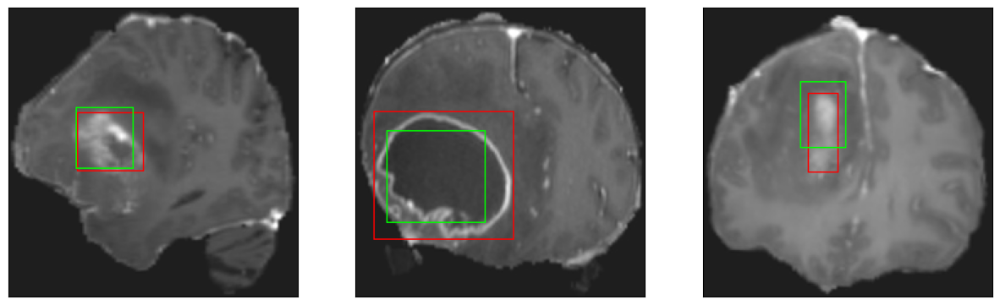

26/26 [==============================] - 4s 152ms/step - loss: 4.4084 - IoU: 0.6463 - val_loss: 7.5022 - val_IoU: 0.5457
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 4.7367 - IoU: 0.6288
Epoch 118: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


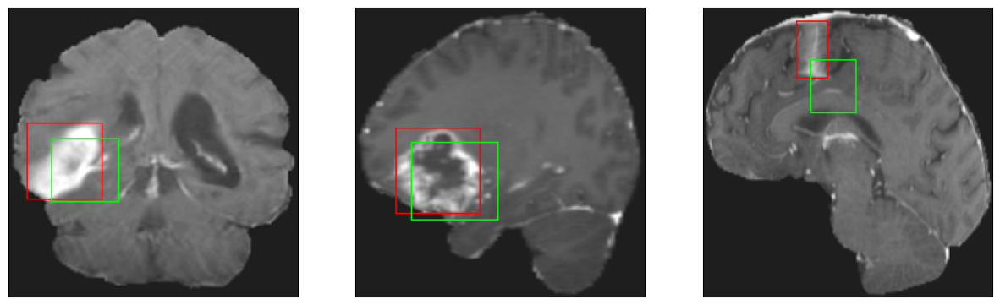

26/26 [==============================] - 4s 135ms/step - loss: 4.7367 - IoU: 0.6288 - val_loss: 9.1815 - val_IoU: 0.4266
Epoch 119/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8706 - IoU: 0.6349
Epoch 119: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


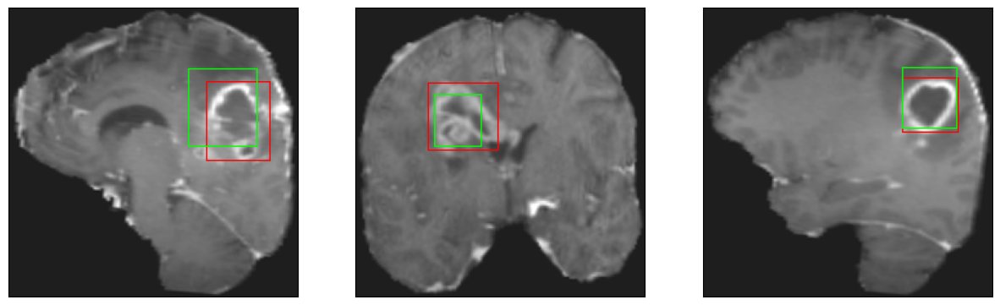

26/26 [==============================] - 3s 115ms/step - loss: 4.8583 - IoU: 0.6340 - val_loss: 7.9226 - val_IoU: 0.5315
Epoch 120/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6787 - IoU: 0.6399
Epoch 120: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


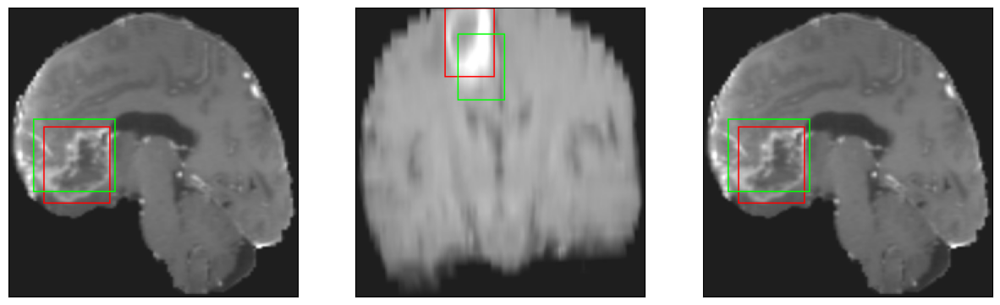

26/26 [==============================] - 3s 122ms/step - loss: 4.6822 - IoU: 0.6388 - val_loss: 8.0752 - val_IoU: 0.5258
Epoch 121/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5560 - IoU: 0.6380
Epoch 121: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


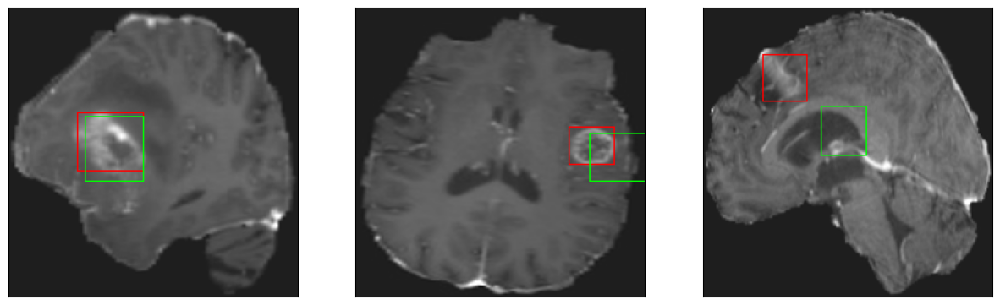

26/26 [==============================] - 3s 115ms/step - loss: 4.5402 - IoU: 0.6390 - val_loss: 10.7193 - val_IoU: 0.3703
Epoch 122/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4911 - IoU: 0.6436
Epoch 122: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


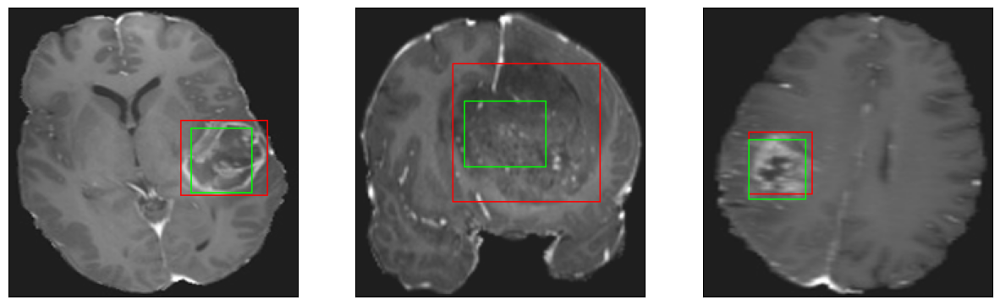

26/26 [==============================] - 4s 138ms/step - loss: 4.4836 - IoU: 0.6433 - val_loss: 9.1335 - val_IoU: 0.4747
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 4.4435 - IoU: 0.6473
Epoch 123: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


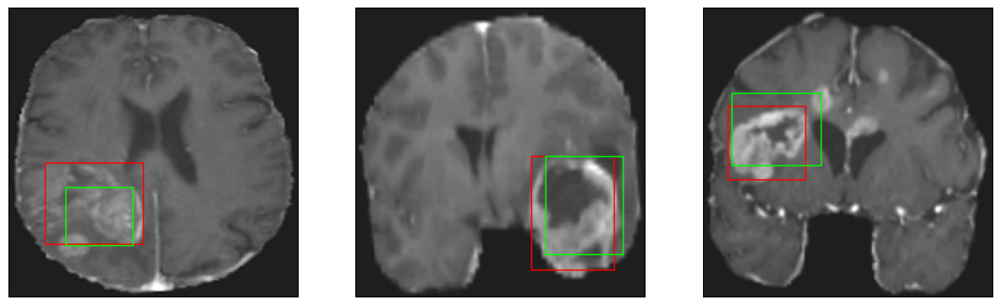

26/26 [==============================] - 3s 113ms/step - loss: 4.4435 - IoU: 0.6473 - val_loss: 7.8307 - val_IoU: 0.5542
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 4.6621 - IoU: 0.6296
Epoch 124: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


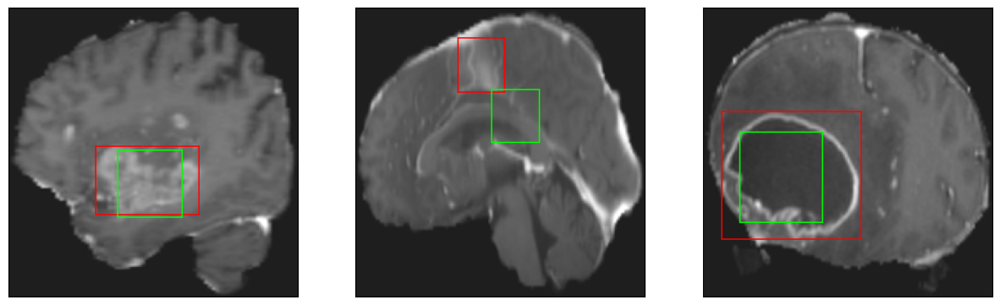

26/26 [==============================] - 3s 124ms/step - loss: 4.6621 - IoU: 0.6296 - val_loss: 8.3911 - val_IoU: 0.5016
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 4.4078 - IoU: 0.6515
Epoch 125: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


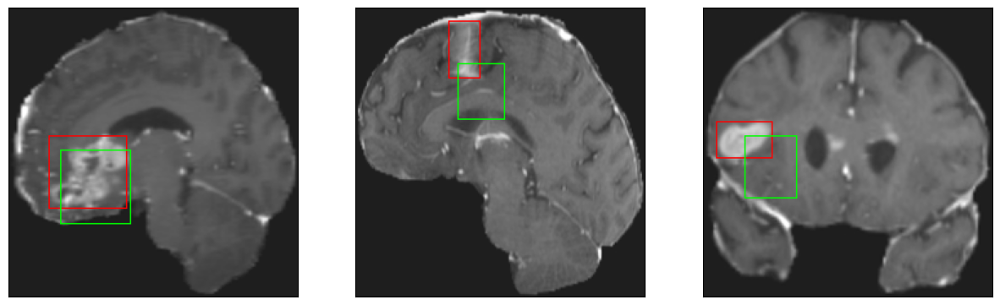

26/26 [==============================] - 3s 118ms/step - loss: 4.4078 - IoU: 0.6515 - val_loss: 9.9599 - val_IoU: 0.3922
Epoch 126/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4962 - IoU: 0.6472
Epoch 126: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


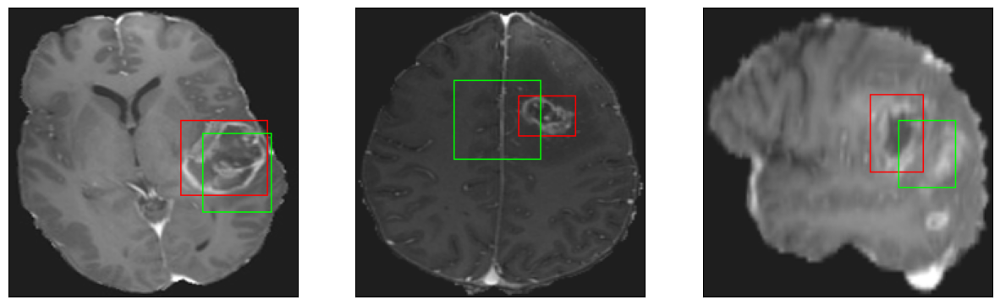

26/26 [==============================] - 3s 127ms/step - loss: 4.4587 - IoU: 0.6508 - val_loss: 8.1969 - val_IoU: 0.5414
Epoch 127/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5220 - IoU: 0.6459
Epoch 127: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


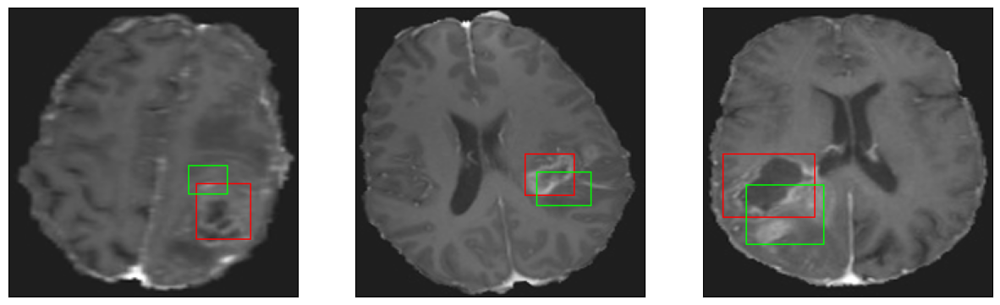

26/26 [==============================] - 3s 120ms/step - loss: 4.5923 - IoU: 0.6430 - val_loss: 9.6105 - val_IoU: 0.4423
Epoch 128/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5849 - IoU: 0.6466
Epoch 128: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


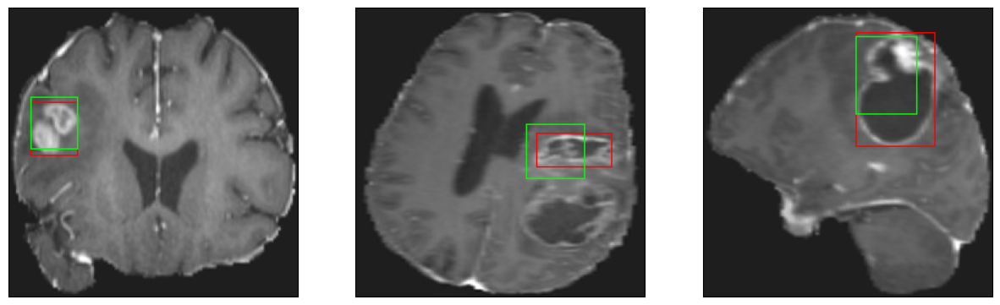

26/26 [==============================] - 3s 109ms/step - loss: 4.5456 - IoU: 0.6481 - val_loss: 9.1517 - val_IoU: 0.4434
Epoch 129/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5556 - IoU: 0.6268
Epoch 129: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


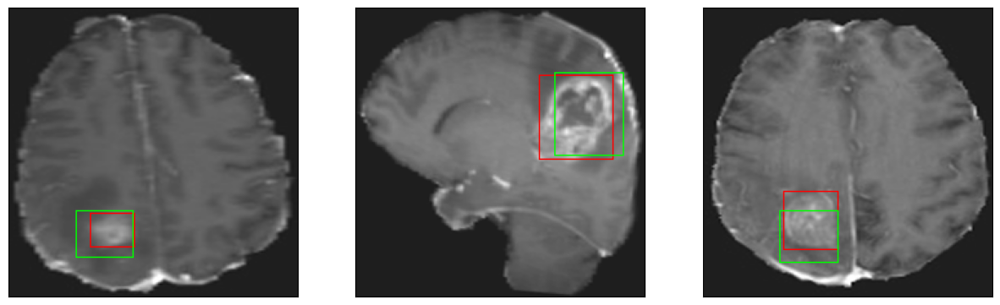

26/26 [==============================] - 3s 116ms/step - loss: 4.5771 - IoU: 0.6275 - val_loss: 8.0420 - val_IoU: 0.5387
Epoch 130/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4702 - IoU: 0.6359
Epoch 130: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


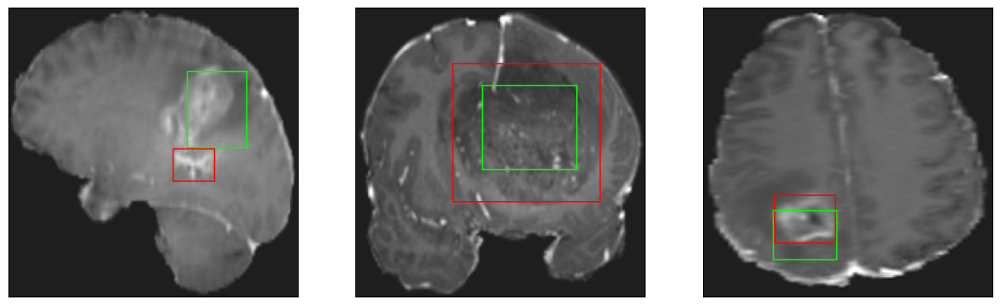

26/26 [==============================] - 4s 135ms/step - loss: 4.5602 - IoU: 0.6315 - val_loss: 8.4947 - val_IoU: 0.4965
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 4.6189 - IoU: 0.6317
Epoch 131: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


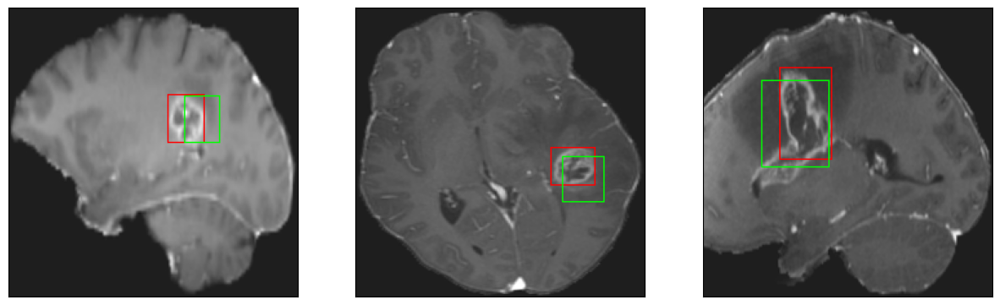

26/26 [==============================] - 3s 116ms/step - loss: 4.6189 - IoU: 0.6317 - val_loss: 8.9170 - val_IoU: 0.4661
Epoch 132/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5766 - IoU: 0.6320
Epoch 132: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


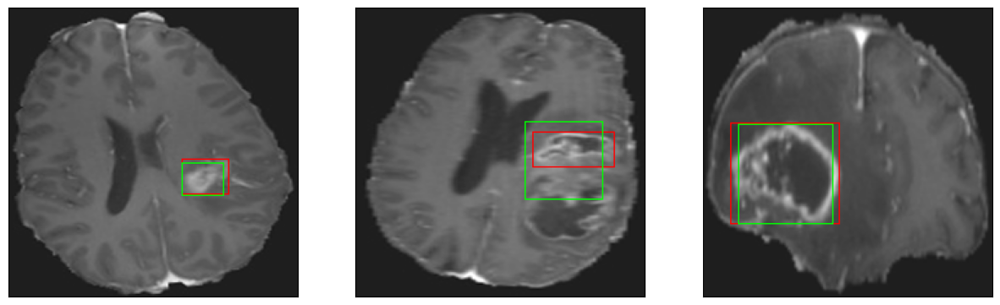

26/26 [==============================] - 3s 111ms/step - loss: 4.5699 - IoU: 0.6339 - val_loss: 7.7827 - val_IoU: 0.5515
Epoch 133/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6732 - IoU: 0.6280
Epoch 133: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


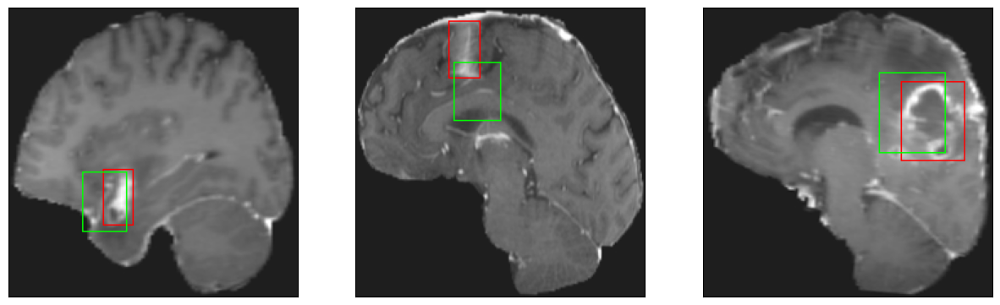

26/26 [==============================] - 3s 115ms/step - loss: 4.7230 - IoU: 0.6282 - val_loss: 8.1679 - val_IoU: 0.5220
Epoch 134/200
26/26 [==============================] - ETA: 0s - loss: 4.4654 - IoU: 0.6473
Epoch 134: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


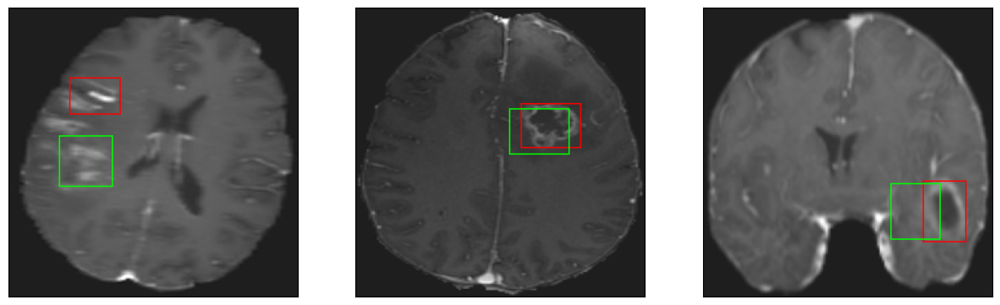

26/26 [==============================] - 4s 140ms/step - loss: 4.4654 - IoU: 0.6473 - val_loss: 8.5435 - val_IoU: 0.4948
Epoch 135/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4843 - IoU: 0.6357
Epoch 135: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


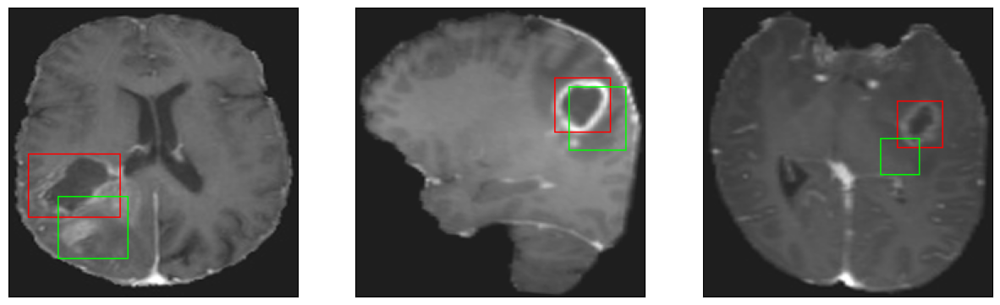

26/26 [==============================] - 3s 113ms/step - loss: 4.4346 - IoU: 0.6382 - val_loss: 9.0458 - val_IoU: 0.4726
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 4.3008 - IoU: 0.6477
Epoch 136: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


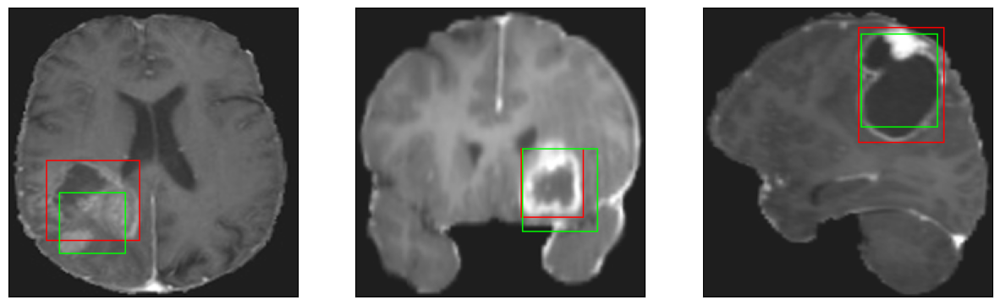

26/26 [==============================] - 3s 111ms/step - loss: 4.3008 - IoU: 0.6477 - val_loss: 7.6748 - val_IoU: 0.5629
Epoch 137/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9231 - IoU: 0.6351
Epoch 137: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


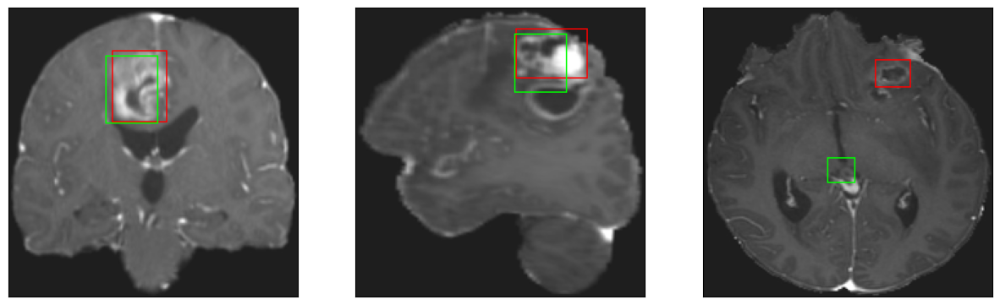

26/26 [==============================] - 3s 118ms/step - loss: 4.8928 - IoU: 0.6342 - val_loss: 9.2703 - val_IoU: 0.4488
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 4.5798 - IoU: 0.6370
Epoch 138: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


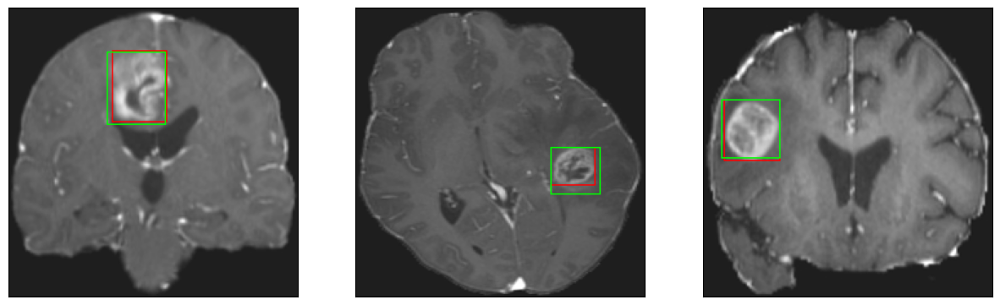

26/26 [==============================] - 4s 136ms/step - loss: 4.5798 - IoU: 0.6370 - val_loss: 7.9058 - val_IoU: 0.5339
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 4.5626 - IoU: 0.6438
Epoch 139: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4


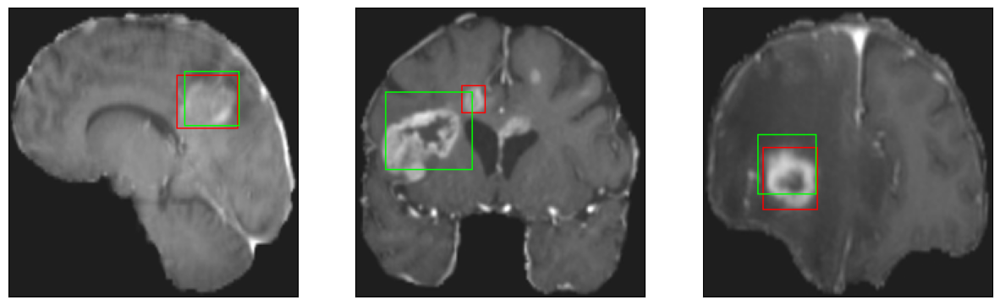

26/26 [==============================] - 4s 143ms/step - loss: 4.5626 - IoU: 0.6438 - val_loss: 8.3617 - val_IoU: 0.5099
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 4.2337 - IoU: 0.6577
Epoch 140: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


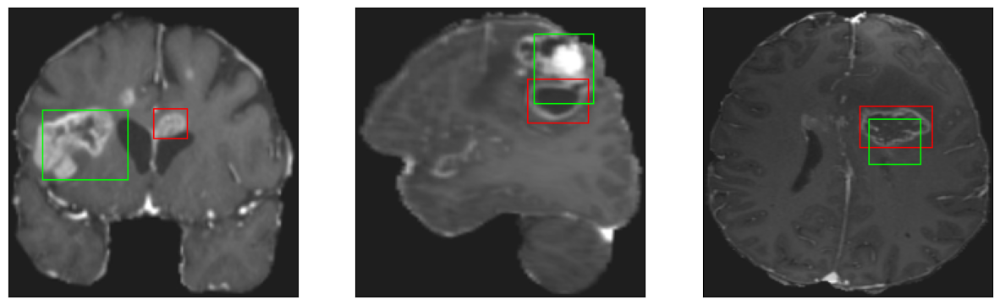

26/26 [==============================] - 3s 117ms/step - loss: 4.2337 - IoU: 0.6577 - val_loss: 10.5400 - val_IoU: 0.3717
Epoch 141/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2834 - IoU: 0.6533
Epoch 141: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


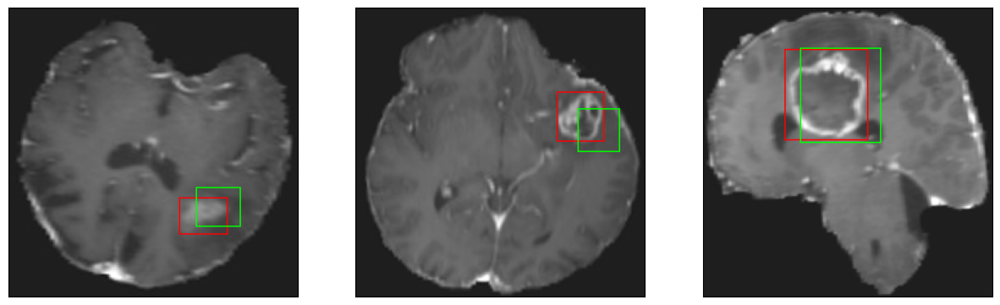

26/26 [==============================] - 3s 124ms/step - loss: 4.3001 - IoU: 0.6521 - val_loss: 11.1977 - val_IoU: 0.3292
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 4.6982 - IoU: 0.6356
Epoch 142: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


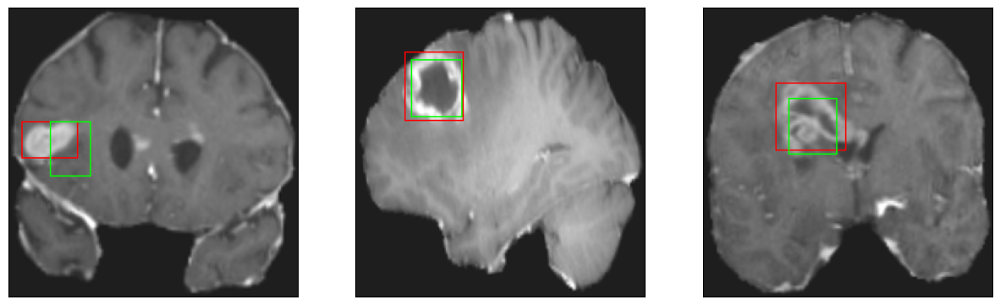

26/26 [==============================] - 4s 137ms/step - loss: 4.6982 - IoU: 0.6356 - val_loss: 8.2718 - val_IoU: 0.5059
Epoch 143/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5206 - IoU: 0.6416
Epoch 143: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


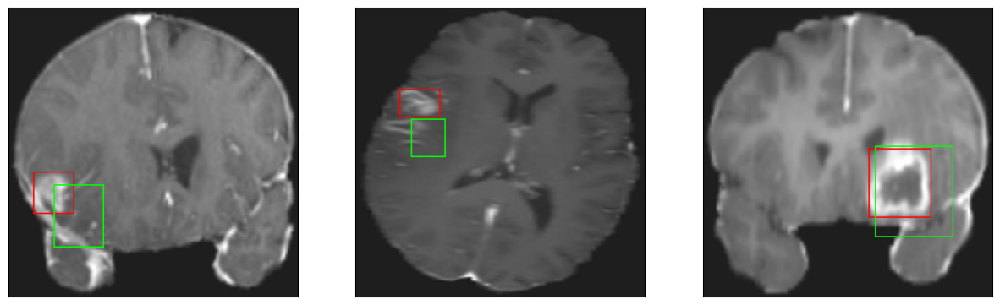

26/26 [==============================] - 3s 103ms/step - loss: 4.5074 - IoU: 0.6434 - val_loss: 7.9972 - val_IoU: 0.5228
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 4.2571 - IoU: 0.6574
Epoch 144: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


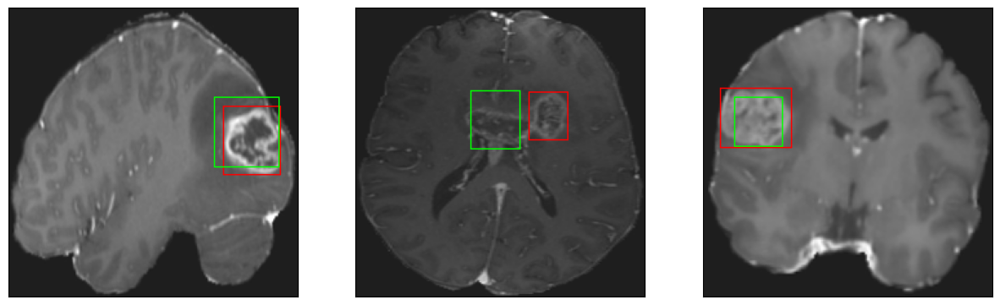

26/26 [==============================] - 3s 115ms/step - loss: 4.2571 - IoU: 0.6574 - val_loss: 8.3823 - val_IoU: 0.5062
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 4.5483 - IoU: 0.6409
Epoch 145: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 10ms/step
4


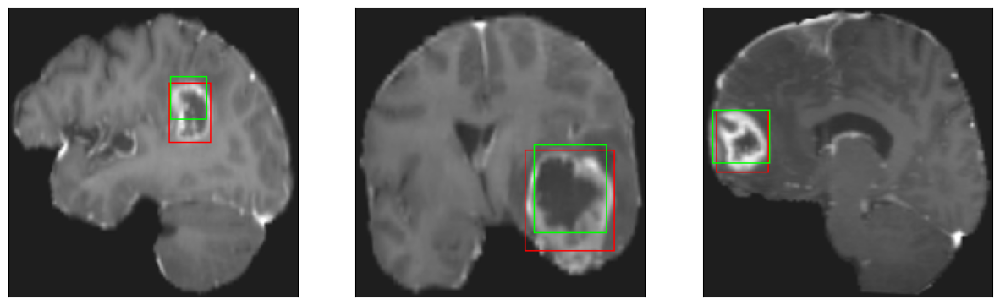

26/26 [==============================] - 3s 129ms/step - loss: 4.5483 - IoU: 0.6409 - val_loss: 8.4415 - val_IoU: 0.4982
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 4.4817 - IoU: 0.6452
Epoch 146: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


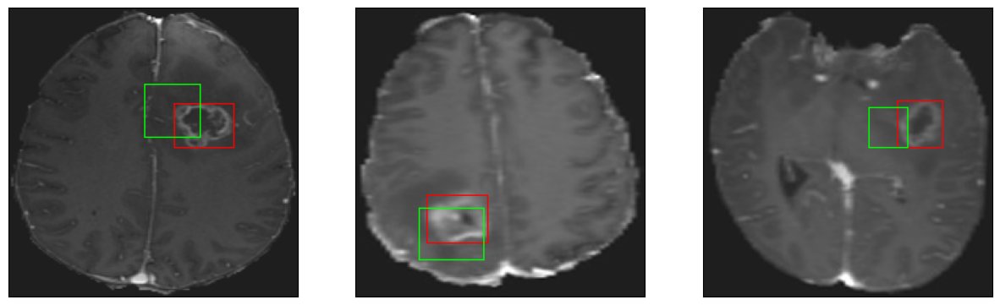

26/26 [==============================] - 3s 128ms/step - loss: 4.4817 - IoU: 0.6452 - val_loss: 7.7826 - val_IoU: 0.5359
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 4.4559 - IoU: 0.6406
Epoch 147: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


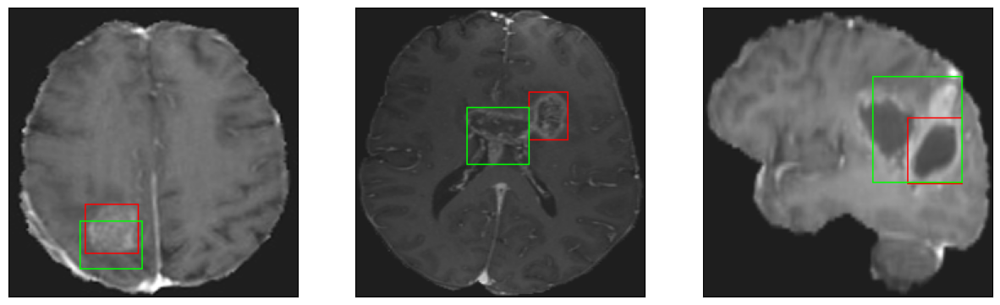

26/26 [==============================] - 3s 111ms/step - loss: 4.4559 - IoU: 0.6406 - val_loss: 7.7860 - val_IoU: 0.5424
Epoch 148/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4113 - IoU: 0.6505
Epoch 148: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


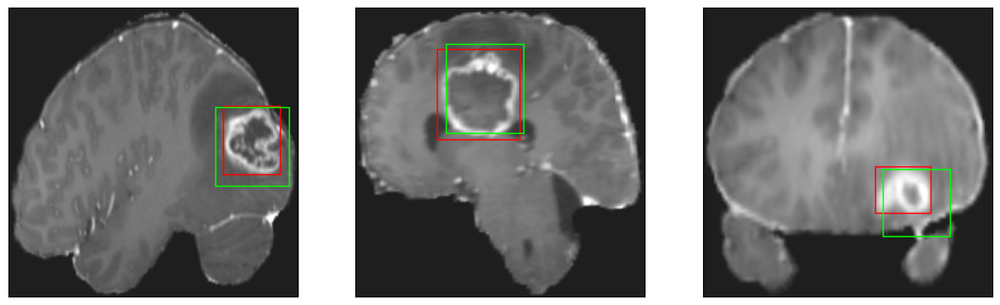

26/26 [==============================] - 3s 105ms/step - loss: 4.3854 - IoU: 0.6514 - val_loss: 8.2484 - val_IoU: 0.5067
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 4.4062 - IoU: 0.6443
Epoch 149: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


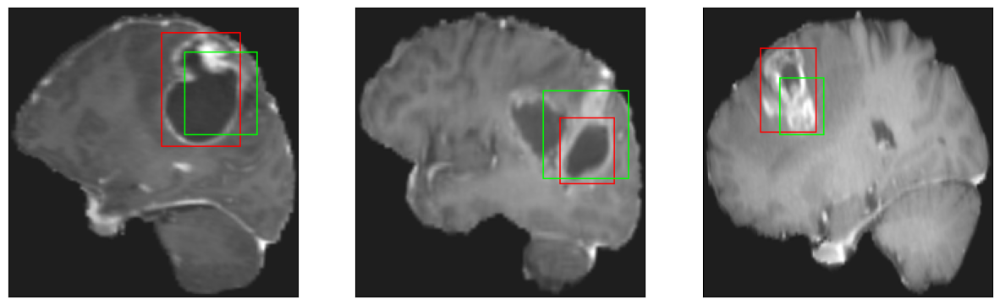

26/26 [==============================] - 4s 139ms/step - loss: 4.4062 - IoU: 0.6443 - val_loss: 11.6643 - val_IoU: 0.3364
Epoch 150/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4166 - IoU: 0.6399
Epoch 150: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


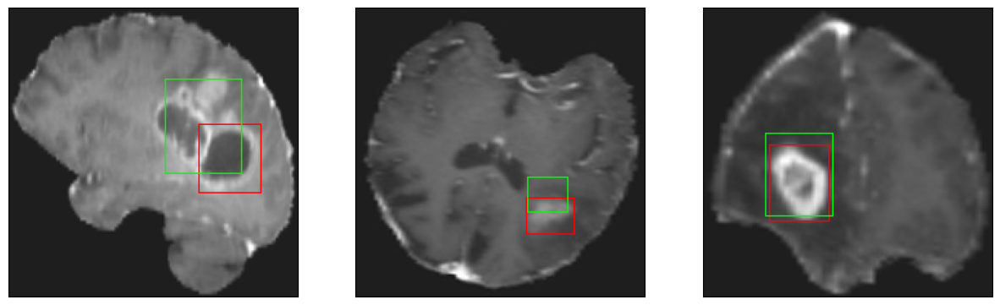

26/26 [==============================] - 3s 112ms/step - loss: 4.4827 - IoU: 0.6400 - val_loss: 7.6052 - val_IoU: 0.5645
Epoch 151/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3955 - IoU: 0.6523
Epoch 151: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


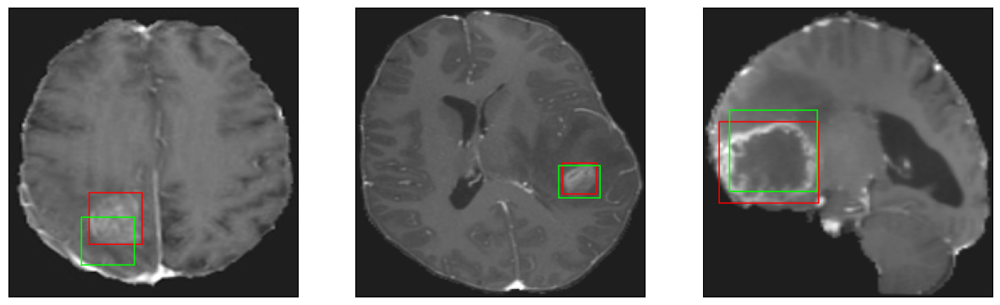

26/26 [==============================] - 3s 109ms/step - loss: 4.4084 - IoU: 0.6520 - val_loss: 7.8199 - val_IoU: 0.5556
Epoch 152/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4867 - IoU: 0.6408
Epoch 152: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


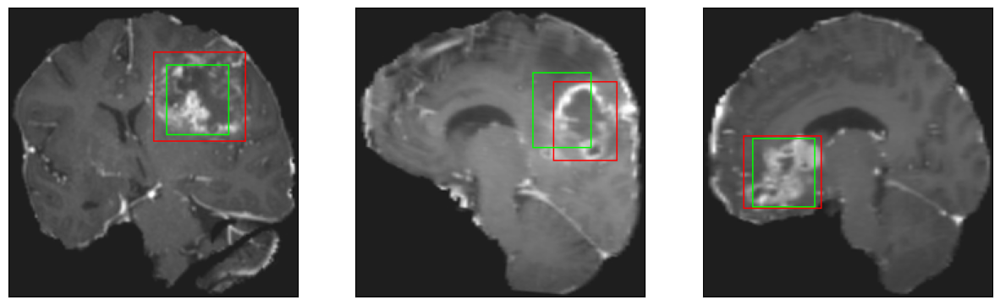

26/26 [==============================] - 3s 110ms/step - loss: 4.5012 - IoU: 0.6396 - val_loss: 7.8407 - val_IoU: 0.5626
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 4.3433 - IoU: 0.6528
Epoch 153: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


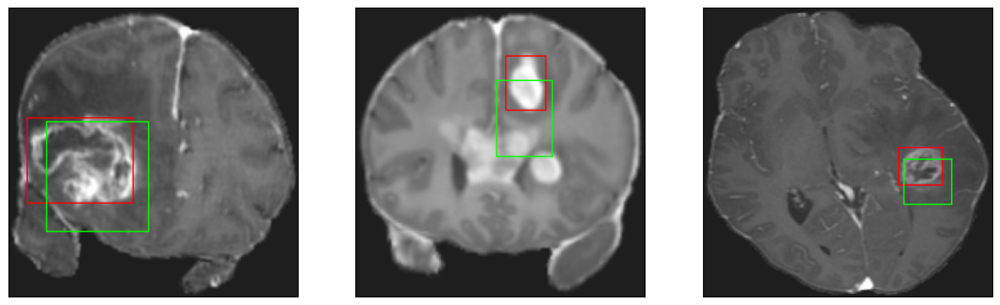

26/26 [==============================] - 4s 138ms/step - loss: 4.3433 - IoU: 0.6528 - val_loss: 8.9998 - val_IoU: 0.4925
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 4.3760 - IoU: 0.6445
Epoch 154: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


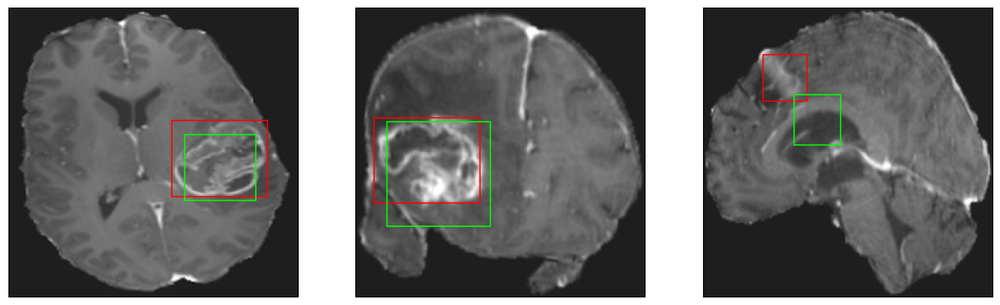

26/26 [==============================] - 3s 122ms/step - loss: 4.3760 - IoU: 0.6445 - val_loss: 7.5548 - val_IoU: 0.5526
Epoch 155/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3597 - IoU: 0.6497
Epoch 155: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


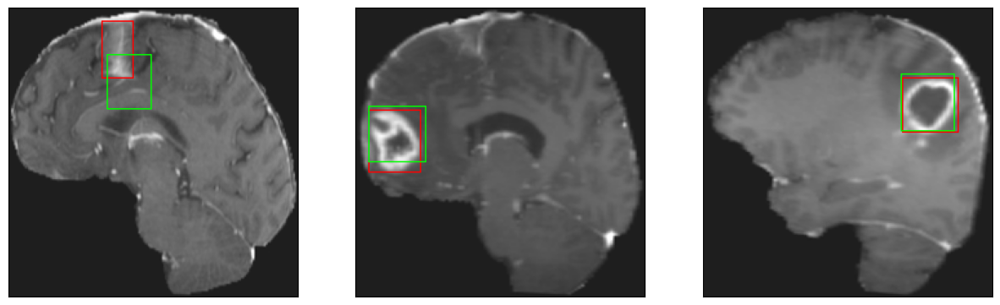

26/26 [==============================] - 3s 102ms/step - loss: 4.3899 - IoU: 0.6469 - val_loss: 7.8008 - val_IoU: 0.5472
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 4.3711 - IoU: 0.6482
Epoch 156: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


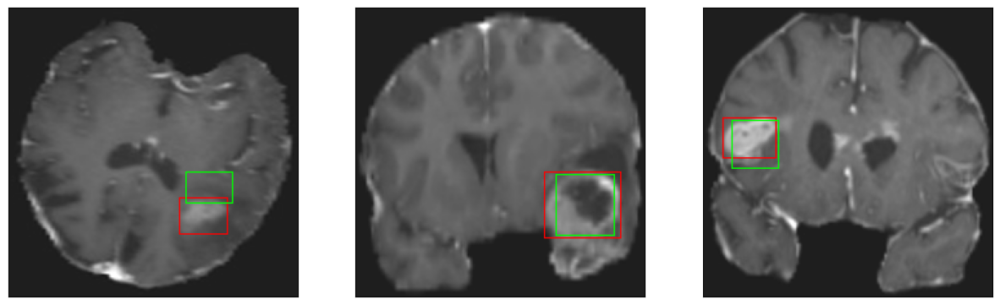

26/26 [==============================] - 3s 106ms/step - loss: 4.3711 - IoU: 0.6482 - val_loss: 8.5794 - val_IoU: 0.5028
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 4.4178 - IoU: 0.6438
Epoch 157: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


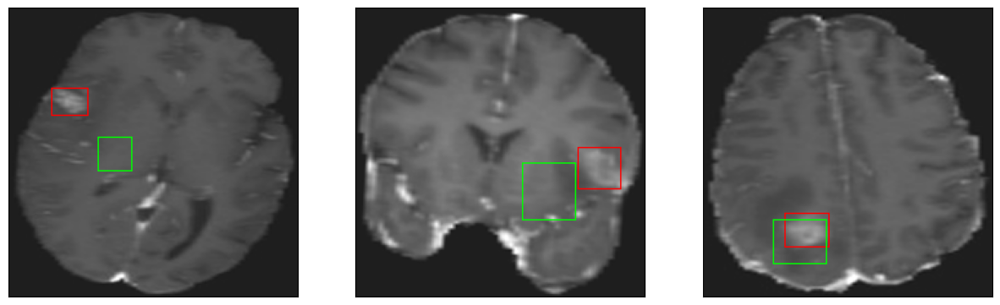

26/26 [==============================] - 4s 142ms/step - loss: 4.4178 - IoU: 0.6438 - val_loss: 8.6229 - val_IoU: 0.4937
Epoch 158/200
26/26 [==============================] - ETA: 0s - loss: 4.2271 - IoU: 0.6589
Epoch 158: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


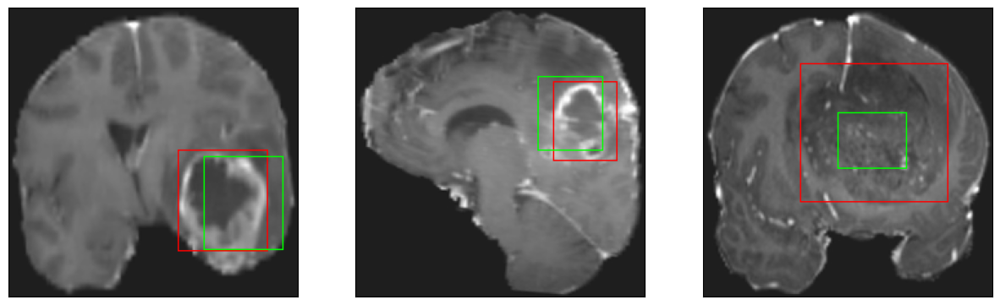

26/26 [==============================] - 3s 109ms/step - loss: 4.2271 - IoU: 0.6589 - val_loss: 8.2386 - val_IoU: 0.5057
Epoch 159/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2603 - IoU: 0.6521
Epoch 159: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


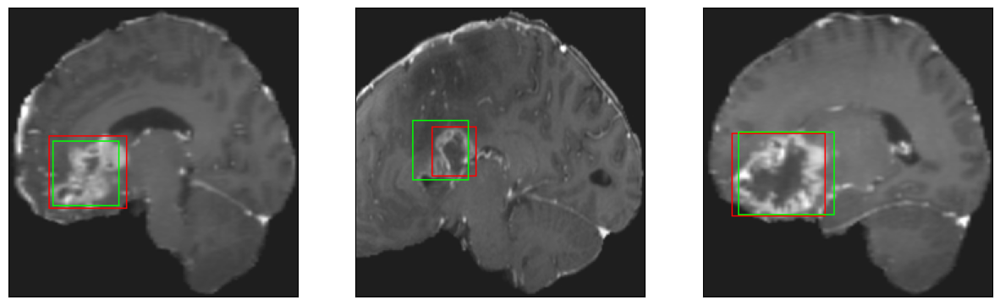

26/26 [==============================] - 3s 104ms/step - loss: 4.2425 - IoU: 0.6540 - val_loss: 7.9071 - val_IoU: 0.5382
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 4.1278 - IoU: 0.6644
Epoch 160: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


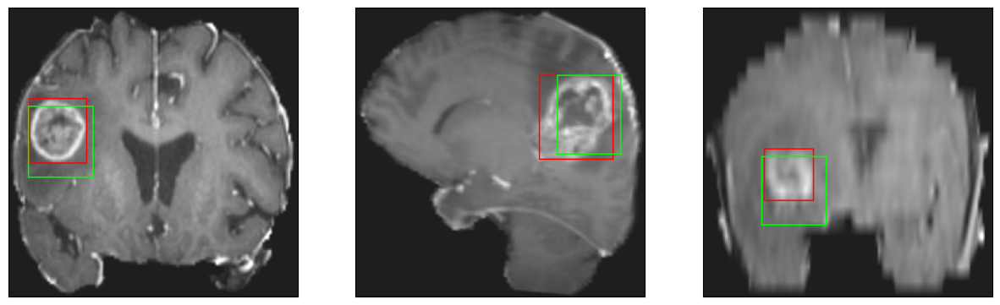

26/26 [==============================] - 4s 136ms/step - loss: 4.1278 - IoU: 0.6644 - val_loss: 8.6748 - val_IoU: 0.5055
Epoch 161/200
26/26 [==============================] - ETA: 0s - loss: 4.3400 - IoU: 0.6561
Epoch 161: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


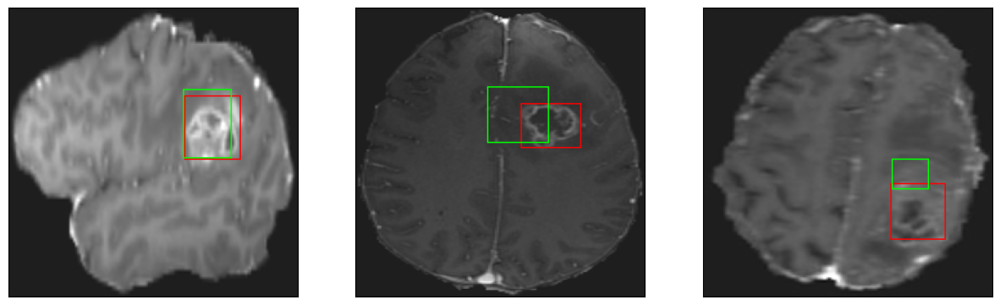

26/26 [==============================] - 4s 156ms/step - loss: 4.3400 - IoU: 0.6561 - val_loss: 7.5159 - val_IoU: 0.5616
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 4.3226 - IoU: 0.6584
Epoch 162: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


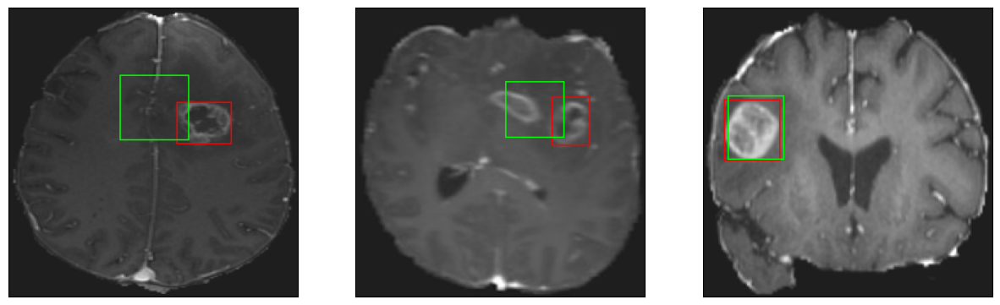

26/26 [==============================] - 3s 119ms/step - loss: 4.3226 - IoU: 0.6584 - val_loss: 7.8737 - val_IoU: 0.5403
Epoch 163/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2583 - IoU: 0.6571
Epoch 163: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


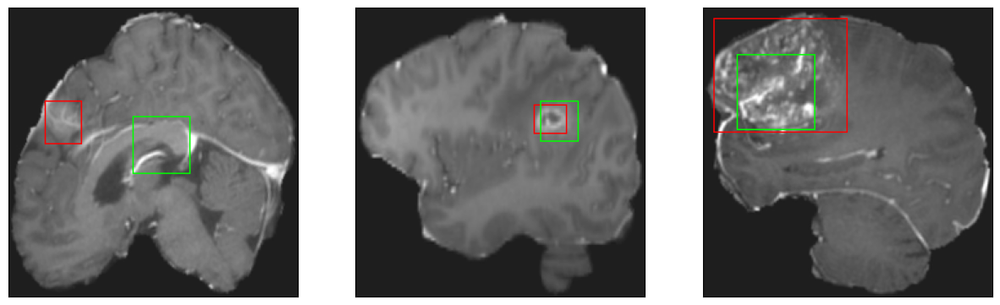

26/26 [==============================] - 3s 112ms/step - loss: 4.2490 - IoU: 0.6566 - val_loss: 8.7137 - val_IoU: 0.4956
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 4.2475 - IoU: 0.6536
Epoch 164: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


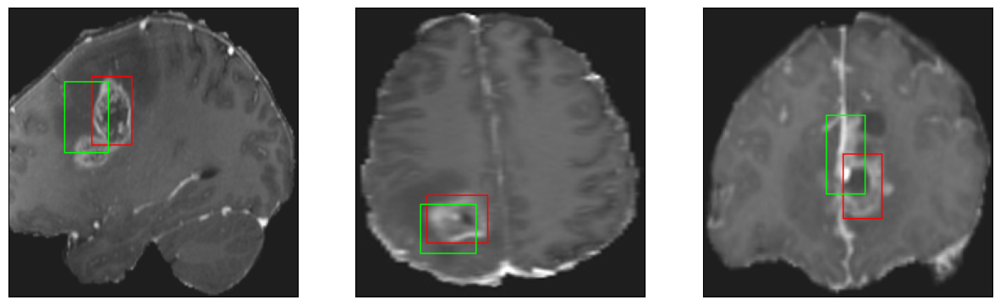

26/26 [==============================] - 4s 133ms/step - loss: 4.2475 - IoU: 0.6536 - val_loss: 8.5885 - val_IoU: 0.5161
Epoch 165/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4843 - IoU: 0.6423
Epoch 165: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


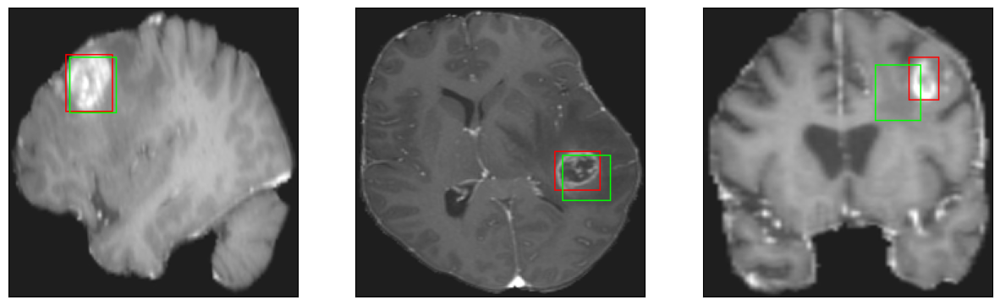

26/26 [==============================] - 3s 114ms/step - loss: 4.4400 - IoU: 0.6430 - val_loss: 8.0861 - val_IoU: 0.5212
Epoch 166/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3002 - IoU: 0.6533
Epoch 166: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


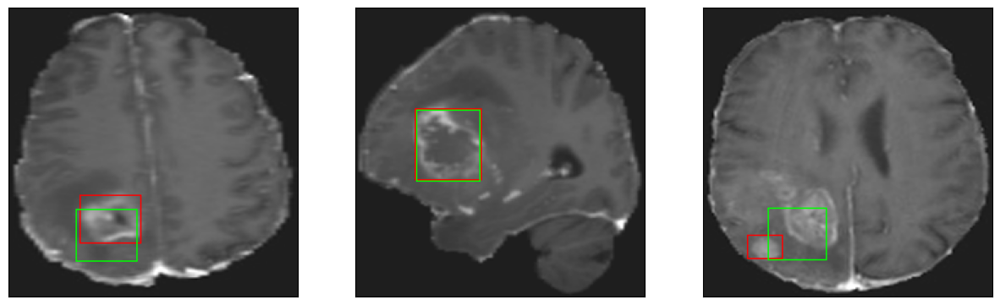

26/26 [==============================] - 3s 107ms/step - loss: 4.2869 - IoU: 0.6550 - val_loss: 8.3726 - val_IoU: 0.5091
Epoch 167/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3233 - IoU: 0.6540
Epoch 167: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


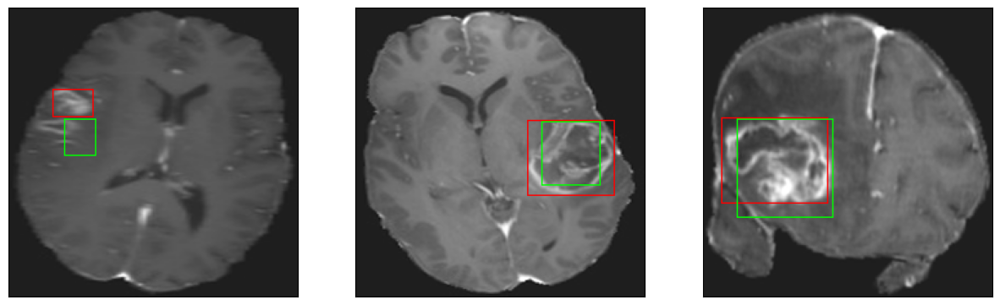

26/26 [==============================] - 3s 110ms/step - loss: 4.3415 - IoU: 0.6506 - val_loss: 8.3980 - val_IoU: 0.5083
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 4.2626 - IoU: 0.6551
Epoch 168: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4


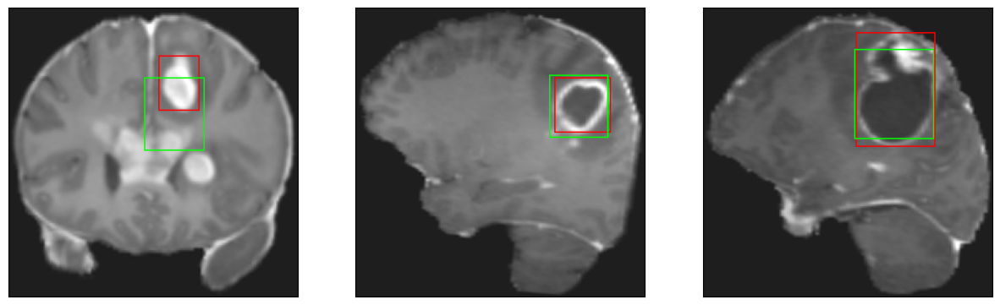

26/26 [==============================] - 3s 126ms/step - loss: 4.2626 - IoU: 0.6551 - val_loss: 7.9532 - val_IoU: 0.5436
Epoch 169/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5225 - IoU: 0.6379
Epoch 169: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


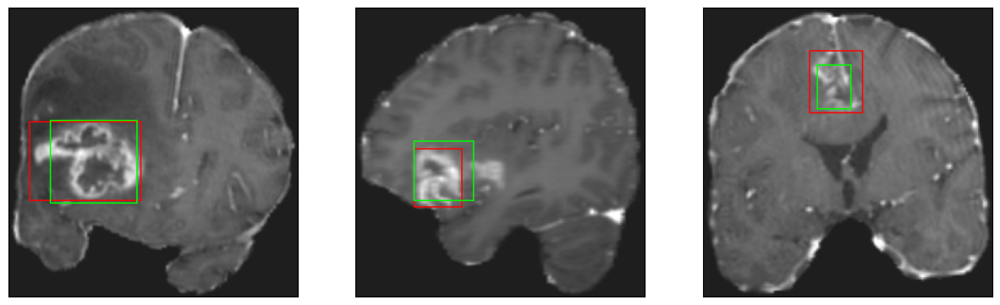

26/26 [==============================] - 3s 116ms/step - loss: 4.5852 - IoU: 0.6341 - val_loss: 8.1351 - val_IoU: 0.5307
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 4.2966 - IoU: 0.6569
Epoch 170: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


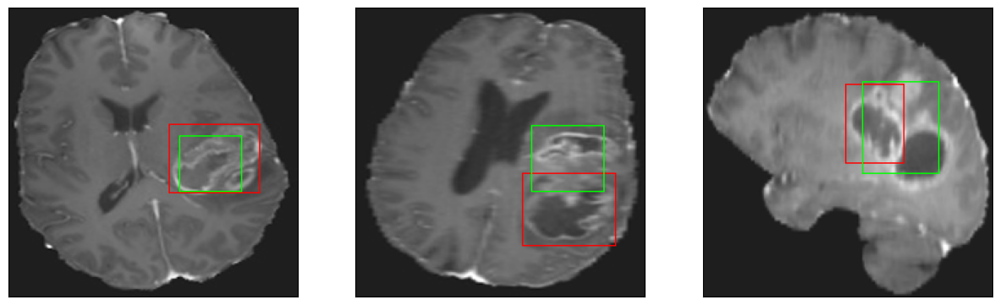

26/26 [==============================] - 3s 120ms/step - loss: 4.2966 - IoU: 0.6569 - val_loss: 7.6314 - val_IoU: 0.5711
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 4.3098 - IoU: 0.6539
Epoch 171: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


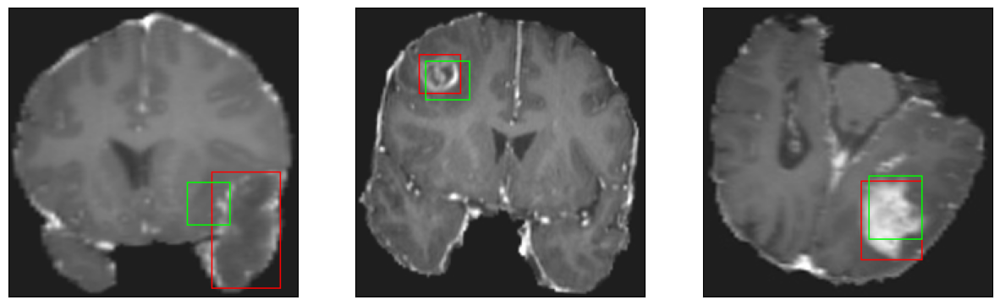

26/26 [==============================] - 4s 141ms/step - loss: 4.3098 - IoU: 0.6539 - val_loss: 8.1156 - val_IoU: 0.5241
Epoch 172/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2966 - IoU: 0.6532
Epoch 172: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


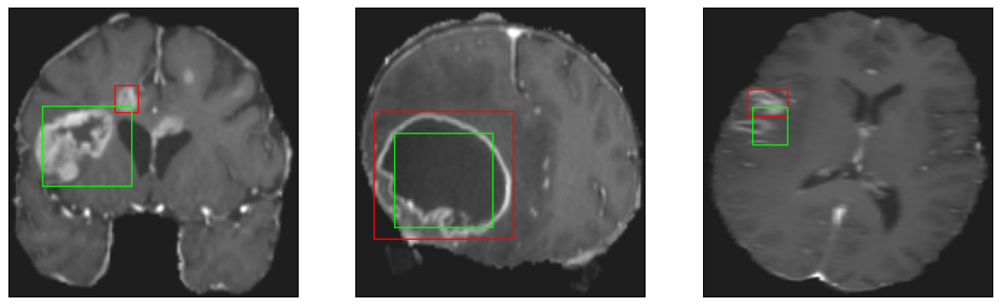

26/26 [==============================] - 3s 116ms/step - loss: 4.2696 - IoU: 0.6543 - val_loss: 8.7611 - val_IoU: 0.4695
Epoch 173/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2587 - IoU: 0.6536
Epoch 173: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


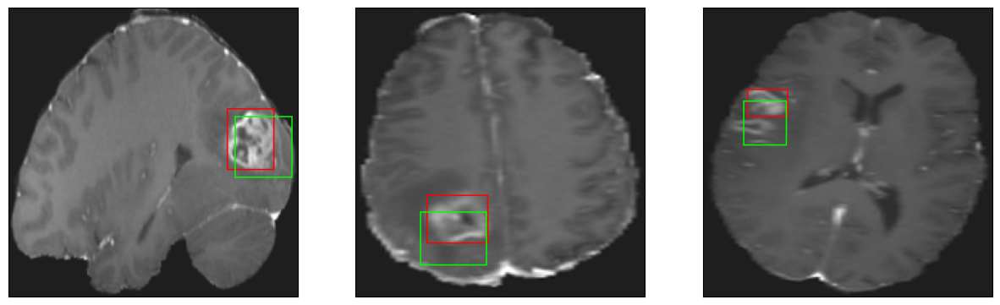

26/26 [==============================] - 3s 106ms/step - loss: 4.2592 - IoU: 0.6535 - val_loss: 8.5739 - val_IoU: 0.5161
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 4.1070 - IoU: 0.6695
Epoch 174: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


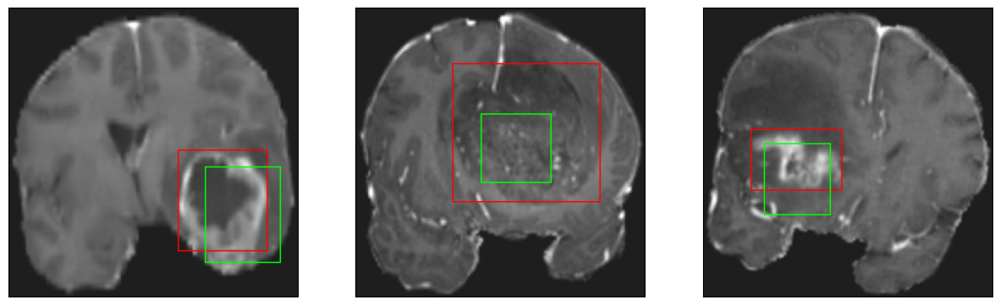

26/26 [==============================] - 3s 106ms/step - loss: 4.1070 - IoU: 0.6695 - val_loss: 10.6357 - val_IoU: 0.3670
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 4.3965 - IoU: 0.6438
Epoch 175: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


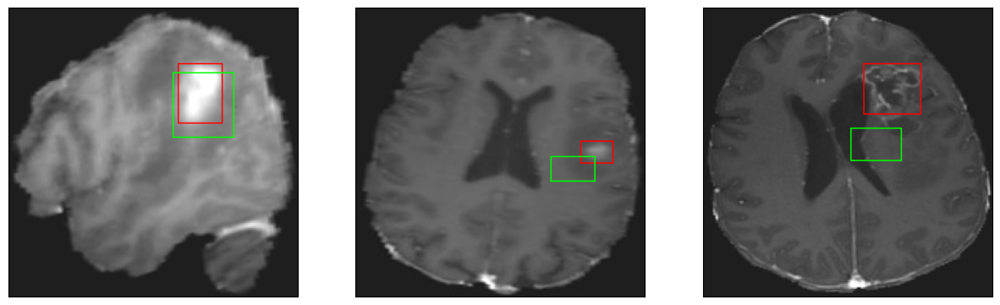

26/26 [==============================] - 3s 108ms/step - loss: 4.3965 - IoU: 0.6438 - val_loss: 10.8995 - val_IoU: 0.3450
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 4.2159 - IoU: 0.6551
Epoch 176: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


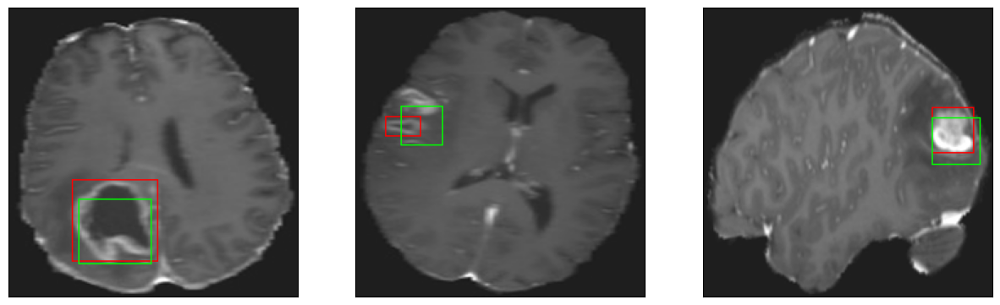

26/26 [==============================] - 3s 133ms/step - loss: 4.2159 - IoU: 0.6551 - val_loss: 8.1753 - val_IoU: 0.5216
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 4.2912 - IoU: 0.6570
Epoch 177: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


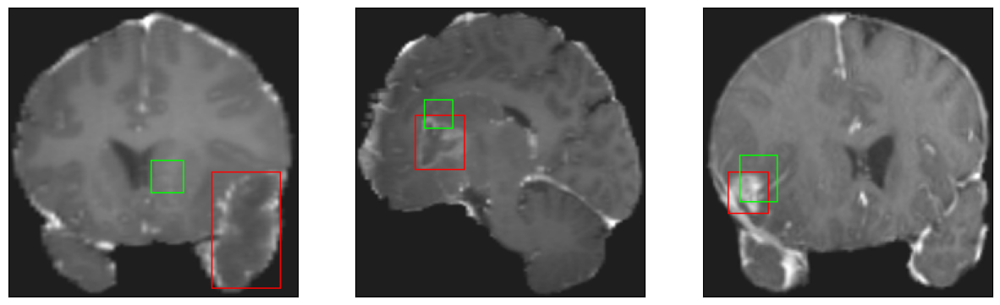

26/26 [==============================] - 3s 114ms/step - loss: 4.2912 - IoU: 0.6570 - val_loss: 13.1331 - val_IoU: 0.2776
Epoch 178/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4666 - IoU: 0.6422
Epoch 178: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


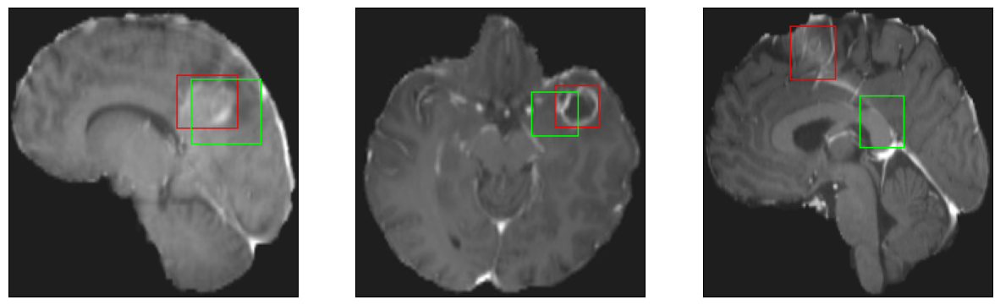

26/26 [==============================] - 3s 124ms/step - loss: 4.4287 - IoU: 0.6448 - val_loss: 9.6127 - val_IoU: 0.4665
Epoch 179/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2007 - IoU: 0.6572
Epoch 179: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


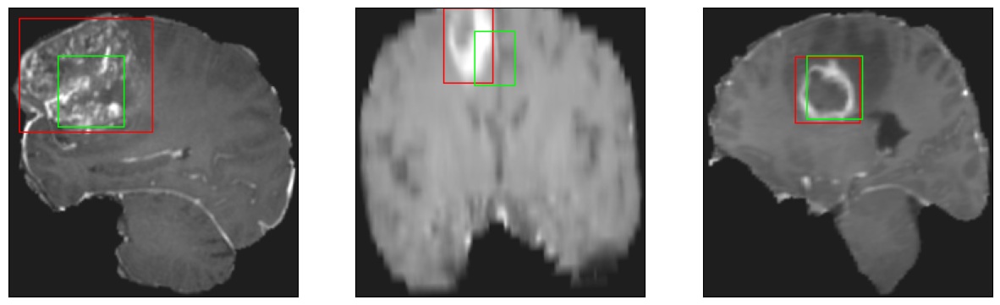

26/26 [==============================] - 3s 117ms/step - loss: 4.1738 - IoU: 0.6598 - val_loss: 9.1325 - val_IoU: 0.4486
Epoch 180/200
26/26 [==============================] - ETA: 0s - loss: 4.2506 - IoU: 0.6617
Epoch 180: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


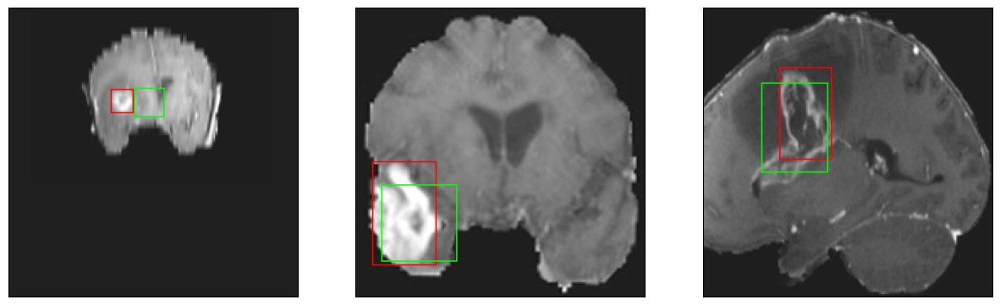

26/26 [==============================] - 3s 131ms/step - loss: 4.2506 - IoU: 0.6617 - val_loss: 10.4009 - val_IoU: 0.4192
Epoch 181/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1674 - IoU: 0.6661
Epoch 181: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


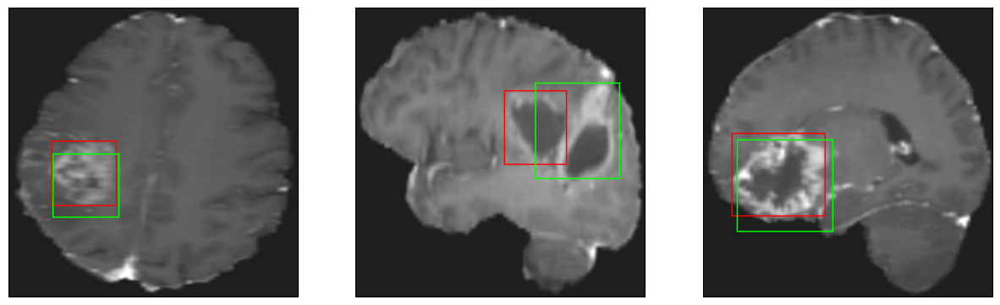

26/26 [==============================] - 3s 112ms/step - loss: 4.1477 - IoU: 0.6660 - val_loss: 8.9500 - val_IoU: 0.4752
Epoch 182/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2034 - IoU: 0.6636
Epoch 182: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


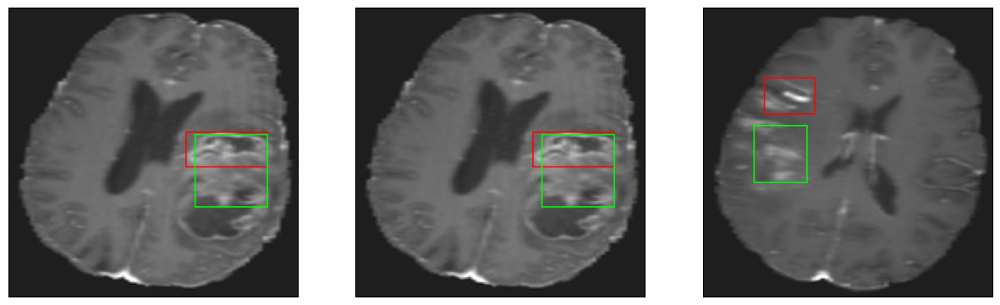

26/26 [==============================] - 3s 122ms/step - loss: 4.2555 - IoU: 0.6600 - val_loss: 8.0057 - val_IoU: 0.5442
Epoch 183/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1849 - IoU: 0.6655
Epoch 183: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


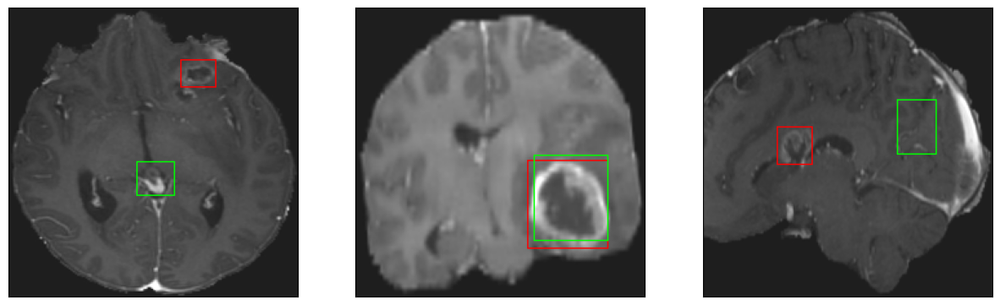

26/26 [==============================] - 3s 113ms/step - loss: 4.1462 - IoU: 0.6670 - val_loss: 7.5270 - val_IoU: 0.5659
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 4.2195 - IoU: 0.6624
Epoch 184: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


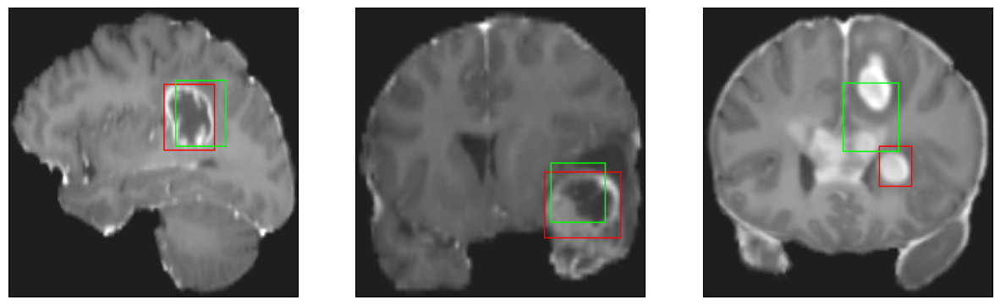

26/26 [==============================] - 4s 144ms/step - loss: 4.2195 - IoU: 0.6624 - val_loss: 8.1040 - val_IoU: 0.5424
Epoch 185/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3805 - IoU: 0.6488
Epoch 185: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


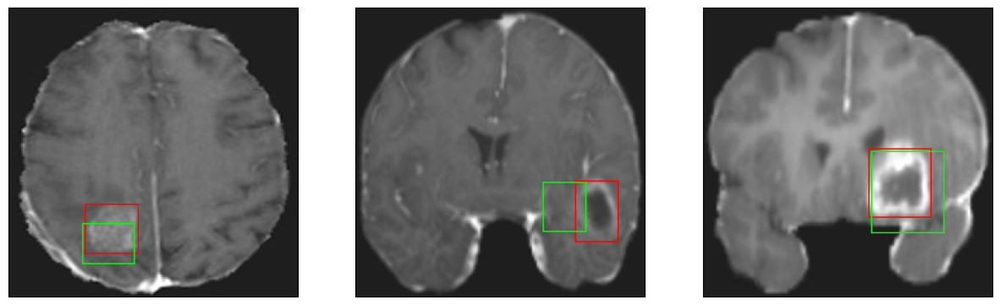

26/26 [==============================] - 3s 134ms/step - loss: 4.3750 - IoU: 0.6495 - val_loss: 7.5463 - val_IoU: 0.5543
Epoch 186/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1780 - IoU: 0.6662
Epoch 186: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


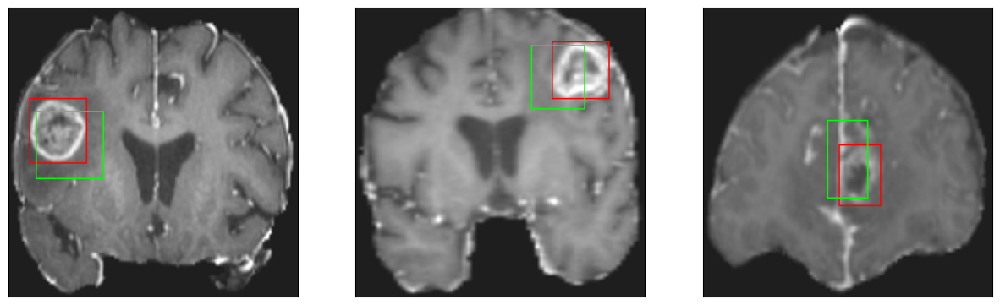

26/26 [==============================] - 3s 114ms/step - loss: 4.1779 - IoU: 0.6671 - val_loss: 7.9557 - val_IoU: 0.5272
Epoch 187/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1486 - IoU: 0.6631
Epoch 187: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


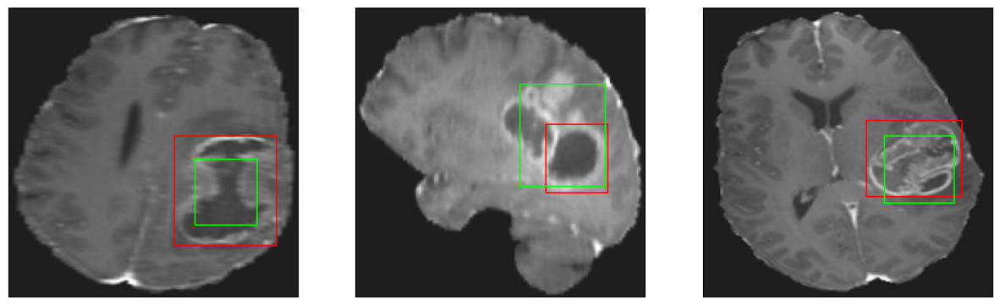

26/26 [==============================] - 3s 131ms/step - loss: 4.1911 - IoU: 0.6631 - val_loss: 7.8614 - val_IoU: 0.5382
Epoch 188/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2305 - IoU: 0.6604
Epoch 188: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


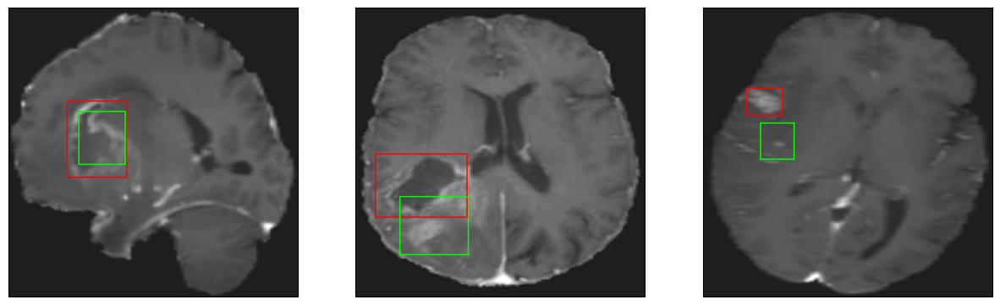

26/26 [==============================] - 3s 115ms/step - loss: 4.2307 - IoU: 0.6587 - val_loss: 7.9381 - val_IoU: 0.5178
Epoch 189/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1572 - IoU: 0.6662
Epoch 189: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


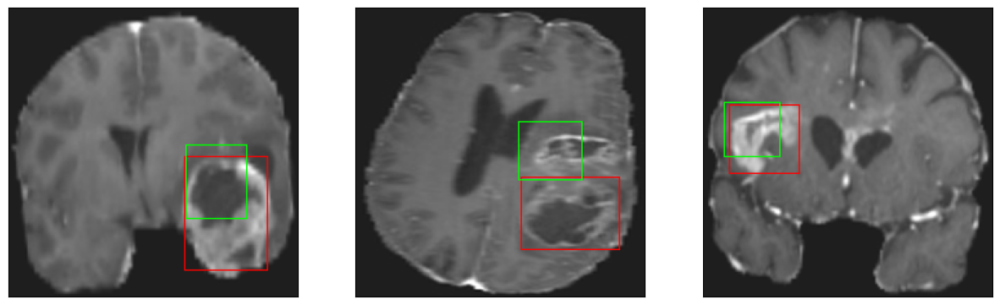

26/26 [==============================] - 3s 107ms/step - loss: 4.2103 - IoU: 0.6632 - val_loss: 9.8531 - val_IoU: 0.4304
Epoch 190/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1348 - IoU: 0.6636
Epoch 190: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4


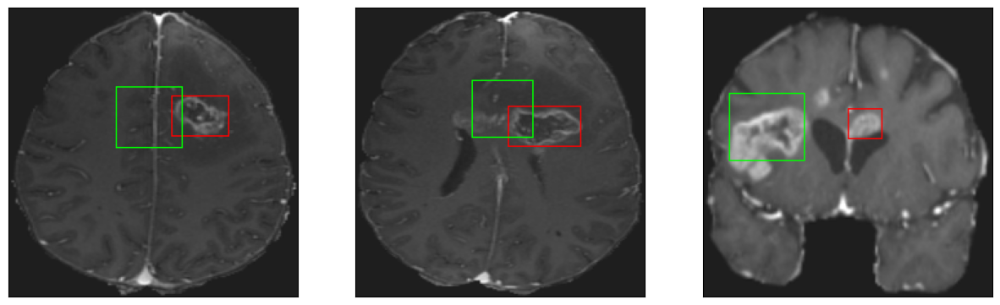

26/26 [==============================] - 3s 123ms/step - loss: 4.1130 - IoU: 0.6640 - val_loss: 8.5120 - val_IoU: 0.5067
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 4.0422 - IoU: 0.6659
Epoch 191: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


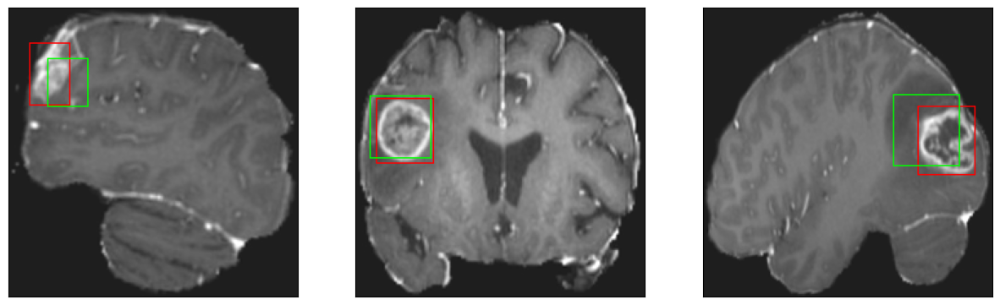

26/26 [==============================] - 4s 139ms/step - loss: 4.0422 - IoU: 0.6659 - val_loss: 8.8509 - val_IoU: 0.4585
Epoch 192/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2885 - IoU: 0.6561
Epoch 192: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


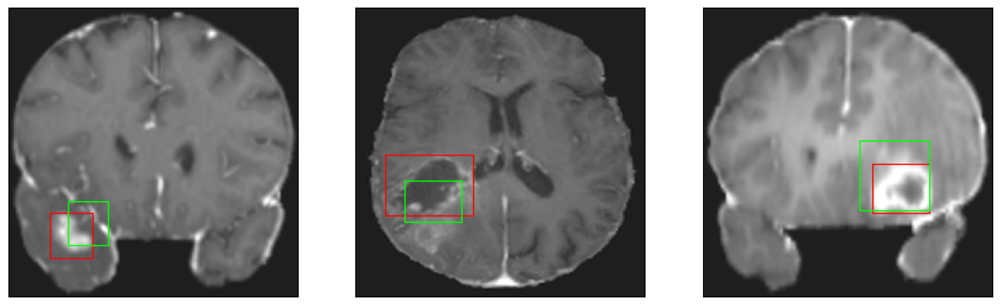

26/26 [==============================] - 3s 122ms/step - loss: 4.2398 - IoU: 0.6584 - val_loss: 9.1068 - val_IoU: 0.4651
Epoch 193/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3737 - IoU: 0.6466
Epoch 193: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


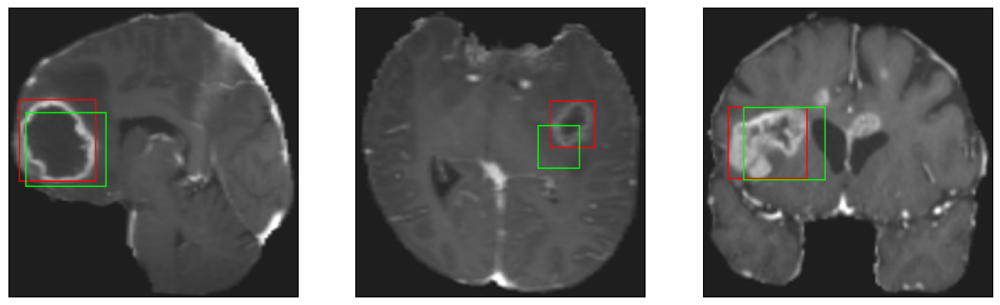

26/26 [==============================] - 3s 123ms/step - loss: 4.3614 - IoU: 0.6484 - val_loss: 10.5891 - val_IoU: 0.3542
Epoch 194/200
26/26 [==============================] - ETA: 0s - loss: 4.0963 - IoU: 0.6616
Epoch 194: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


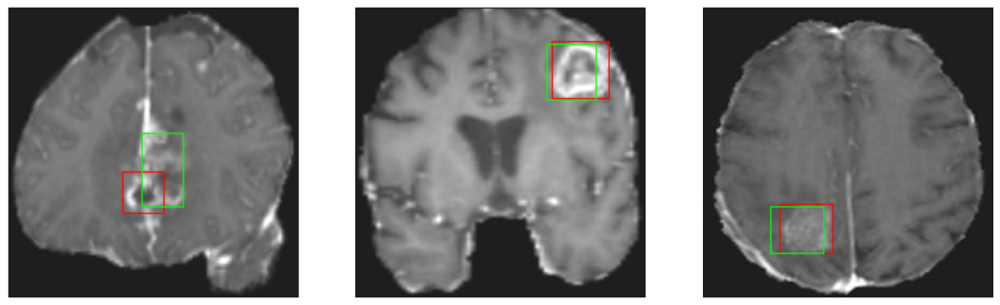

26/26 [==============================] - 3s 132ms/step - loss: 4.0963 - IoU: 0.6616 - val_loss: 7.8439 - val_IoU: 0.5404
Epoch 195/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0863 - IoU: 0.6644
Epoch 195: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


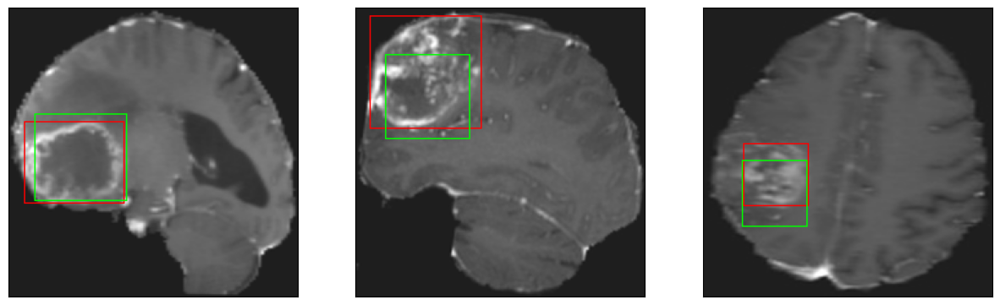

26/26 [==============================] - 4s 136ms/step - loss: 4.1222 - IoU: 0.6635 - val_loss: 8.2626 - val_IoU: 0.5080
Epoch 196/200
26/26 [==============================] - ETA: 0s - loss: 4.0330 - IoU: 0.6687
Epoch 196: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


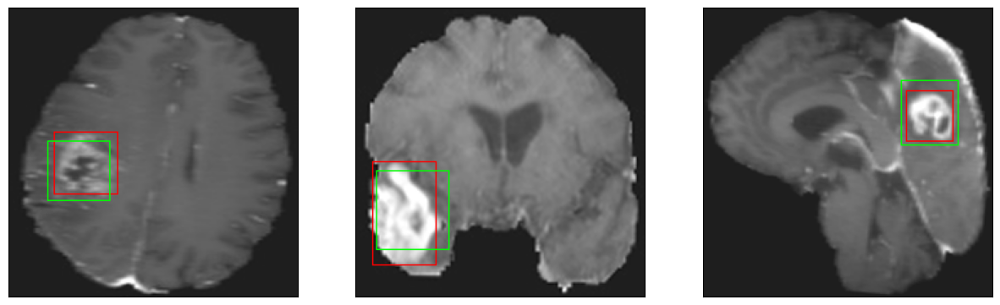

26/26 [==============================] - 3s 126ms/step - loss: 4.0330 - IoU: 0.6687 - val_loss: 8.2254 - val_IoU: 0.5431
Epoch 197/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2720 - IoU: 0.6569
Epoch 197: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


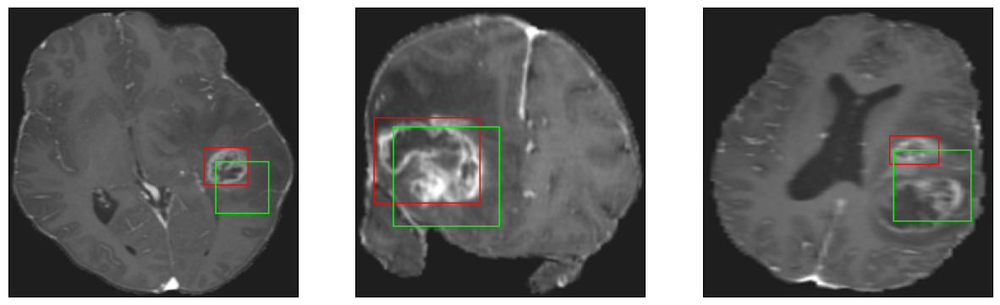

26/26 [==============================] - 3s 109ms/step - loss: 4.2756 - IoU: 0.6578 - val_loss: 9.5249 - val_IoU: 0.4547
Epoch 198/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0616 - IoU: 0.6628
Epoch 198: val_loss did not improve from 7.50219
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


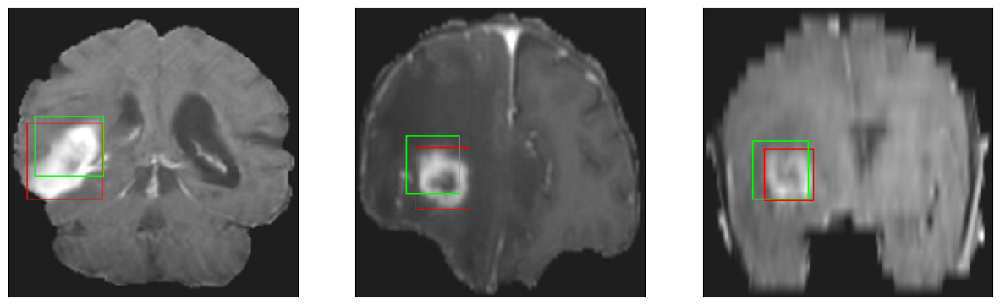

26/26 [==============================] - 3s 115ms/step - loss: 4.0929 - IoU: 0.6629 - val_loss: 9.6914 - val_IoU: 0.4239
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 4.2048 - IoU: 0.6590
Epoch 199: val_loss improved from 7.50219 to 7.43502, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


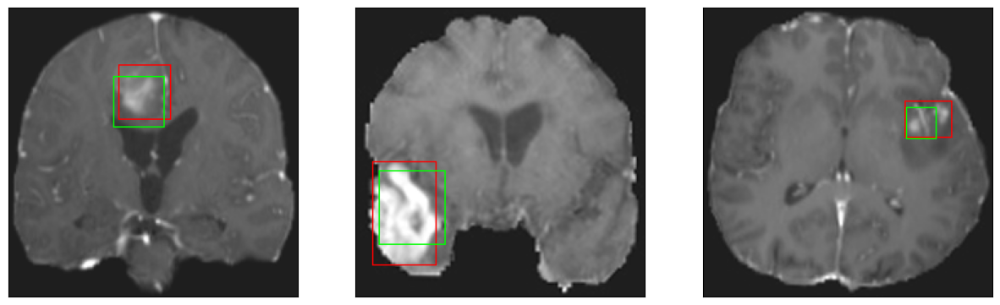

26/26 [==============================] - 4s 169ms/step - loss: 4.2048 - IoU: 0.6590 - val_loss: 7.4350 - val_IoU: 0.5711
Epoch 200/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1967 - IoU: 0.6553
Epoch 200: val_loss did not improve from 7.43502
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


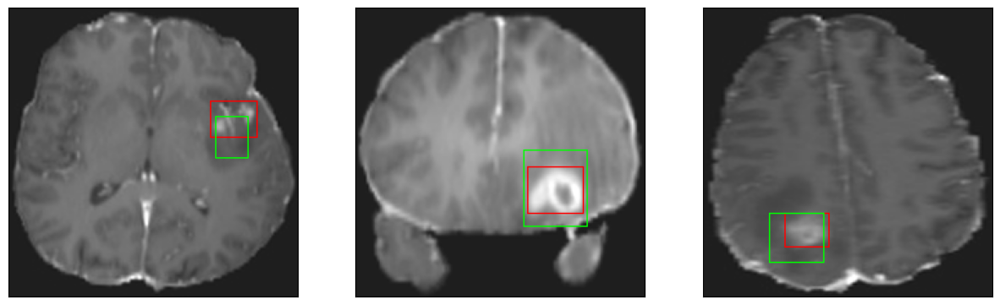

26/26 [==============================] - 3s 118ms/step - loss: 4.2555 - IoU: 0.6540 - val_loss: 7.8867 - val_IoU: 0.5404


In [24]:
model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

In [25]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [26]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [27]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 35ms/step - loss: 10.0741 - IoU: 0.4547


[10.074136734008789, 0.4546792209148407]